In [148]:
import pandas as pd
import seaborn as sn
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import gaussian_kde
import scipy.stats as stats
from Bio.Seq import Seq
from Bio.SeqUtils import MeltingTemp as mt
import statsmodels.api as sm
from statsmodels.formula.api import ols
from bioinfokit.analys import stat
import scikit_posthocs as sp
from Bio.SeqUtils import GC
import numpy as np
from collections import Counter, OrderedDict

Graph settings:

In [149]:
lsize=13
titlesize=14
axesthickness = 1.5
flierprops = dict(marker='o',markersize=1.5)
boxplot_kwargs = {'widths':0.65, 'vert':True, 'patch_artist':True, 'boxprops':dict(facecolor='#FEFBF3'), 'whis':[5, 95]}
bar_kwargs = {'color':'#C5DEFF', 'edgecolor':'#000000', 'capsize':4, 'linewidth':1.5}
plt.rcParams['axes.linewidth'] = axesthickness
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42
mpl.rcParams['font.family'] = 'Arial'

Import all replicates, controls and template dataframe:

In [3]:
# quantification window 2bp upstream nick and 5bp downstream RTT end
path='C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\pridict\\01_Library_Sequence_Analysis\\03_Read_Analysis\\'
PE1df = pd.read_csv(path+'20220712_01-NM-PE1_analysisdf_focused.csv')
PE2df = pd.read_csv(path+'20220712_02-NM-PE2_analysisdf_focused.csv')
PE3df = pd.read_csv(path+'20220712_03-NM-PE3_analysisdf_focused.csv')
CTRdf = pd.read_csv(path+'20220712_04-NM-CtrCombined_analysisdf_focused.csv')
CTRrep1df = pd.read_csv(path+'20220712_04-NM-C1_analysisdf_focused.csv')
CTRrep2df = pd.read_csv(path+'20220712_05-NM-C2_analysisdf_focused.csv')

templatedf = pd.read_csv(path+'20210701_templatefiltered.csv')

templatedf = templatedf[:-45]

In [8]:
startposition = 10 
protolength = 19

protospacerlocation = [startposition,startposition+protolength] #position within wide_target_sequnence; where it starts and where it ends

for index,row in templatedf.iterrows():
    startallele = row.AlternateAllele
    mutatedallele = row.ReferenceAllele
    mutatedseqreal = str(Seq(row.mutated_amplicon_real))
    if row.Target_Strand == "'Rv'":
        startallele = str(Seq(startallele).reverse_complement())
        mutatedallele = str(Seq(mutatedallele).reverse_complement())
        #mutatedseqreal = str(Seq(row.mutated_amplicon_real).reverse_complement())
        

    diseaseblockrv = str(Seq(str(row.Disease_Block)).reverse_complement())
    initial_seq = diseaseblockrv[20:160]
    PBSlocation = [startposition+protolength-3-row.PBSlength,startposition+protolength-3]
    

    if row.Correction_Type == 'Replacement':
        editposition = startposition+protolength-3+row.Editing_Position-1 # correction since it is not started at 0 as for the other editing types
        RTlocation_mut = [startposition+protolength-3,int(startposition+protolength-3+row.RTlength)]
        RTlocation_wt = [startposition+protolength-3,int(startposition+protolength-3+row.RTlength)]
        mutated_seq = initial_seq[:editposition]+mutatedallele+initial_seq[editposition+len(mutatedallele):]

    elif row.Correction_Type == 'Insertion':
        editposition = startposition+protolength-3+row.Editing_Position
        RTlocation_mut = [startposition+protolength-3,int(startposition+protolength-3+row.RTlength)]
        RTlocation_wt = [startposition+protolength-3,int(startposition+protolength-3+row.RTlength-row.Correction_Length)]
        mutated_seq = initial_seq[:editposition]+mutatedallele+initial_seq[editposition:]
    elif row.Correction_Type == 'Deletion':
        editposition = startposition+protolength-3+row.Editing_Position
        RTlocation_mut = [startposition+protolength-3,int(startposition+protolength-3+row.RTlength)]
        RTlocation_wt = [startposition+protolength-3,int(startposition+protolength-3+row.RTlength+row.Correction_Length)]
        mutated_seq = initial_seq[:editposition]+initial_seq[editposition+row.Correction_Length:]
    
    initial_seq = initial_seq[:99]
    mutated_seq = mutated_seq[:99]
 
    templatedf.at[index,'protospacerlocation_only_initial'] = str(protospacerlocation)
    templatedf.at[index,'PBSlocation'] = str(PBSlocation)
    templatedf.at[index,'RT_initial_location'] = str(RTlocation_wt)
    templatedf.at[index,'RT_mutated_location'] = str(RTlocation_mut)
    templatedf.at[index,'wide_initial_target'] = initial_seq
    templatedf.at[index,'wide_mutated_target'] = mutated_seq
    templatedf.at[index,'Editing_Position_Ahmed'] = editposition

Add editing rate characteristics of each replicate to template dataframe:

In [9]:
dataframedict = {'PE1df':PE1df, 'PE2df':PE2df, 'PE3df':PE3df, 'CTRdf':CTRdf, 'CTRrep1df':CTRrep1df, 'CTRrep2df':CTRrep2df}

for dataframe in dataframedict:
    templatedf[dataframe+'_totalreads'] = dataframedict[dataframe]['totalreads']
    templatedf[dataframe+'_percentageedited'] = dataframedict[dataframe]['percentageedited']
    templatedf[dataframe+'_percentageunedited'] = dataframedict[dataframe]['percentageunedited']
    templatedf[dataframe+'_percentageindel'] = dataframedict[dataframe]['percentageindel']
    templatedf[dataframe+'_editedcount'] = dataframedict[dataframe]['editedcount']
    templatedf[dataframe+'_uneditedcount'] = dataframedict[dataframe]['uneditedcount']
    templatedf[dataframe+'_indelcount'] = dataframedict[dataframe]['indelcount']
    templatedf[dataframe+'_nickindelcount'] = dataframedict[dataframe]['nickindelcount']
    templatedf[dataframe+'_beforeflapindelcount'] = dataframedict[dataframe]['beforeflapindelcount']
    templatedf[dataframe+'_percentagenickindel'] = templatedf.apply(lambda x: x[dataframe+'_nickindelcount']/x[dataframe+'_totalreads'],axis=1)
    templatedf[dataframe+'_percentagebeforeflapindel'] = templatedf.apply(lambda x: x[dataframe+'_beforeflapindelcount']/x[dataframe+'_totalreads'],axis=1)

In [10]:
backup_tempdf = templatedf.copy()
cutoff = 100
initialtemplen = len(templatedf)
print('Total variants:',initialtemplen)
templatedf = templatedf[templatedf['PE1df_totalreads']>cutoff]
templatedf = templatedf[templatedf['PE2df_totalreads']>cutoff]
templatedf = templatedf[templatedf['PE3df_totalreads']>cutoff]
templatedf = templatedf[templatedf['CTRdf_totalreads']>cutoff]
lowcoveragenr = initialtemplen - len(templatedf)
print('Total low coverage variants:',lowcoveragenr)

totaltemplatedflen = len(templatedf)
print('Total length templatedf:',totaltemplatedflen)
templatedf = templatedf[templatedf['CTRdf_percentageindel']<20]
numberofhighindelctr = totaltemplatedflen - len(templatedf)
noindeldflen = len(templatedf)
print('High indel variantnr:',numberofhighindelctr)
templatedf = templatedf[templatedf['CTRdf_percentageedited']<5]
numberofhigheditctr = noindeldflen - len(templatedf)
print('High edit ctr variantnr:',numberofhigheditctr)
print(len(templatedf))

Total variants: 119701
Total low coverage variants: 20963
Total length templatedf: 98738
High indel variantnr: 6245
High edit ctr variantnr: 70
92423


In [11]:
#backup_tempdf.to_csv('20211114_templatedffull_focused_editing.csv')
backup_tempdf.to_csv('20220719_templatedffull_focused_editing.csv')

Normalize editing efficiency of replicates with backgroundefficiency (and backgroundunintended edit)

In [12]:
replicatelist = ['PE1df', 'PE2df', 'PE3df', 'CTRrep1df','CTRrep2df']

for replicate in replicatelist:
    templatedf[replicate+'_percentageedited_corrected_individual'] = templatedf.apply(lambda x: ((x[replicate+'_editedcount']-(x[replicate+'_totalreads']*x['CTRdf_percentageedited'])
                                                                            /100)/(x[replicate+'_totalreads']-(x[replicate+'_totalreads']*
                                                                                                       x['CTRdf_percentageedited'])/100))*100,axis=1)
    templatedf[replicate+'_percentageindel_corrected_individual'] = templatedf.apply(lambda x: ((x[replicate+'_indelcount']-(x[replicate+'_totalreads']*x['CTRdf_percentageindel'])
                                                                            /100)/(x[replicate+'_totalreads']-(x[replicate+'_totalreads']*
                                                                                                       x['CTRdf_percentageindel'])/100))*100,axis=1)

    templatedf[replicate+'_percentageunedited_corrected_individual'] = templatedf.apply(lambda x: 100-x[replicate+'_percentageedited_corrected_individual']-x[replicate+'_percentageindel_corrected_individual'],axis=1)

    templatedf[replicate+'_percentagenickindel_corrected_individual'] = templatedf.apply(lambda x: ((x[replicate+'_nickindelcount']-(x[replicate+'_totalreads']*x['CTRdf_percentagenickindel'])
                                                                            /100)/(x[replicate+'_totalreads']-(x[replicate+'_totalreads']*
                                                                                                       x['CTRdf_percentagenickindel'])/100))*100,axis=1)
    templatedf[replicate+'_percentagebeforeflapindel_corrected_individual'] = templatedf.apply(lambda x: ((x[replicate+'_beforeflapindelcount']-(x[replicate+'_totalreads']*x['CTRdf_percentagebeforeflapindel'])
                                                                            /100)/(x[replicate+'_totalreads']-(x[replicate+'_totalreads']*
                                                                                                       x['CTRdf_percentagebeforeflapindel'])/100))*100,axis=1)
        

In [13]:
templatedf['averageedited'] = templatedf[['PE1df_percentageedited_corrected_individual', 'PE2df_percentageedited_corrected_individual','PE3df_percentageedited_corrected_individual']].mean(axis=1)
templatedf['averageunedited'] = templatedf[['PE1df_percentageunedited_corrected_individual', 'PE2df_percentageunedited_corrected_individual','PE3df_percentageunedited_corrected_individual']].mean(axis=1)
templatedf['averageindel'] = templatedf[['PE1df_percentageindel_corrected_individual', 'PE2df_percentageindel_corrected_individual','PE3df_percentageindel_corrected_individual']].mean(axis=1)

templatedf['averageedited_individual'] = templatedf[['PE1df_percentageedited_corrected_individual', 'PE2df_percentageedited_corrected_individual','PE3df_percentageedited_corrected_individual']].mean(axis=1)
templatedf['averageunedited_individual'] = templatedf[['PE1df_percentageunedited_corrected_individual', 'PE2df_percentageunedited_corrected_individual','PE3df_percentageunedited_corrected_individual']].mean(axis=1)
templatedf['averageindel_individual'] = templatedf[['PE1df_percentageindel_corrected_individual', 'PE2df_percentageindel_corrected_individual','PE3df_percentageindel_corrected_individual']].mean(axis=1)
templatedf['averagenickindel_individual'] = templatedf[['PE1df_percentagenickindel_corrected_individual', 'PE2df_percentagenickindel_corrected_individual','PE3df_percentagenickindel_corrected_individual']].mean(axis=1)
templatedf['averagebeforeflapindel_individual'] = templatedf[['PE1df_percentagebeforeflapindel_corrected_individual', 'PE2df_percentagebeforeflapindel_corrected_individual','PE3df_percentagebeforeflapindel_corrected_individual']].mean(axis=1)

templatedf['averageedited_original'] = templatedf[['PE1df_percentageedited', 'PE2df_percentageedited','PE3df_percentageedited']].mean(axis=1)
templatedf['averageunedited_original'] = templatedf[['PE1df_percentageunedited', 'PE2df_percentageunedited','PE3df_percentageunedited']].mean(axis=1)
templatedf['averageindel_original'] = templatedf[['PE1df_percentageindel', 'PE2df_percentageindel','PE3df_percentageindel']].mean(axis=1)

## Feature calculation for pegRNAs in Schwank library

In [14]:
polytlist=[]
polyglist=[]
polyalist=[]
polyclist=[]
for index, row in templatedf.iterrows():
    polytvalue = 0
    polygvalue = 0
    polyavalue = 0
    polycvalue = 0
    protospacer = row['Disease_Block'][19:39]
    extension = row['Disease_Block_final'][125:125+row['RTlength']+row['PBSlength']]

    for x in range(1,20):
        if ('T'*x in protospacer) or ('T'*x in extension):
            polytvalue = x
        if ('G'*x in protospacer) or ('G'*x in extension):
            polygvalue = x
        if ('A'*x in protospacer) or ('A'*x in extension):
            polyavalue = x
        if ('C'*x in protospacer) or ('C'*x in extension):
            polycvalue = x
    polytlist.append(polytvalue)
    polyglist.append(polygvalue)
    polyalist.append(polyavalue)
    polyclist.append(polycvalue)
templatedf['polytvalues']=polytlist
templatedf['polygvalues']=polyglist
templatedf['polyavalues']=polyalist
templatedf['polycvalues']=polyclist

In [15]:
templatedf['Extension_seq'] = templatedf.apply(lambda x: x['Disease_Block_final'][125:125+x['RTlength']+x['PBSlength']], axis=1)
templatedf['RT_seq'] = templatedf.apply(lambda x: x['Disease_Block_final'][125:125+x['RTlength']], axis=1)
templatedf['RToverhang_seq'] = templatedf.apply(lambda x: x['Disease_Block_final'][125:125+x['RToverhanglength']], axis=1)
templatedf['PBS_seq'] = templatedf.apply(lambda x: x['Disease_Block_final'][125+x['RTlength']:125+x['RTlength']+x['PBSlength']], axis=1)

In [16]:
templatedf['Proto_GC_content'] = [GC(x[19:19+20]) for x in templatedf['Disease_Block_final'].tolist()]
templatedf['Extension_GC_content'] = templatedf.apply(lambda x: GC(x['Disease_Block_final'][19+20+86:19+20+86+x['RTlength']+x['PBSlength']]), axis=1)
templatedf['RT_GC_content'] = templatedf.apply(lambda x: GC(x['Disease_Block_final'][19+20+86:19+20+86+x['RTlength']]), axis=1)
templatedf['PBS_GC_content'] = templatedf.apply(lambda x: GC(x['Disease_Block_final'][19+20+86+x['RTlength']:19+20+86+x['RTlength']+x['PBSlength']]), axis=1)
templatedf['original_GC_content'] = templatedf.apply(lambda x: GC(x['AlternateAllele']), axis=1)
templatedf['edited_GC_content'] = templatedf.apply(lambda x: GC(x['ReferenceAllele']), axis=1)

In [17]:
templatedf['Proto_GC_count'] = templatedf.apply(lambda x: x['Disease_Block_final'][19:19+20].count('G')+x['Disease_Block_final'][19:19+20].count('C'), axis=1)
templatedf['Extension_GC_count'] = templatedf.apply(lambda x: x['Disease_Block_final'][19+20+86:19+20+86+x['RTlength']+x['PBSlength']].count('G')+x['Disease_Block_final'][19+20+86:19+20+86+x['RTlength']+x['PBSlength']].count('C'), axis=1)
templatedf['RT_GC_count'] = templatedf.apply(lambda x: x['Disease_Block_final'][19+20+86:19+20+86+x['RTlength']].count('G')+x['Disease_Block_final'][19+20+86:19+20+86+x['RTlength']].count('C'), axis=1)
templatedf['PBS_GC_count'] = templatedf.apply(lambda x: x['Disease_Block_final'][19+20+86+x['RTlength']:19+20+86+x['RTlength']+x['PBSlength']].count('G')+x['Disease_Block_final'][19+20+86+x['RTlength']:19+20+86+x['RTlength']+x['PBSlength']].count('C'), axis=1)
templatedf['original_GC_count'] = templatedf.apply(lambda x: x['AlternateAllele'].count('G')+x['AlternateAllele'].count('C'), axis=1)
templatedf['edited_GC_count'] = templatedf.apply(lambda x:  x['ReferenceAllele'].count('G')+x['ReferenceAllele'].count('C'), axis=1)

## Add nr. of times RToverhang matches in targetsequence (could cause indels)

In [18]:
def occurrences(string, sub):
    """"Gives total count of substring in string including overlapping substrings."""
    count = start = 0
    while True:
        start = string.find(sub, start) + 1
        if start > 0:
            count+=1
        else:
            return count

RToverhangmatches = []
for index, row in templatedf.iterrows():
    RToverhang = row.Disease_Block_final[125:125+row.RToverhanglength]
    editpos = row.Editing_Position
    editlength = row.Correction_Length
    #wttarget = row.amplicon[-23-editpos-15-editlength:-23-editpos]  # old value
    wttarget = row.amplicon[-23-editpos-15-editlength-row.RToverhanglength:-23-editpos] # new value
    #mutated_amplicon = row.mutated_amplicon[-23-editpos-20-editlength:-23-editpos]

    if index == 119742:
        wttarget = str(Seq(row.amplicon[-6-15-row.RToverhanglength-editlength:-6]).reverse_complement())
    elif index == 119744:
        wttarget = str(Seq(row.amplicon[-26-15-row.RToverhanglength-editlength:-26]).reverse_complement())
    RToverhangmatches.append(occurrences(wttarget,RToverhang))
    
templatedf['RToverhangmatches'] = RToverhangmatches

Add Melting temperatures

In [19]:
RTmt = []
RToverhangmt = []
PBSmt = []
extensionmt = []
alternatemt = []
referencemt = []
for index, row in templatedf.iterrows():
    RTmtvalue = mt.Tm_Wallace(Seq(row['Disease_Block_final'][125:125+row['RTlength']]))
    RTmt.append(RTmtvalue)
    RToverhangmtvalue = mt.Tm_Wallace(Seq(row['Disease_Block_final'][125:125+row['RToverhanglength']]))
    RToverhangmt.append(RToverhangmtvalue)
    PBSmtvalue = mt.Tm_Wallace(Seq(row['Disease_Block_final'][125+row['RTlength']:125+row['RTlength']+row['PBSlength']]))
    PBSmt.append(PBSmtvalue)
    extensionmtvalue = mt.Tm_Wallace(Seq(row['Disease_Block_final'][125:125+row['RTlength']+row['PBSlength']]))
    extensionmt.append(extensionmtvalue)
    
    # Add melting temperatures for editing bases, to remove the raw sequence from features
    if row['AlternateAllele'] == '-':
        alternatevalue = 0 
    else:
        alternatevalue = mt.Tm_Wallace(Seq(row['AlternateAllele']))
    alternatemt.append(alternatevalue)
    if row['ReferenceAllele'] == '-':
        referencevalue = 0 
    else:
        referencevalue = mt.Tm_Wallace(Seq(row['ReferenceAllele']))
    referencemt.append(referencevalue)
    
protospacermt = templatedf['Disease_Block'].apply(lambda x: mt.Tm_Wallace(Seq(x[19:39])))

templatedf['RTmt'] = RTmt
templatedf['RToverhangmt'] = RToverhangmt
templatedf['PBSmt'] = PBSmt
templatedf['protospacermt'] = protospacermt
templatedf['extensionmt'] = extensionmt
templatedf['original_base_mt'] = alternatemt
templatedf['edited_base_mt'] = referencemt

Add base change in one variable

In [20]:
templatedf['beforeafteredit']=templatedf.apply(lambda x: str(x['AlternateAllele'])+str(x['ReferenceAllele']), axis=1)

Add base before (5') and after (3') edit to dataframe

In [21]:
protospacerendposition = -30  # position of Disease_Block where the protospacer starts (reverse direction in this screen)
basebeforelist = []
baseafterlist = []
nickbasebeforelist = []
nickbaseafterlist = []
nickbasebeforeafterlist = []
flapbasebeforelist = []
flapbaseafterlist = []
editmotiflist = []
nggnn_pamlist = []
for index, row in templatedf.iterrows():
    if row['Phenotype'] == 'Control':
        protospacerendposition = -31  # position of Disease_Block where the protospacer starts is shifted by 1 bp in control sequences!
    nickbasebefore = str(Seq(row['Disease_Block'][protospacerendposition-16:protospacerendposition-15]).reverse_complement())
    nickbaseafter = str(Seq(row['Disease_Block'][protospacerendposition-17:protospacerendposition-16]).reverse_complement())
    nggnn_pam = str(Seq(row['Disease_Block'][protospacerendposition-24:protospacerendposition-19]).reverse_complement())
    nggnn_pamlist.append(nggnn_pam)
    nickbasebeforelist.append(nickbasebefore)
    nickbaseafterlist.append(nickbaseafter)
    nickbasebeforeafterlist.append(nickbasebefore+nickbaseafter)
    edittype = row['Correction_Type']
    if edittype == 'Replacement':
        baseafter = str(Seq(row['Disease_Block'][protospacerendposition-17-row['Editing_Position']:protospacerendposition-16-row['Editing_Position']]).reverse_complement())
        basebefore = str(Seq(row['Disease_Block'][protospacerendposition-15-row['Editing_Position']:protospacerendposition-14-row['Editing_Position']]).reverse_complement())
        basebeforelist.append(basebefore)
        baseafterlist.append(baseafter)
        editmotif = basebefore+baseafter
        editmotiflist.append(editmotif)
        flapbefore = str(Seq(row['Disease_Block'][protospacerendposition-17-row['Editing_Position']-row['RToverhanglength']+1:protospacerendposition-16-row['Editing_Position']-row['RToverhanglength']+1]).reverse_complement())
        flapafter = str(Seq(row['Disease_Block'][protospacerendposition-17-row['Editing_Position']-row['RToverhanglength']:protospacerendposition-16-row['Editing_Position']-row['RToverhanglength']]).reverse_complement())
        flapbasebeforelist.append(flapbefore)
        flapbaseafterlist.append(flapafter)

    elif edittype == 'Insertion':
        baseafter = str(Seq(row['Disease_Block'][protospacerendposition-17-row['Editing_Position']:protospacerendposition-16-row['Editing_Position']]).reverse_complement())
        basebefore = str(Seq(row['Disease_Block'][protospacerendposition-16-row['Editing_Position']:protospacerendposition-15-row['Editing_Position']]).reverse_complement())
        basebeforelist.append(basebefore)
        baseafterlist.append(baseafter)
        editmotif = basebefore+baseafter
        editmotiflist.append(editmotif)
        flapbefore = str(Seq(row['Disease_Block'][protospacerendposition-17-row['Editing_Position']-row['RToverhanglength']+1:protospacerendposition-16-row['Editing_Position']-row['RToverhanglength']+1]).reverse_complement())
        flapafter = str(Seq(row['Disease_Block'][protospacerendposition-17-row['Editing_Position']-row['RToverhanglength']:protospacerendposition-16-row['Editing_Position']-row['RToverhanglength']]).reverse_complement())
        flapbasebeforelist.append(flapbefore)
        flapbaseafterlist.append(flapafter)

    elif edittype == 'Deletion':
        baseafter = str(Seq(row['Disease_Block'][protospacerendposition-17-row['Editing_Position']-row['Correction_Length']:protospacerendposition-16-row['Correction_Length']-row['Editing_Position']]).reverse_complement())
        basebefore = str(Seq(row['Disease_Block'][protospacerendposition-16-row['Editing_Position']:protospacerendposition-15-row['Editing_Position']]).reverse_complement())
        basebeforelist.append(basebefore)
        baseafterlist.append(baseafter)
        editmotif = basebefore+baseafter
        editmotiflist.append(editmotif)
        flapbefore = str(Seq(row['Disease_Block'][protospacerendposition-17-row['Editing_Position']-row['Correction_Length']-row['RToverhanglength']+1:protospacerendposition-16-row['Correction_Length']-row['Editing_Position']-row['RToverhanglength']+1]).reverse_complement())
        flapafter = str(Seq(row['Disease_Block'][protospacerendposition-17-row['Editing_Position']-row['Correction_Length']-row['RToverhanglength']:protospacerendposition-16-row['Correction_Length']-row['Editing_Position']-row['RToverhanglength']]).reverse_complement())
        flapbasebeforelist.append(flapbefore)
        flapbaseafterlist.append(flapafter)
        
    else:
        editmotiflist.append('')
        break
templatedf['basebefore'] = basebeforelist
templatedf['baseafter'] = baseafterlist
templatedf['NGGNN_PAM'] = nggnn_pamlist
templatedf['nickbasebefore'] = nickbasebeforelist
templatedf['nickbaseafter'] = nickbaseafterlist
templatedf['nickbasebeforeafter'] = nickbasebeforeafterlist
templatedf['flapbasebefore'] = flapbasebeforelist
templatedf['flapbaseafter'] = flapbaseafterlist
templatedf['basebeforeafter'] = editmotiflist

In [22]:
def split(word):
    return [char for char in word]
protoseq = templatedf['Disease_Block'].apply(lambda x: split(x[20:39]))
rtseq = templatedf.apply(lambda x: split(x['Disease_Block_final'][125:125+x['RTlength']]), axis=1)
measurer = np.vectorize(len)
maxrtlen = measurer(rtseq.values).max(axis=0)
rtcolumnlist = ["rtbase_"+str(x) for x in range(1,maxrtlen+1)]
rtbasedf = pd.DataFrame(columns=rtcolumnlist)

protocolumnlist = ["protobase_"+str(x) for x in range(1,20)]
protoseqdf = pd.DataFrame(protoseq.to_list(), columns=protocolumnlist)
protoseqdf = protoseqdf.set_index(protoseq.index)
templatedf = templatedf.join(protoseqdf)

Adapt editing position so that all start at position 0 (Deletion and Replacement currently start at position 1)

In [23]:
for index, row in templatedf.iterrows():
    if row.Correction_Type == 'Deletion':
        templatedf.at[index, 'Editing_Position'] = row.Editing_Position-1
    elif row.Correction_Type == 'Replacement':
        templatedf.at[index, 'Editing_Position'] = row.Editing_Position-1

Apply cutoff for minimum reads for each variant (discard less covered reads):

In [24]:
templatedf['uniqueprotoname'] = templatedf.apply(lambda x: x['Name']+x['Disease_Block'][20:39]+str(x['Editing_Position']),axis=1)
uniqueprotolist = templatedf['uniqueprotoname'].unique()
bestoverhanglist = []
dflist = []
for variant in uniqueprotolist:
    variantdf = templatedf[templatedf['uniqueprotoname'] == variant].copy()
    if len(variantdf) != 1:
        maxeditindex = variantdf['averageedited'].idxmax()
        variantdf['bestoverhang'] = variantdf.loc[maxeditindex,'RToverhanglength']
        bestoverhanglist.append(variantdf.loc[maxeditindex,'RToverhanglength'])
    dflist.append(variantdf)
templatedf = pd.concat(dflist)

In [25]:
cols = ['Name', 'Gene', 'Phenotype',
       'Disease_Block', 'PBSlength', 'RToverhanglength', 'RTlength','ReferenceAllele', 'AlternateAllele',
       'Correction_Type', 'Correction_Length',
       'Editing_Position', 'Target_Strand', 'Duplicate', 'deepcas9', 'averageedited', 'averageindel', 'bestoverhang']
summarydf = templatedf[cols]
#summarydf.to_csv('20211114_summarydf_focused_with_averageedited.csv')
summarydf.to_csv('20220719_summarydf_focused_with_averageedited.csv')

Create unique nr for each disease loci/mutation (to prevent splitting it up to training and testing dataset)

In [26]:
templatedf['Namenr'] = templatedf.groupby('Name').ngroup()
templatedf['uniqueindex'] = list(range(0,len(templatedf)))

In [27]:
featuredf = templatedf.copy()
cols = ['uniqueindex','Namenr','Name','PBSlength', 'RToverhanglength', 'RTlength',
       'ReferenceAllele', 'AlternateAllele', 'beforeafteredit', 'Correction_Type',
       'Correction_Length', 'Editing_Position','deepcas9',
       'MFE_protospacer', 'MFE_protospacer_scaffold',
       'MFE_extension', 'MFE_extension_scaffold',
       'MFE_protospacer_extension_scaffold', 'MFE_rt', 'MFE_pbs',
       'averageedited', 'averageunedited', 'averageindel',"CTRdf_percentageedited","CTRdf_percentageunedited","CTRdf_percentageindel",
        'averageedited_original','averageunedited_original','averageindel_original','averageedited_individual', 'averageunedited_individual', 'averageindel_individual','averagenickindel_individual','averagebeforeflapindel_individual',
       'polytvalues', 'polygvalues', 'polyavalues', 'polycvalues',
       'Proto_GC_content', 'Extension_GC_content', 'RT_GC_content',
       'PBS_GC_content','original_GC_content','edited_GC_content', 'Proto_GC_count', 'Extension_GC_count', 'RT_GC_count',
        'original_GC_count',
        'edited_GC_count',
       'PBS_GC_count','RToverhangmatches','RTmt', 'RToverhangmt', 'PBSmt',
       'protospacermt','extensionmt','original_base_mt','edited_base_mt','basebefore',
       'baseafter', 'nickbasebefore', 'nickbaseafter','nickbasebeforeafter', 'flapbasebefore',
       'flapbaseafter', 'basebeforeafter','protobase_1', 'protobase_2', 'protobase_3',
       'protobase_4', 'protobase_5', 'protobase_6', 'protobase_7',
       'protobase_8', 'protobase_9', 'protobase_10', 'protobase_11',
       'protobase_12', 'protobase_13', 'protobase_14', 'protobase_15',
       'protobase_16', 'protobase_17', 'protobase_18', 'protobase_19']

featuredf = featuredf[cols]
#featuredf.to_csv('20220314_featuredf_focused_withindex.csv')
featuredf.to_csv('20220719_featuredf_focused_withindex.csv')

In [28]:
templatedf['flapbasebefore_revcomp'] = templatedf['flapbasebefore'].apply(lambda x: str(Seq(x).reverse_complement()))
pd.set_option('display.max_colwidth', None)
templatedf['flabbaserevised'] = templatedf['Disease_Block'].apply(lambda x: x[69:70])

In [29]:
deepdf = templatedf.copy()
deepdf['original_base_mt_nan'] = deepdf['Correction_Type'].apply(lambda x: 1 if x == 'Insertion' else 0)
deepdf['edited_base_mt_nan'] = deepdf['Correction_Type'].apply(lambda x: 1 if x == 'Deletion' else 0)
cols = ['uniqueindex',"Name","RToverhanglength","RTlength","ReferenceAllele","AlternateAllele","Correction_Type",
        "Correction_Length","Editing_Position_Ahmed","protospacerlocation_only_initial","PBSlocation",
        "RT_initial_location","RT_mutated_location","wide_initial_target","wide_mutated_target",
        "averageedited","averageunedited","averageindel",
        "CTRdf_percentageedited","CTRdf_percentageunedited","CTRdf_percentageindel",
        'averageedited_original','averageunedited_original','averageindel_original',
        'averageedited_individual', 'averageunedited_individual', 'averageindel_individual',
        "deepcas9","MFE_protospacer","MFE_protospacer_scaffold","MFE_extension","MFE_extension_scaffold",
        "MFE_protospacer_extension_scaffold","MFE_rt","MFE_pbs","polytvalues","polygvalues","polyavalues",
        "polycvalues","Proto_GC_content","Extension_GC_content","RT_GC_content","PBS_GC_content",
        "original_GC_content","edited_GC_content","Proto_GC_count","Extension_GC_count","RT_GC_count",
        "original_GC_count","edited_GC_count","PBS_GC_count","RToverhangmatches","RTmt","RToverhangmt",
        "PBSmt","protospacermt","extensionmt","original_base_mt","edited_base_mt","original_base_mt_nan",
        "edited_base_mt_nan"]

deepdf = deepdf[cols]
#deepdf.to_csv('20211208_FINAL_Editingtable_focused_NM_withindex.csv')
deepdf.to_csv('20220719_FINAL_Editingtable_focused_NM_withindex.csv')

In [30]:
#templatedf.to_csv('20211208_templatedf_focused_with_features.csv')
templatedf.to_csv('20220719_templatedf_focused_with_features.csv')

In [95]:
#templatedf = pd.read_csv('20211208_templatedf_focused_with_features.csv')
templatedf = pd.read_csv('20220719_templatedf_focused_with_features.csv')

In [150]:
#templatedf = pd.read_csv('20210914_templatedf_with_features.csv')  # old file with old RToverhangmatch values where all 15bp overhang have 0 matches
#templatedf = pd.read_csv('20211208_templatedf_focused_with_features.csv')
templatedf = pd.read_csv('20220719_templatedf_focused_with_features.csv')
protospacerendposition = -30
templatedf['basebeforeproto'] = templatedf['Disease_Block'].apply(lambda x: str(Seq(x[protospacerendposition-0:protospacerendposition+1]).reverse_complement()))


#backup_tempdf = pd.read_csv('20211114_templatedffull_focused_editing.csv')
backup_tempdf = pd.read_csv('20220719_templatedffull_focused_editing.csv')

# clamp values of averageedited/indel/unedited to 0 to 100 to be consistent with prediction models
templatedf['averageedited'] = templatedf['averageedited'].apply(lambda x: 0 if x < 0 else (100 if x > 100 else x))
templatedf['averageindel'] = templatedf['averageindel'].apply(lambda x: 0 if x < 0 else (100 if x > 100 else x))
templatedf['averageunedited'] = templatedf.apply(lambda x: 100-x.averageindel-x.averageedited ,axis=1)

In [97]:
#templatedf.to_csv('20220302_largescreen_templatedf_with_averages.csv')
templatedf.to_csv('20220719_largescreen_templatedf_with_averages.csv')

In [98]:
CTRdf['indelperbase'] = CTRdf.apply(lambda x: x.percentageindel/(x.RTlength+5) if x.Correction_Type == 'Replacement' else (x.percentageindel/(x.RTlength+x.Correction_Length+5) if x.Correction_Type == 'Deletion' else (x.percentageindel/(x.RTlength-x.Correction_Length+5) if x.Correction_Type == 'Insertion' else None)), axis=1)
CTRdf['predicted_indel_edited'] = CTRdf.apply(lambda x: x.indelperbase*(x.RTlength+5), axis=1)
CTRdf['difference_predicted_real'] = CTRdf.apply(lambda x: x.percentageindel-x.predicted_indel_edited, axis=1)
CTRdf[CTRdf['Correction_Type'] == 'Replacement']['percentageindel'].median()

NameError: name 'CTRdf' is not defined

## Forward vs. Reverse orientation self-targeting

In [99]:
path = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
self_fw_rv_df = pd.read_csv(path+'20211113_selftarget_fw_rv_Sanger_BEAT.csv')
averagedf = self_fw_rv_df.mean()
standarddf = self_fw_rv_df.std()

TAG_TGG_cols = ['TAG to TGG - Fw - Plasmid', 'TAG to TGG - Fw - Ctrl',
       'TAG to TGG - Fw', 'TAG to TGG - Rv - Plasmid',
       'TAG to TGG - Rv - Ctrl', 'TAG to TGG - Rv']

TAG_TAC_cols = ['TAG to TAC - Fw - Plasmid', 'TAG to TAC - Fw - Ctrl',
       'TAG to TAC - Fw', 'TAG to TAC - Rv - Plasmid',
       'TAG to TAC - Rv - Ctrl', 'TAG to TAC - Rv']

# put individual values into one list to visualize individual values in barplot:
individual_valueslist_TAG_TGG = []
individual_valueslist_TAG_TAC = []
for index, row in self_fw_rv_df.iterrows():
    for col in TAG_TGG_cols:
        for repnr in range(2):
            value = self_fw_rv_df.at[repnr,col]
            if value >= 0:  # do not add NaN
                individual_valueslist_TAG_TGG.append(value)
    for col in TAG_TAC_cols:
        for repnr in range(2):
            value = self_fw_rv_df.at[repnr,col]
            if value >= 0:  # do not add NaN
                individual_valueslist_TAG_TAC.append(value)
    

C:\Users\nimath\AppData\Local\Temp/ipykernel_16484/3809964678.py:21: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax21.set_xticklabels(labels[:6], ha="right")


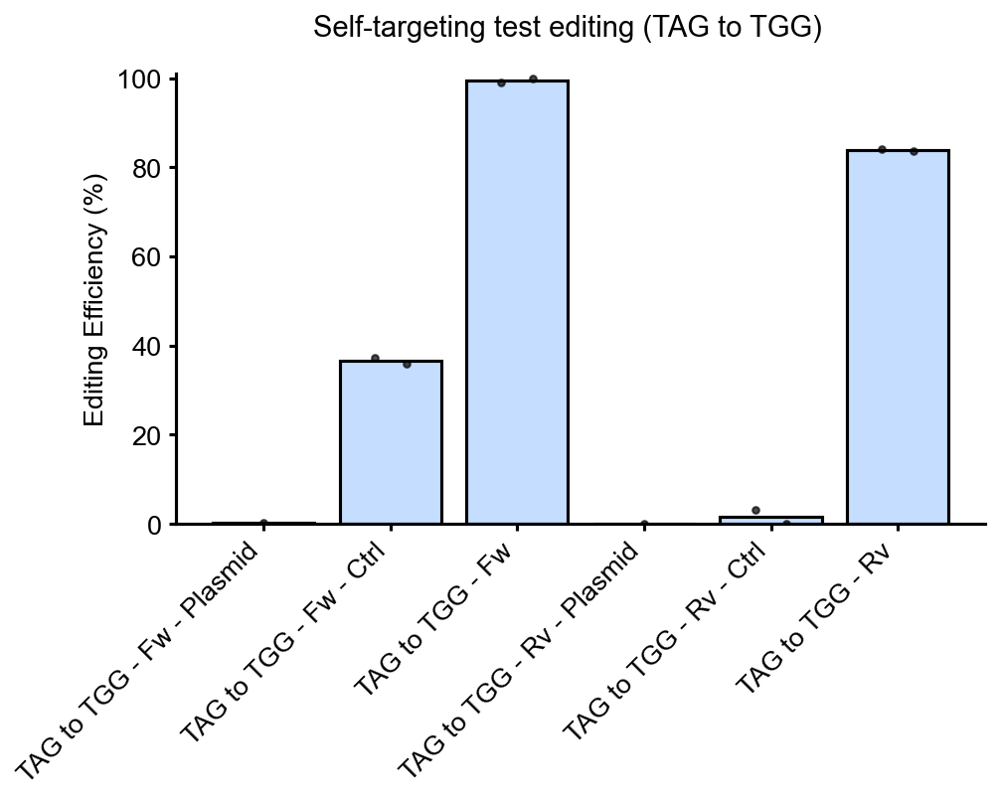

In [100]:
fig21, ax21 = plt.subplots(1,1, figsize = (7,4),dpi=150)
fig21.suptitle('Self-targeting test editing (TAG to TGG)\n', fontsize=titlesize)
#editingchar = ['averageedited', 'averageindel']
labels = list(averagedf.index)
data = list(averagedf)
ax21.bar(labels[:6],data[:6], **bar_kwargs)
x = list(labels[:6])
y = individual_valueslist_TAG_TGG
counter = 0
for i in range(len(x)):
    for repli in range(2):
        if ((i == 0) or (i == 3)) and repli < 1:
            ax21.scatter(i, y[counter], s=10, color='black',alpha=0.7,zorder=5)
        elif ((i == 0) or (i == 3)) and repli > 0:
            continue
        else:
            ax21.scatter(i+(repli/2-0.25)/2, y[counter], s=10, color='black',alpha=0.7,zorder=10)
        counter+=1
#ax21.set_title(targetbases[ind], fontsize=16)
ax21.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax21.set_xticklabels(labels[:6], ha="right")
ax21.tick_params(axis='x', labelsize= lsize, width=1.5, rotation=45)
ax21.tick_params(axis='y', labelsize= lsize, width=1.5)
ax21.spines['right'].set_visible(False)
ax21.spines['top'].set_visible(False)
#ax21.tick_params(axis='x', labelrotation=90)
ax21.set_ylim(0,101)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'target_seq_orientation_TGG.pdf', format='pdf',
        transparent=True,bbox_inches='tight')

C:\Users\nimath\AppData\Local\Temp/ipykernel_16484/2643094487.py:21: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax21.set_xticklabels(labels[6:], ha="right")


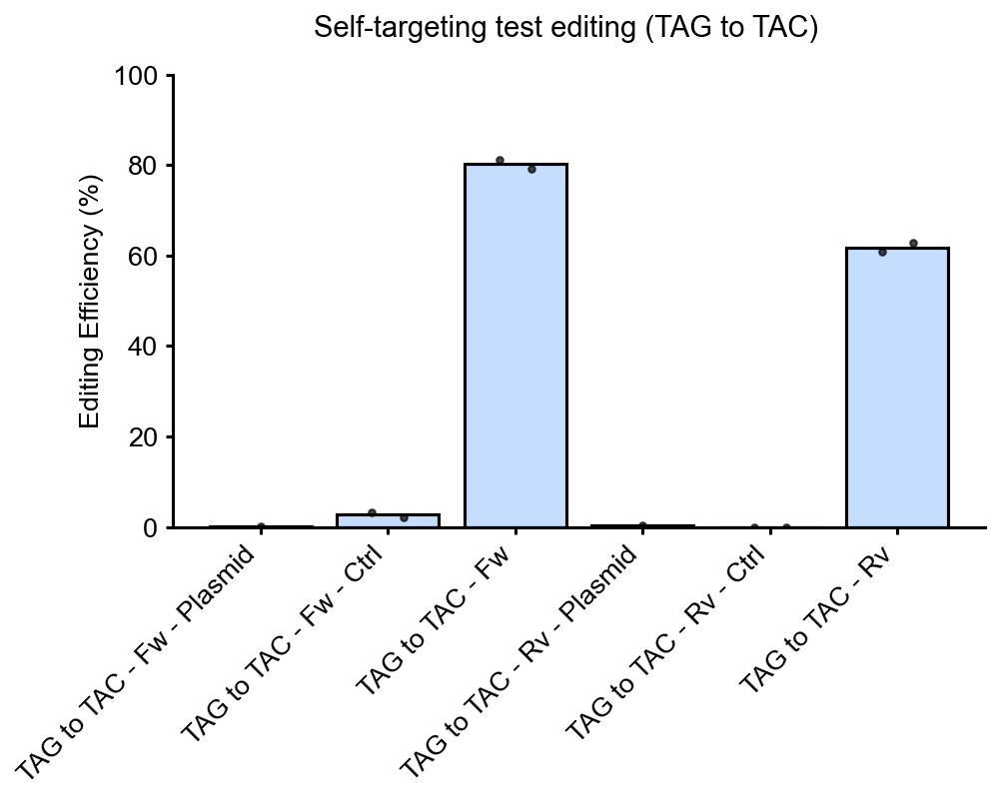

In [101]:
fig21, ax21 = plt.subplots(1,1, figsize = (7,4),dpi=150)
fig21.suptitle('Self-targeting test editing (TAG to TAC)\n', fontsize=titlesize)
#editingchar = ['averageedited', 'averageindel']
labels = list(averagedf.index)
data = list(averagedf)
ax21.bar(labels[6:],data[6:], **bar_kwargs)
x = list(labels[:6])
y = individual_valueslist_TAG_TAC
counter = 0
for i in range(len(x)):
    for repli in range(2):
        if ((i == 0) or (i == 3)) and repli < 1:
            ax21.scatter(i, y[counter], s=10, color='black',alpha=0.7,zorder=5)
        elif ((i == 0) or (i == 3)) and repli > 0:
            continue
        else:
            ax21.scatter(i+(repli/2-0.25)/2, y[counter], s=10, color='black',alpha=0.7,zorder=10)
        counter+=1
#ax21.set_title(targetbases[ind], fontsize=16)
ax21.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax21.set_xticklabels(labels[6:], ha="right")
ax21.tick_params(axis='x', labelsize= lsize, width=1.5, rotation=45)
ax21.tick_params(axis='y', labelsize= lsize, width=1.5)
ax21.spines['right'].set_visible(False)
ax21.spines['top'].set_visible(False)
#ax21.tick_params(axis='x', labelrotation=90)
ax21.set_ylim(0,100)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'target_seq_orientation_TAC.pdf', format='pdf',
        transparent=True,bbox_inches='tight')

## Correlation Plot between replicates

In [102]:
sample_efficiency_df = templatedf[['PE1df_percentageedited_corrected_individual', 'PE2df_percentageedited_corrected_individual',
                                   'PE3df_percentageedited_corrected_individual','PE1df_percentageindel_corrected_individual', 
                                   'PE2df_percentageindel_corrected_individual','PE3df_percentageindel_corrected_individual',
                                   'CTRdf_percentageedited','CTRdf_percentageindel']].copy()

## Correlation plot between Replicate 1 and 2

In [103]:
rep1eff = sample_efficiency_df['PE1df_percentageedited_corrected_individual'].reset_index(drop=True)
rep2eff = sample_efficiency_df['PE2df_percentageedited_corrected_individual'].reset_index(drop=True)
xy = np.vstack([rep1eff,rep2eff])
z = gaussian_kde(xy)(xy)

# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
Correlation_x, Correlation_y, Correlation_z = rep1eff[idx], rep2eff[idx], z[idx]
rep1_2_R = stats.spearmanr(rep1eff, rep2eff)[0]
rep1_2_r = stats.pearsonr(rep1eff, rep2eff)[0]


In [104]:
rep1_2_R = stats.spearmanr(templatedf['PE1df_percentageedited_corrected_individual'], templatedf['PE2df_percentageedited_corrected_individual'])[0]
rep1_2_r = stats.pearsonr(templatedf['PE1df_percentageedited_corrected_individual'], templatedf['PE2df_percentageedited_corrected_individual'])[0]
print(rep1_2_R, rep1_2_r)

0.9844334540191451 0.98854757970597


In [105]:
rep1eff = sample_efficiency_df['PE1df_percentageedited_corrected_individual'].reset_index(drop=True)
rep2eff = sample_efficiency_df['PE2df_percentageedited_corrected_individual'].reset_index(drop=True)
rep3eff = sample_efficiency_df['PE3df_percentageedited_corrected_individual'].reset_index(drop=True)
print(len(rep1eff))
print(len(rep2eff))
print(len(rep3eff))

92423
92423
92423


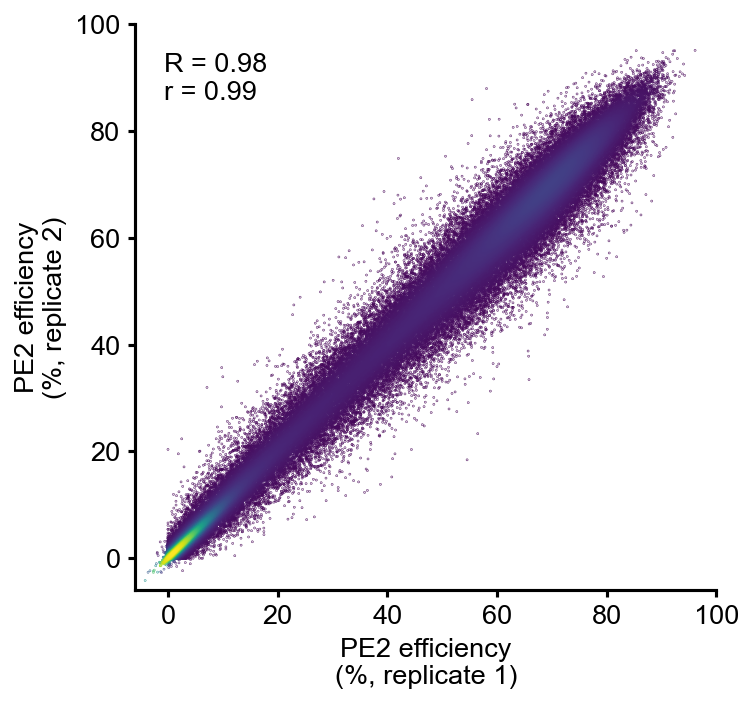

In [106]:
fig99, ax99 = plt.subplots(figsize = (5, 5),dpi=150)
ax99.scatter(Correlation_x, Correlation_y, c=Correlation_z, s=0.05)
#sn.set_style("ticks")
xlabels=[0,20,40,60,80,100]
# ax.xaxis.set_tick_params(width=2)
ax99.tick_params(axis='x', labelsize= lsize, width=1.5)
ax99.tick_params(axis='y', labelsize= lsize, width=1.5)
ax99.set_xlabel('PE2 efficiency\n(%, replicate 1)', fontsize=lsize)
ax99.set_ylabel('PE2 efficiency\n(%, replicate 2)', fontsize=lsize)
ax99.set_xlim(-6, 100)
ax99.set_ylim(-6, 100)
ax99.set_xticks([0,20,40,60,80,100])
ax99.spines['right'].set_visible(False)
ax99.spines['top'].set_visible(False)
ax99.text(0.05, 0.95, 'R = '+str(round(rep1_2_R, 2))+'\nr = '+str(round(rep1_2_r, 2)), transform=ax99.transAxes, fontsize=lsize,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'r1_r2_correlation.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

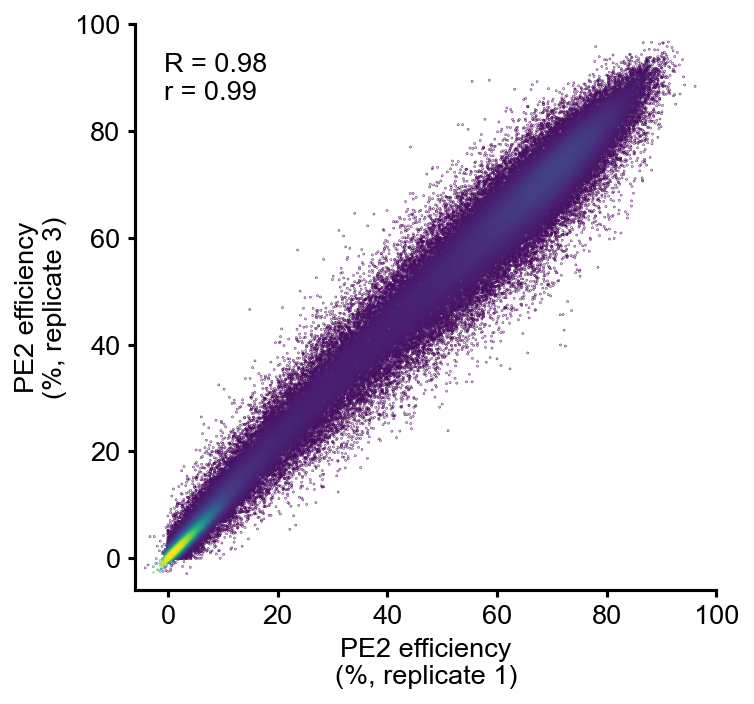

In [107]:
rep1eff = sample_efficiency_df['PE1df_percentageedited_corrected_individual'].reset_index(drop=True)
rep3eff = sample_efficiency_df['PE3df_percentageedited_corrected_individual'].reset_index(drop=True)
xy = np.vstack([rep1eff,rep3eff])
z = gaussian_kde(xy)(xy)

# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
Correlation_x, Correlation_y, Correlation_z_1_3 = rep1eff[idx], rep3eff[idx], z[idx]
rep1_3_R = stats.spearmanr(rep1eff, rep3eff)[0]
rep1_3_r = stats.pearsonr(rep1eff, rep3eff)[0]
fig, ax = plt.subplots(figsize = (5, 5),dpi=150)
ax.scatter(Correlation_x, Correlation_y, c=Correlation_z_1_3, s=0.05)
xlabels=[0,20,40,60,80,100]
# ax.xaxis.set_tick_params(width=2)
ax.tick_params(axis='x', labelsize= lsize, width=1.5)
ax.tick_params(axis='y', labelsize= lsize, width=1.5)
ax.set_xlabel('PE2 efficiency\n(%, replicate 1)', fontsize=lsize)
ax.set_ylabel('PE2 efficiency\n(%, replicate 3)', fontsize=lsize)
ax.set_xlim(-6, 100)
ax.set_ylim(-6, 100)
ax.set_xticks([0,20,40,60,80,100])
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.text(0.05, 0.95, 'R = '+str(round(rep1_3_R, 2))+'\nr = '+str(round(rep1_3_r, 2)), transform=ax.transAxes, fontsize=lsize,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'r1_r3_individual_correlation.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()


In [108]:
rep2eff = sample_efficiency_df['PE2df_percentageedited_corrected_individual'].reset_index(drop=True)
rep3eff = sample_efficiency_df['PE3df_percentageedited_corrected_individual'].reset_index(drop=True)
xy = np.vstack([rep2eff,rep3eff])
z = gaussian_kde(xy)(xy)

# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
Correlation_x, Correlation_y, Correlation_z_2_3 = rep2eff[idx], rep3eff[idx], z[idx]
rep2_3_R = stats.spearmanr(rep2eff, rep3eff)[0]
rep2_3_r = stats.pearsonr(rep2eff, rep3eff)[0]

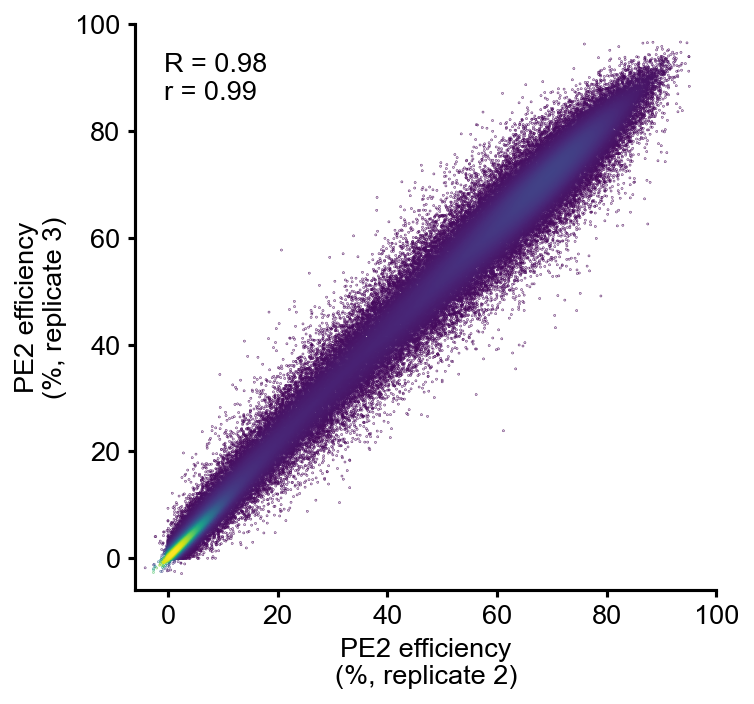

In [109]:
fig, ax = plt.subplots(figsize = (5, 5),dpi=150)
ax.scatter(Correlation_x, Correlation_y, c=Correlation_z_2_3, s=0.05)
xlabels=[0,20,40,60,80,100]
# ax.xaxis.set_tick_params(width=2)
ax.tick_params(axis='x', labelsize= lsize, width=1.5)
ax.tick_params(axis='y', labelsize= lsize, width=1.5)
ax.set_xlabel('PE2 efficiency\n(%, replicate 2)', fontsize=lsize)
ax.set_ylabel('PE2 efficiency\n(%, replicate 3)', fontsize=lsize)
ax.set_xlim(-6, 100)
ax.set_ylim(-6, 100)
ax.set_xticks([0,20,40,60,80,100])
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.text(0.05, 0.95, 'R = '+str(round(rep2_3_R, 2))+'\nr = '+str(round(rep2_3_r, 2)), transform=ax.transAxes, fontsize=lsize,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'r2_r3_correlation.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

## Correlation unintended edits 

Rep1 + Rep2

In [110]:
rep1ind = sample_efficiency_df['PE1df_percentageindel_corrected_individual'].reset_index(drop=True)
rep2ind = sample_efficiency_df['PE2df_percentageindel_corrected_individual'].reset_index(drop=True)
xmedian = rep1ind.median()
ymedian = rep2ind.median()
xy = np.vstack([rep1ind,rep2ind])
z = gaussian_kde(xy)(xy)

# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
Correlation_x, Correlation_y, Correlation_z_2_3 = rep1ind[idx], rep2ind[idx], z[idx]
rep2_3_R = stats.spearmanr(rep1ind, rep2ind)[0]
rep2_3_r = stats.pearsonr(rep1ind, rep2ind)[0]

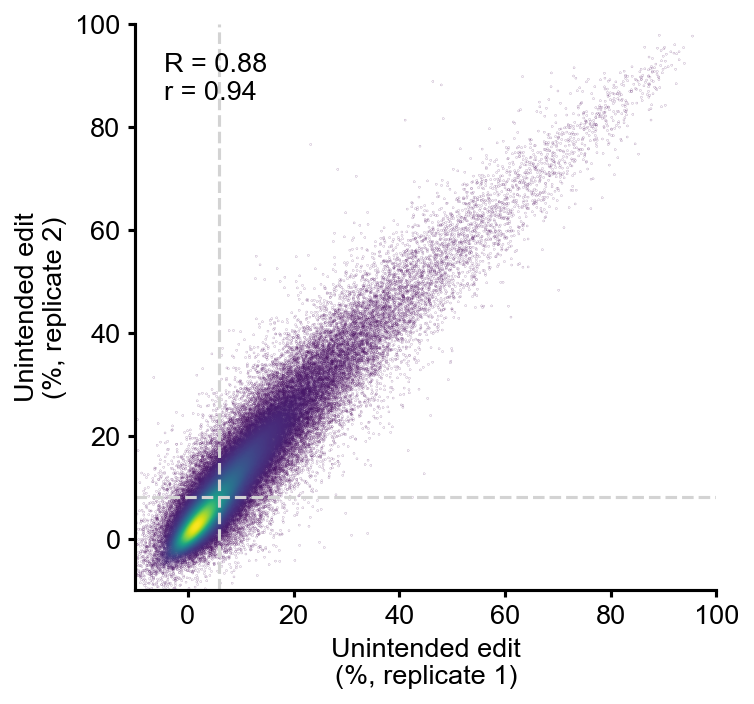

In [111]:
fig, ax = plt.subplots(figsize = (5, 5),dpi=150)
ax.vlines(xmedian,-10,100,colors='lightgrey', linestyles='dashed')
ax.hlines(ymedian,-10,100,colors='lightgrey', linestyles='dashed')
ax.scatter(Correlation_x, Correlation_y, c=Correlation_z_2_3, s=0.005)
xlabels=[0,20,40,60,80,100]
ax.tick_params(axis='x', labelsize= lsize, width=1.5)
ax.tick_params(axis='y', labelsize= lsize, width=1.5)

ax.set_xlabel('Unintended edit\n(%, replicate 1)', fontsize=lsize)
ax.set_ylabel('Unintended edit\n(%, replicate 2)', fontsize=lsize)
ax.set_xlim(-10, 100)
ax.set_ylim(-10, 100)
ax.set_xticks([0,20,40,60,80,100])
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.text(0.05, 0.95, 'R = '+str(round(rep2_3_R, 2))+'\nr = '+str(round(rep2_3_r, 2)), transform=ax.transAxes, fontsize=lsize,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'unintended_r1_r2_correlation.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

Rep1 + Rep3

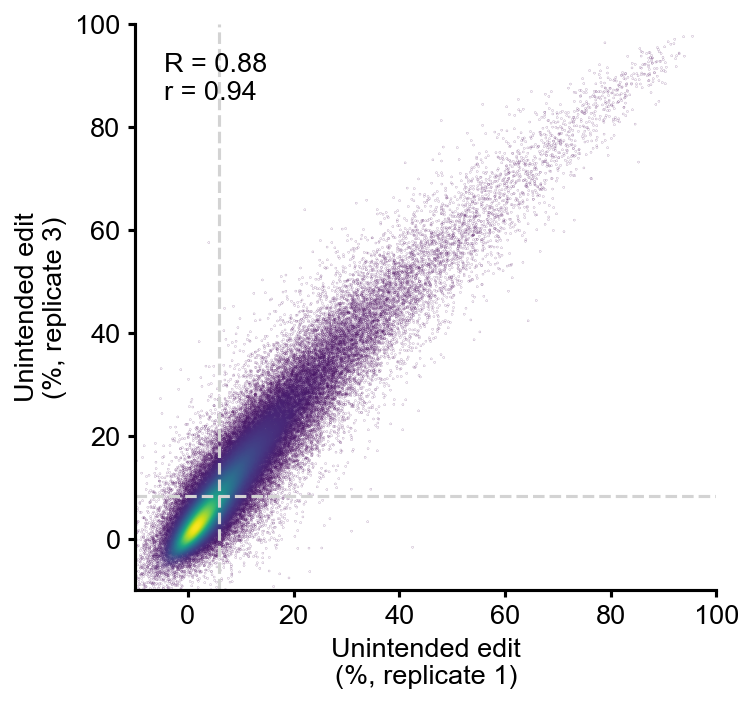

In [112]:
rep1ind = sample_efficiency_df['PE1df_percentageindel_corrected_individual'].reset_index(drop=True)
rep3ind = sample_efficiency_df['PE3df_percentageindel_corrected_individual'].reset_index(drop=True)
xmedian = rep1ind.median()
ymedian = rep3ind.median()
xy = np.vstack([rep1ind,rep3ind])
z = gaussian_kde(xy)(xy)

# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
Correlation_x, Correlation_y, Correlation_z_2_3 = rep1ind[idx], rep3ind[idx], z[idx]
rep2_3_R = stats.spearmanr(rep1ind, rep3ind)[0]
rep2_3_r = stats.pearsonr(rep1ind, rep3ind)[0]
fig, ax = plt.subplots(figsize = (5, 5),dpi=150)
ax.vlines(xmedian,-10,100,colors='lightgrey', linestyles='dashed')
ax.hlines(ymedian,-10,100,colors='lightgrey', linestyles='dashed')
ax.scatter(Correlation_x, Correlation_y, c=Correlation_z_2_3, s=0.005)
xlabels=[0,20,40,60,80,100]
# ax.xaxis.set_tick_params(width=2)
ax.tick_params(axis='x', labelsize= lsize, width=1.5)
ax.tick_params(axis='y', labelsize= lsize, width=1.5)
ax.set_xlabel('Unintended edit\n(%, replicate 1)', fontsize=lsize)
ax.set_ylabel('Unintended edit\n(%, replicate 3)', fontsize=lsize)
ax.set_xlim(-10, 100)
ax.set_ylim(-10, 100)
ax.set_xticks([0,20,40,60,80,100])
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.text(0.05, 0.95, 'R = '+str(round(rep2_3_R, 2))+'\nr = '+str(round(rep2_3_r, 2)), transform=ax.transAxes, fontsize=lsize,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'unintended_r1_r3_correlation.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()


Rep2 + Rep3

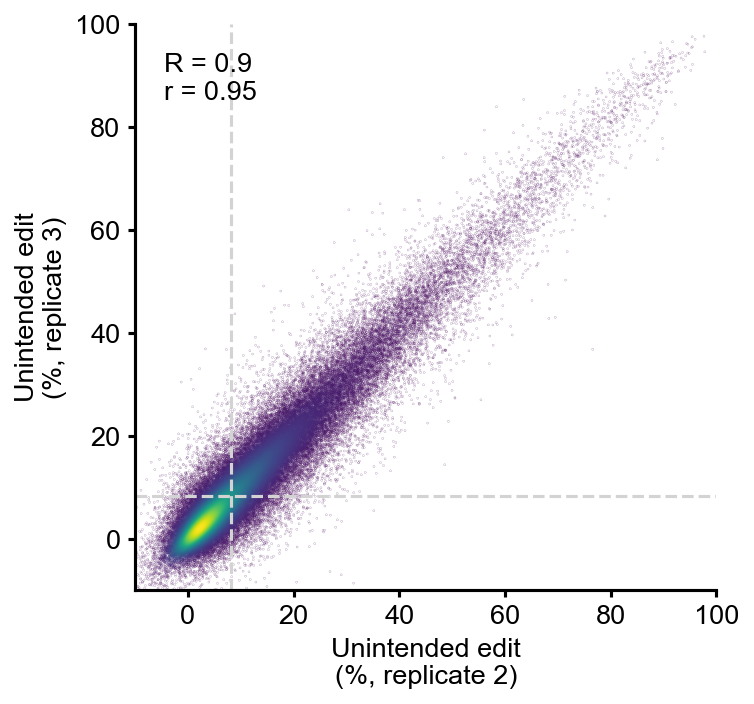

In [113]:
rep2eff = sample_efficiency_df['PE2df_percentageindel_corrected_individual'].reset_index(drop=True)
rep3eff = sample_efficiency_df['PE3df_percentageindel_corrected_individual'].reset_index(drop=True)
xmedian = rep2ind.median()
ymedian = rep3ind.median()
xy = np.vstack([rep2eff,rep3eff])
z = gaussian_kde(xy)(xy)

# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
Correlation_x, Correlation_y, Correlation_z_2_3 = rep2eff[idx], rep3eff[idx], z[idx]
rep2_3_R = stats.spearmanr(rep2eff, rep3eff)[0]
rep2_3_r = stats.pearsonr(rep2eff, rep3eff)[0]
fig, ax = plt.subplots(figsize = (5, 5),dpi=150)
ax.vlines(xmedian,-10,100,colors='lightgrey', linestyles='dashed')
ax.hlines(ymedian,-10,100,colors='lightgrey', linestyles='dashed')
ax.scatter(Correlation_x, Correlation_y, c=Correlation_z_2_3, s=0.005)
xlabels=[0,20,40,60,80,100]
ax.tick_params(axis='x', labelsize= lsize, width=1.5)
ax.tick_params(axis='y', labelsize= lsize, width=1.5)
ax.set_xlabel('Unintended edit\n(%, replicate 2)', fontsize=lsize)
ax.set_ylabel('Unintended edit\n(%, replicate 3)', fontsize=lsize)
ax.set_xlim(-10, 100)
ax.set_ylim(-10, 100)
ax.set_xticks([0,20,40,60,80,100])
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.text(0.05, 0.95, 'R = '+str(round(rep2_3_R, 2))+'\nr = '+str(round(rep2_3_r, 2)), transform=ax.transAxes, fontsize=lsize,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'unintended_r2_r3_correlation.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()


## Reads distribution table

In [114]:
summarycountlist = []
minimumcountlist = []
for index, row in backup_tempdf.iterrows():
    read1 = row['PE1df_totalreads']
    read2 = row['PE2df_totalreads']
    read3 = row['PE3df_totalreads']
    
    if np.isnan(row['PE1df_totalreads']):
        read1 = 0
    if np.isnan(row['PE2df_totalreads']):
        read2 = 0
    if np.isnan(row['PE3df_totalreads']):
        read3 = 0
    sumcount = int(read1+read2+read3)
    
    
    summarycountlist.append(sumcount)
    minimumcountlist.append(min(read1,read2,read3))
minimumcount = Counter(minimumcountlist)
summarycount = Counter(summarycountlist)

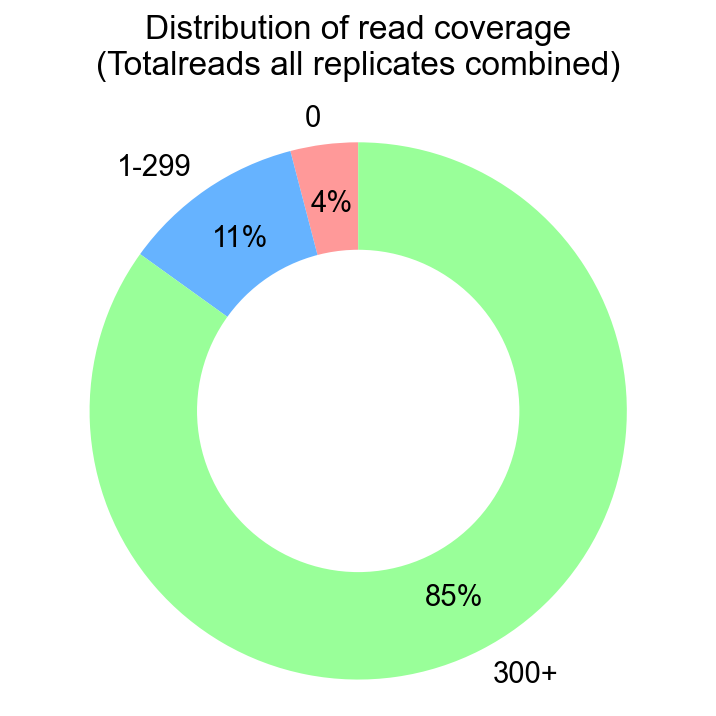

In [115]:
fig16, ax16 = plt.subplots(figsize = (5, 5),dpi=150)
plt.rcParams['font.size'] = 14.0
ax16.set_title('Distribution of read coverage\n(Totalreads all replicates combined)\n', fontsize=16)
readsbindict = {'0':0,'1-299':0,'300+':0}
for entry in summarycount.keys():
    if entry == 0:
        readsbindict['0']+= summarycount[entry]
    elif entry < 300:
        readsbindict['1-299']+= summarycount[entry]
    else:
        readsbindict['300+']+= summarycount[entry]
labels = []
sizes = []
for x, y in readsbindict.items():
    labels.append(x)
    sizes.append(y)
explode = (0.05,0.05,0.05)        
colors = ['#ff9999','#66b3ff','#99ff99']
ax16.pie(sizes, colors = colors, labels=labels, autopct='%1.0f%%', startangle=90, pctdistance=0.78)
centre_circle = plt.Circle((0,0),0.60,fc='white')
fig16 = plt.gcf()
fig16.gca().add_artist(centre_circle)
ax16.axis('equal')
plt.tight_layout()
plt.show()

## Minimum reads overview
Checks for every variant which replicate has the lowest number of reads. Only variants with 100+ reads in ALL replicates are used in the final analysis.

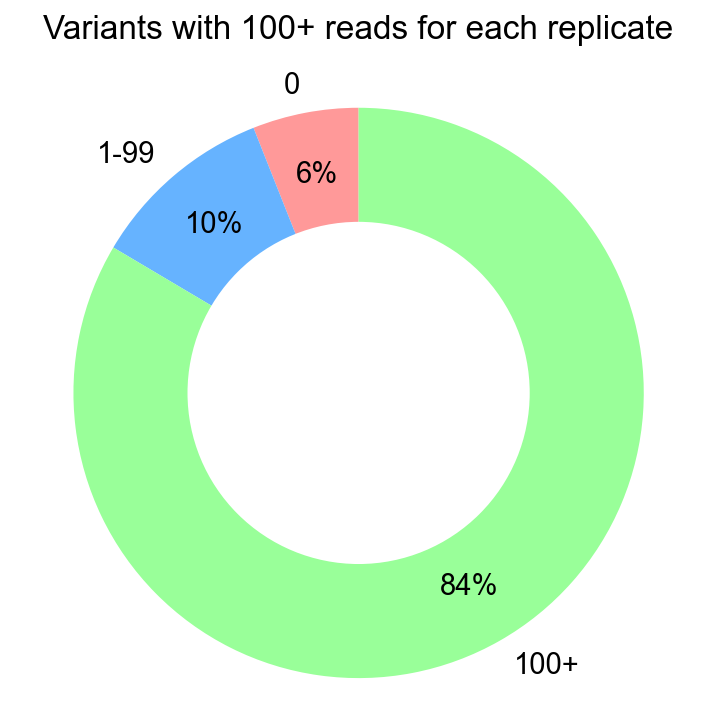

In [116]:
fig36, ax36 = plt.subplots(figsize = (5, 5),dpi=150)
plt.rcParams['font.size'] = 14.0
ax36.set_title('Variants with 100+ reads for each replicate\n', fontsize=16)
readsbindict = {'0':0,'1-99':0,'100+':0}
for entry in minimumcount.keys():
    if entry == 0:
        readsbindict['0']+= minimumcount[entry]
    elif entry < 100:
        readsbindict['1-99']+= minimumcount[entry]
    else:
        readsbindict['100+']+= minimumcount[entry]
labels = []
sizes = []
for x, y in readsbindict.items():
    labels.append(x)
    sizes.append(y)
explode = (0.05,0.05,0.05)        
colors = ['#ff9999','#66b3ff','#99ff99']
ax36.pie(sizes, colors = colors, labels=labels, autopct='%1.0f%%', startangle=90, pctdistance=0.78)
centre_circle = plt.Circle((0,0),0.60,fc='white')
fig36 = plt.gcf()
fig36.gca().add_artist(centre_circle)
ax36.axis('equal')
plt.tight_layout()
plt.show()

## Histogram of readcounts

1985.0


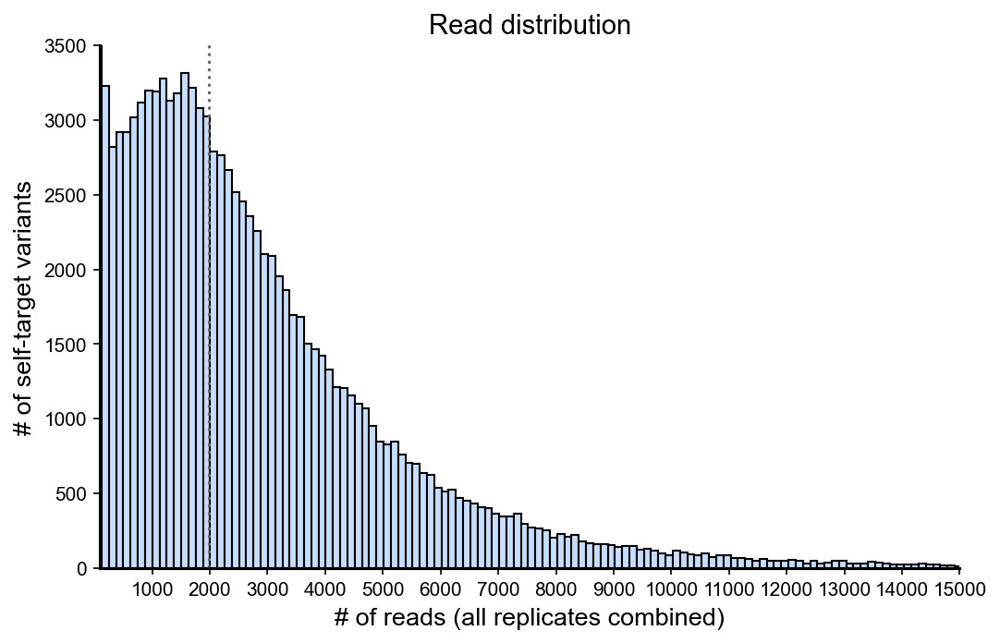

In [117]:
fig37, ax37 = plt.subplots(figsize = (8, 5),dpi=150)
ax37.set_title('Read distribution', fontsize=titlesize)

top_10 = np.percentile(summarycountlist, 90)
bottom_10 = np.percentile(summarycountlist, 10)
middle_50 = np.percentile(summarycountlist, 50)
if top_10 != 0 and bottom_10 != 0:
    skew_ratio = top_10/bottom_10
    skew_ratio = str(round(skew_ratio, 2))
zero_count = summarycountlist.count(0)

#plot histogram
counts, bins = np.histogram(summarycountlist, bins=1000)
binlabels = [int(x) for x in bins]
ax37.hist(bins[:-1], bins, weights=counts, edgecolor='black', color='#C5DEFF')
ax37.set_xticks(list(range(0,16000,1000)))
ax37.spines['right'].set_visible(False)
ax37.spines['top'].set_visible(False)
ax37.set_xlim(100, 15000)
ax37.set_ylim(0,3500)
ax37.tick_params(axis='both', which='major', labelsize=10)

ax37.set_ylabel('# of self-target variants',fontsize=lsize)
ax37.set_xlabel('# of reads (all replicates combined)',fontsize=lsize)
ax37.vlines(middle_50, 0, max(counts), linestyles = "dotted", colors="#696969")
print(middle_50)

figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'reads_distribution_histogram.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

## Visualize found design-variants vs. different protospacer vs. disease-variants (after coverage filtering)

In [118]:
variantlist = []
for index, row in templatedf.iterrows():
    variantname = row['Name']+"_"+str(row['Editing_Position'])+"_"+str(row['Target_Strand'])
    variantlist.append(variantname)
templatedf['variantname'] = variantlist
nroffounddesignvariants = len(templatedf)
nrofuniqueprotospacers = len(set(templatedf['variantname']))
nrofdiseasevariants = len(set(templatedf['Name']))
nrofgenes = len(set(templatedf['Gene']))
print(f'Designvariants: {nroffounddesignvariants}, Protospacer: {nrofuniqueprotospacers}, Disease Loci: {nrofdiseasevariants}, Genes: {nrofgenes}')

Designvariants: 92423, Protospacer: 25436, Disease Loci: 13349, Genes: 2486


In [119]:
len(templatedf[templatedf['Correction_Type'] == 'Replacement'])

57920

In [120]:
len(templatedf[templatedf['Correction_Type'] == 'Insertion'])

28420

In [121]:
len(templatedf[templatedf['Correction_Type'] == 'Deletion'])

6083

In [122]:
templatedf[templatedf['Correction_Type'] == 'Replacement']['averageedited'].median()

51.9509424841392

In [123]:
templatedf[templatedf['Correction_Type'] == 'Insertion']['averageedited'].median()

30.55019872764321

In [124]:
templatedf[templatedf['Correction_Type'] == 'Deletion']['averageedited'].median()

30.515028226193

In [125]:
templatedf['averageedited'].median()

46.31932026100292

In [126]:
templatedf['averageindel'].median()

7.387126837185196

In [127]:
templatedf[templatedf['Correction_Type'] == 'Replacement']['averageindel'].median()

6.8197681940941495

In [128]:
templatedf[templatedf['Correction_Type'] == 'Insertion']['averageindel'].median()

8.73506978794025

In [129]:
templatedf[templatedf['Correction_Type'] == 'Deletion']['averageindel'].median()

7.517386356954685

In [130]:
diseaselociuniquedf = templatedf.drop_duplicates(subset=['Name'])
genescount = Counter(diseaselociuniquedf['Gene'])
genescount = dict(sorted(genescount.items(), key=lambda item: item[1], reverse=True))

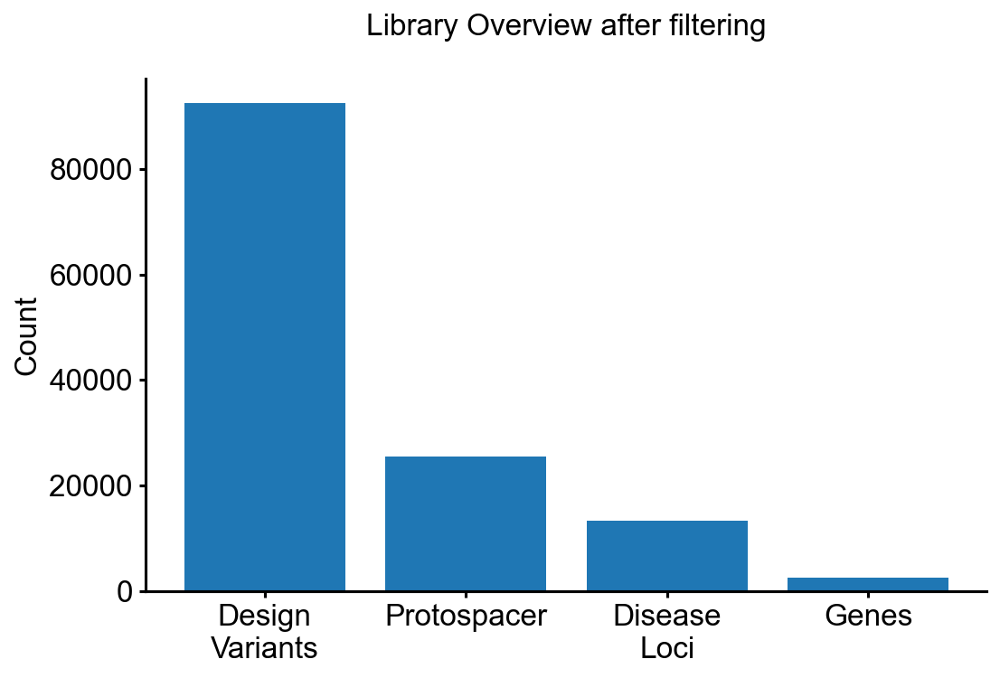

In [131]:
fig17, ax17 = plt.subplots(figsize = (8, 5),dpi=150)
ax17.set_title('Library Overview after filtering\n', fontsize=16)
labels = ['Design\nVariants', 'Protospacer', 
                    'Disease\nLoci', 'Genes']
ax17.bar(labels, [nroffounddesignvariants,nrofuniqueprotospacers,nrofdiseasevariants,nrofgenes])
#ax17.set_xticklabels(['Design Variants', 'Protospacer', 
                    #'Disease Loci', 'Genes'])
#ax17.set_xlabel('Editing Type', fontsize=16)
ax17.set_ylabel('Count', fontsize=16)
ax17.tick_params(axis='x', labelsize= 16, width=1.5)
ax17.tick_params(axis='y', labelsize= 16, width=1.5)
ax17.spines['right'].set_visible(False)
ax17.spines['top'].set_visible(False)
#plt.xticks(rotation=45)
  
# show plot
plt.show()

In [132]:
genecount=Counter(templatedf['Gene'])
genecount = {k: v for k, v in sorted(genecount.items(), key=lambda item: item[1], reverse=True)}
#genecount = sorted(genecount, key=genecount.get, reverse=True)

## Visualize found design-variants vs. different protospacer vs. disease-variants (BEFORE coverage filtering)

In [133]:
variantlist = []
for index, row in backup_tempdf.iterrows():
    variantname = row['Name']+"_"+str(row['Editing_Position'])+"_"+str(row['Target_Strand'])
    variantlist.append(variantname)
backup_tempdf['variantname'] = variantlist
nroffounddesignvariants = len(backup_tempdf)
nrofuniqueprotospacers = len(set(backup_tempdf['variantname']))
nrofdiseasevariants = len(set(backup_tempdf['Name']))
nrofgenes = len(set(backup_tempdf['Gene']))
print(f'Designvariants: {nroffounddesignvariants}, Protospacer: {nrofuniqueprotospacers}, Disease Loci: {nrofdiseasevariants}, Genes: {nrofgenes}')

Designvariants: 119701, Protospacer: 29986, Disease Loci: 14238, Genes: 2530


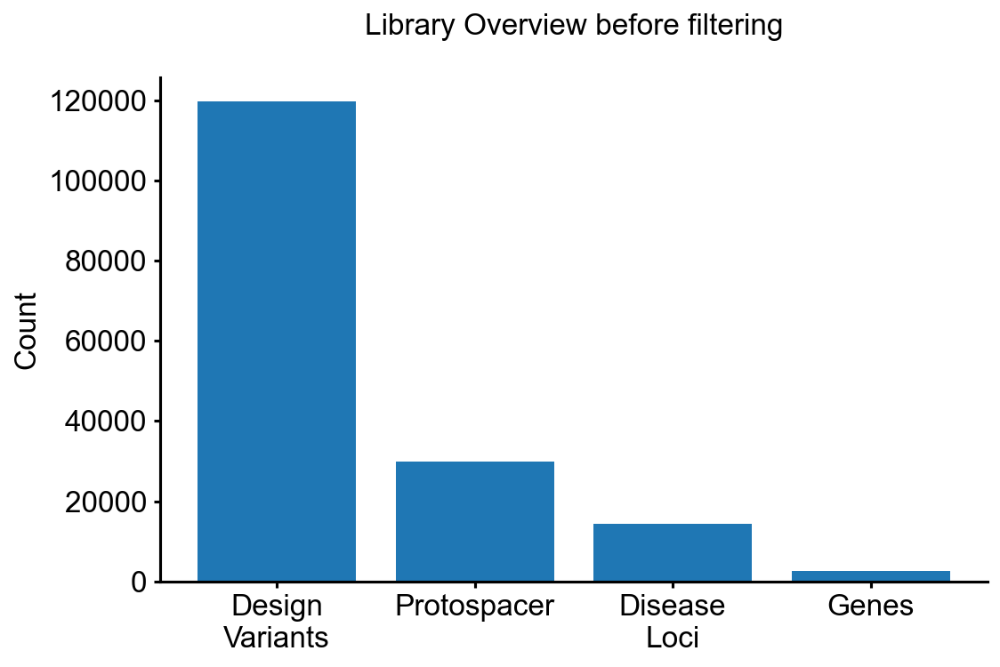

In [134]:
fig17, ax17 = plt.subplots(figsize = (8, 5),dpi=150)
ax17.set_title('Library Overview before filtering\n', fontsize=16)
labels = ['Design\nVariants', 'Protospacer', 
                    'Disease\nLoci', 'Genes']
ax17.bar(labels, [nroffounddesignvariants,nrofuniqueprotospacers,nrofdiseasevariants,nrofgenes])
#ax17.set_xticklabels(['Design Variants', 'Protospacer', 
                    #'Disease Loci', 'Genes'])
#ax17.set_xlabel('Editing Type', fontsize=16)
ax17.set_ylabel('Count', fontsize=16)
ax17.tick_params(axis='x', labelsize= 16, width=1.5)
ax17.tick_params(axis='y', labelsize= 16, width=1.5)
ax17.spines['right'].set_visible(False)
ax17.spines['top'].set_visible(False)
#plt.xticks(rotation=45)
  
# show plot
plt.show()

## Visualize distribution of edit position

Insertion edit positions: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


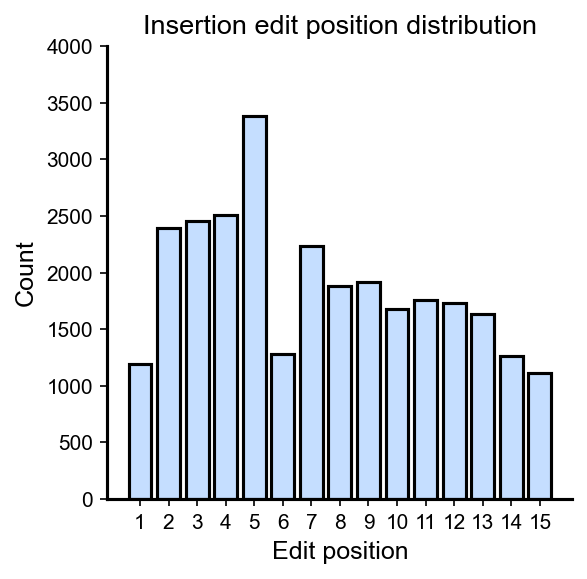

In [141]:
insertiondf = templatedf[templatedf['Correction_Type'] == 'Insertion']
print('Insertion edit positions:',sorted(list(insertiondf.Editing_Position.unique())))
insertion_editpositioncount = Counter(insertiondf.Editing_Position)
insertion_editpositioncount = OrderedDict(sorted(insertion_editpositioncount.items()))
positionlist = []
countlist = []
for k, v in insertion_editpositioncount.items(): 
    positionlist.append(k+1)
    countlist.append(v)
    #print(k, v)
    
fig, ax = plt.subplots(1,1,figsize = (4, 4),dpi=150)
plt.rcParams['axes.linewidth'] = 1.5
ax.bar(positionlist, countlist, **bar_kwargs)
ax.set_title('Insertion edit position distribution', fontsize=13)
ax.set_xlabel('Edit position', fontsize=12)
ax.set_ylabel('Count', fontsize=12)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
ax.set_xticks(range(1,16,1))
ax.set_ylim(0, 4000)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'Insertion_editposition_distribution.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()


Replacement edit positions: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]


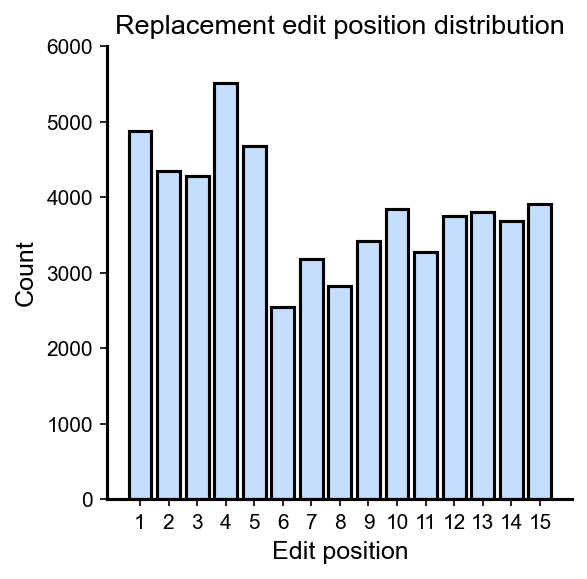

In [142]:
replacementdf = templatedf[templatedf['Correction_Type'] == 'Replacement']
print('Replacement edit positions:',sorted(list(replacementdf.Editing_Position.unique())))
replacement_editpositioncount = Counter(replacementdf.Editing_Position)
replacement_editpositioncount = OrderedDict(sorted(replacement_editpositioncount.items()))
positionlist = []
countlist = []
for k, v in replacement_editpositioncount.items(): 
    positionlist.append(k+1)
    countlist.append(v)
    #print(k, v)
    
fig, ax = plt.subplots(1,1,figsize = (4, 4),dpi=150)
plt.rcParams['axes.linewidth'] = 1.5
ax.bar(positionlist, countlist, **bar_kwargs)
ax.set_title('Replacement edit position distribution', fontsize=13)
ax.set_xlabel('Edit position', fontsize=12)
ax.set_ylabel('Count', fontsize=12)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
ax.set_xticks(range(1,16,1))
ax.set_ylim(0, 6000)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'replacement_editposition_distribution.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()



Deletion edit positions: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]


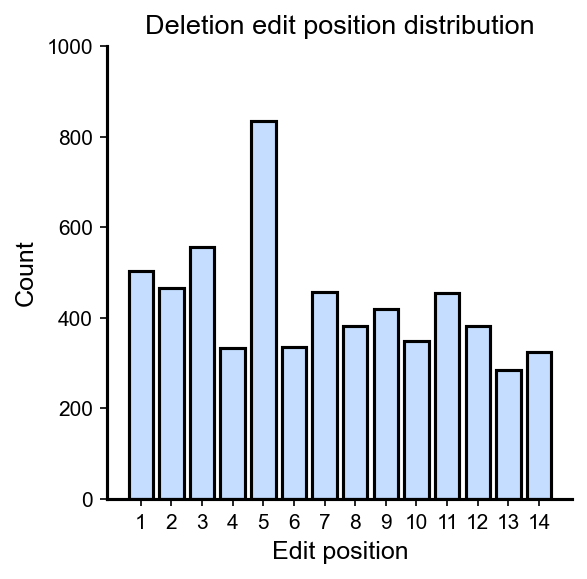

In [143]:
deletiondf = templatedf[templatedf['Correction_Type'] == 'Deletion']
print('Deletion edit positions:',sorted(list(deletiondf.Editing_Position.unique())))

deletion_editpositioncount = Counter(deletiondf.Editing_Position)
deletion_editpositioncount = OrderedDict(sorted(deletion_editpositioncount.items()))
positionlist = []
countlist = []
for k, v in deletion_editpositioncount.items(): 
    positionlist.append(k+1)
    countlist.append(v)
    #print(k, v)
    
fig, ax = plt.subplots(1,1,figsize = (4, 4),dpi=150)
plt.rcParams['axes.linewidth'] = 1.5
ax.bar(positionlist, countlist, **bar_kwargs)
ax.set_title('Deletion edit position distribution', fontsize=13)
ax.set_xlabel('Edit position', fontsize=12)
ax.set_ylabel('Count', fontsize=12)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
ax.set_xticks(range(1,15,1))
ax.set_ylim(0, 1000)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'deletion_editposition_distribution.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()


## Visualize distribution of edit length

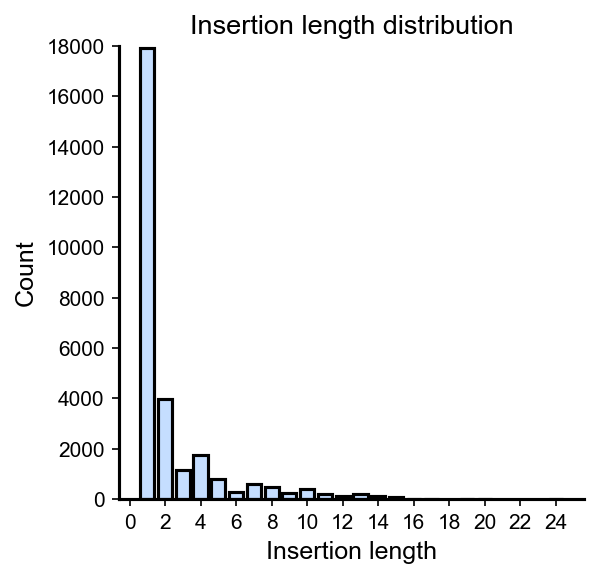

In [144]:
insertiondf = templatedf[templatedf['Correction_Type'] == 'Insertion']
insertion_correctionlengthcount = Counter(insertiondf.Correction_Length)
insertion_correctionlengthcount = OrderedDict(sorted(insertion_correctionlengthcount.items()))
positionlist = []
countlist = []
for k, v in insertion_correctionlengthcount.items(): 
    positionlist.append(k)
    countlist.append(v)
    #print(k, v)
    
fig, ax = plt.subplots(1,1,figsize = (4, 4),dpi=150)
plt.rcParams['axes.linewidth'] = 1.5
ax.bar(positionlist, countlist, **bar_kwargs)
ax.set_title('Insertion length distribution', fontsize=13)
ax.set_xlabel('Insertion length', fontsize=12)
ax.set_ylabel('Count', fontsize=12)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
ax.set_xticks(range(0,25,2))
ax.set_ylim(0, 18000)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'Insertion_correctionlength_distribution.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()


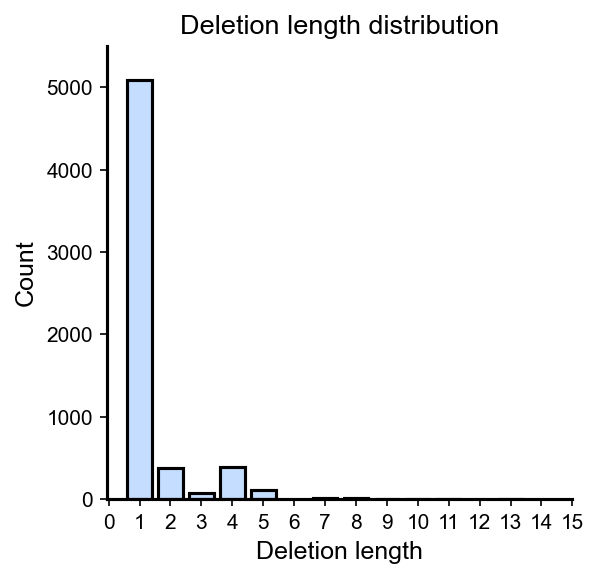

In [146]:
deletiondf = templatedf[templatedf['Correction_Type'] == 'Deletion']
deletion_correctionlengthcount = Counter(deletiondf.Correction_Length)
deletion_correctionlengthcount = OrderedDict(sorted(deletion_correctionlengthcount.items()))
positionlist = []
countlist = []
for k, v in deletion_correctionlengthcount.items(): 
    positionlist.append(k)
    countlist.append(v)
    #print(k, v)
    
fig, ax = plt.subplots(1,1,figsize = (4, 4),dpi=150)
plt.rcParams['axes.linewidth'] = 1.5
ax.bar(positionlist, countlist, **bar_kwargs)
ax.set_title('Deletion length distribution', fontsize=13)
ax.set_xlabel('Deletion length', fontsize=12)
ax.set_ylabel('Count', fontsize=12)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=10)
ax.set_xticks(range(0,16,1))
ax.set_ylim(0, 5500)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'deletion_correctionlength_distribution.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()


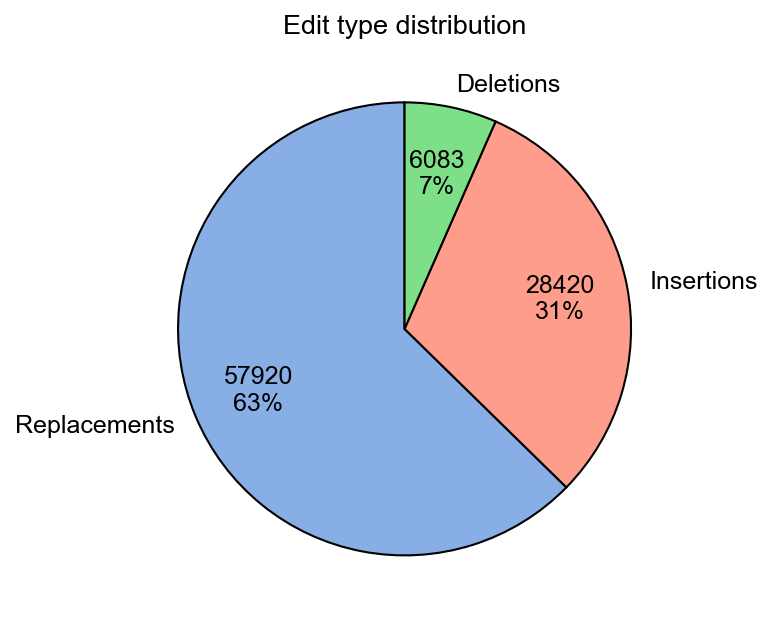

In [147]:
replacementcount = len(templatedf[templatedf['Correction_Type'] == 'Replacement'])
deletioncount = len(templatedf[templatedf['Correction_Type'] == 'Deletion'])
insertioncount = len(templatedf[templatedf['Correction_Type'] == 'Insertion'])
fig16, ax16 = plt.subplots(figsize = (5, 5),dpi=150)
ax16.set_title('Edit type distribution', fontsize=13)
labels = ['Replacements','Insertions','Deletions']
counts = [replacementcount,insertioncount,deletioncount]
colors = ['#88AFE5','#FE9D8C','#7de088']

def make_autopct(values,labels):
    def my_autopct(pct):
        total = sum(values)
        val = int(round(pct*total/100.0))
        return '{v:d}\n{p:.0f}%'.format(p=pct,v=val)
    return my_autopct


ax16.pie(counts, colors = colors, labels=labels, autopct= make_autopct(counts,labels), startangle=90,pctdistance=0.7,wedgeprops = {'linewidth': 1,'edgecolor' : "black"},  textprops={'fontsize': 12})
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup1_Correlation_Replicates\\'
plt.savefig(figurepath+'edit_types_distribution.pdf', format='pdf',
        transparent=True,bbox_inches='tight')

## Compare RT overhang length and efficiency

In [45]:
RTefficiency3 = templatedf[templatedf['RToverhanglength'] == 3]['averageedited']
RTefficiency7 = templatedf[templatedf['RToverhanglength'] == 7]['averageedited']
RTefficiency10 = templatedf[templatedf['RToverhanglength'] == 10]['averageedited']
RTefficiency15 = templatedf[templatedf['RToverhanglength'] == 15]['averageedited']

RTefficiencydata = [RTefficiency3, RTefficiency7,RTefficiency10,RTefficiency15]
RTefficiencydf = pd.concat([RTefficiency3, RTefficiency7,RTefficiency10,RTefficiency15], axis=1)
RTefficiencydf.columns = ['RToverhang3','RToverhang7','RToverhang10','RToverhang15']
RTefficiencymeltdf = pd.melt(RTefficiencydf.reset_index(), id_vars=['index'], value_vars=['RToverhang3','RToverhang7','RToverhang10','RToverhang15']).dropna()


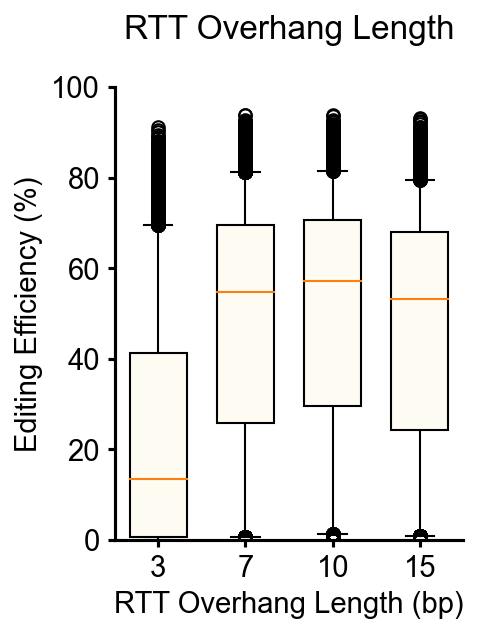

In [46]:
fig1, ax1 = plt.subplots(figsize = (3, 4), dpi=150)
ax1.set_title('RTT Overhang Length\n', fontsize=titlesize)
ax1.boxplot(RTefficiencydata, **boxplot_kwargs)
ax1.set_xticklabels(['3', '7', 
                    '10', '15'])
ax1.set_xlabel('RTT Overhang Length (bp)', fontsize=lsize)
ax1.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax1.tick_params(axis='x', labelsize= lsize, width=1.5)
ax1.tick_params(axis='y', labelsize= lsize, width=1.5)
ax1.set_ylim(0, 100)
ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)

figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'rtoverhanglength_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
# show plot
plt.show()


## RTlength vs editing:

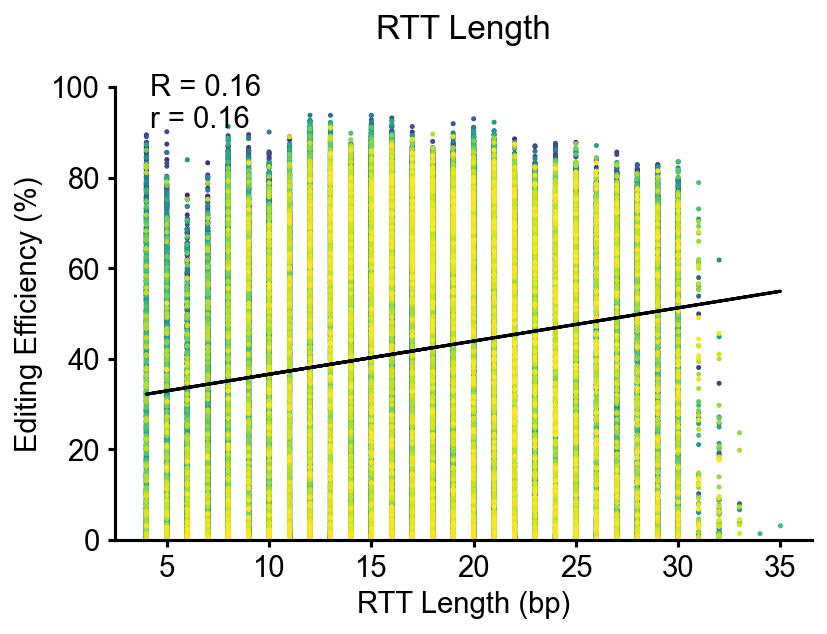

In [47]:
xaxis_column = 'RTlength'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('RTT Length\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('RTT Length (bp)', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'RT_length_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## RT Length vs unintended editing

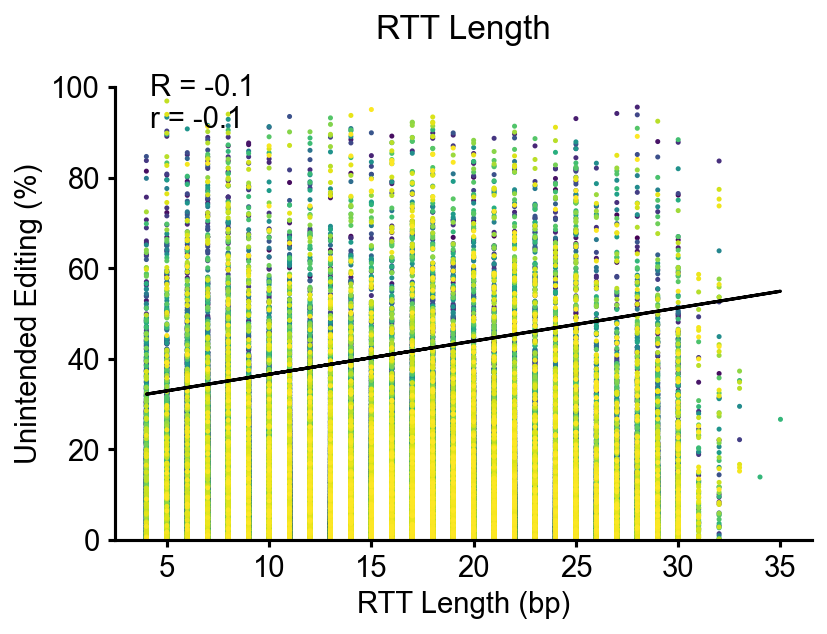

In [48]:
xaxis_column = 'RTlength'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('RTT Length\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('RTT Length (bp)', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'RT_length_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Compare RToverhang Length and indel frequency

In [50]:
RTindel3 = templatedf[templatedf['RToverhanglength'] == 3]['averageindel']
RTindel7 = templatedf[templatedf['RToverhanglength'] == 7]['averageindel']
RTindel10 = templatedf[templatedf['RToverhanglength'] == 10]['averageindel']
RTindel15 = templatedf[templatedf['RToverhanglength'] == 15]['averageindel']

RTindeldata = [RTindel3, RTindel7,RTindel10,RTindel15]
RTindeldf = pd.concat([RTindel3, RTindel7,RTindel10,RTindel15], axis=1)
RTindeldf.columns = ['RToverhang3','RToverhang7','RToverhang10','RToverhang15']
RTindelmeltdf = pd.melt(RTindeldf.reset_index(), id_vars=['index'], value_vars=['RToverhang3','RToverhang7','RToverhang10','RToverhang15']).dropna()
RTindel_mult_comparisondf = sp.posthoc_dunn(RTindelmeltdf, val_col="value", group_col="variable", p_adjust = 'bonferroni')
print(RTindel_mult_comparisondf)
RTindel_mult_comparison_significance_df = RTindel_mult_comparisondf.copy()
RTindel_mult_comparison_significance_df[RTindel_mult_comparison_significance_df<0.05]=True
#RToverhang_mult_comparison_significance_df[RToverhang_mult_comparison_significance_df==1]=False
print(RTindel_mult_comparison_significance_df)

               RToverhang10  RToverhang15    RToverhang3    RToverhang7
RToverhang10   1.000000e+00  1.295398e-22  4.669679e-230   2.436357e-19
RToverhang15   1.295398e-22  1.000000e+00   0.000000e+00   8.323565e-81
RToverhang3   4.669679e-230  0.000000e+00   1.000000e+00  3.970179e-119
RToverhang7    2.436357e-19  8.323565e-81  3.970179e-119   1.000000e+00
             RToverhang10 RToverhang15 RToverhang3 RToverhang7
RToverhang10          1.0         True        True        True
RToverhang15         True          1.0        True        True
RToverhang3          True         True         1.0        True
RToverhang7          True         True        True         1.0


## RT length vs. editing without multiple matches

In [51]:
RTefficiency3singlematch = templatedf[(templatedf['RToverhanglength'] == 3)&(templatedf['RToverhangmatches'] == 1)]['averageedited']
RTefficiency7singlematch = templatedf[(templatedf['RToverhanglength'] == 7)&(templatedf['RToverhangmatches'] == 1)]['averageedited']
RTefficiency10singlematch = templatedf[(templatedf['RToverhanglength'] == 10)&(templatedf['RToverhangmatches'] == 1)]['averageedited']
RTefficiency15singlematch = templatedf[(templatedf['RToverhanglength'] == 15)&(templatedf['RToverhangmatches'] == 1)]['averageedited']

RTefficiencydatasinglematch = [RTefficiency3singlematch, RTefficiency3,RTefficiency7singlematch,RTefficiency7,RTefficiency10singlematch,RTefficiency10,RTefficiency15singlematch,RTefficiency15]

In [53]:
onematchdf = templatedf[templatedf['RToverhangmatches'] == 1].copy()
multimatchdf = templatedf[templatedf['RToverhangmatches'] > 1].copy()
print(onematchdf['averageedited'].mean())
print(multimatchdf['averageedited'].mean())
print(len(RTefficiency3))
print(len(RTefficiency3singlematch))
print(len(onematchdf),len(multimatchdf))

43.112908708811446
21.203417199678906
23668
16668
85301 7122


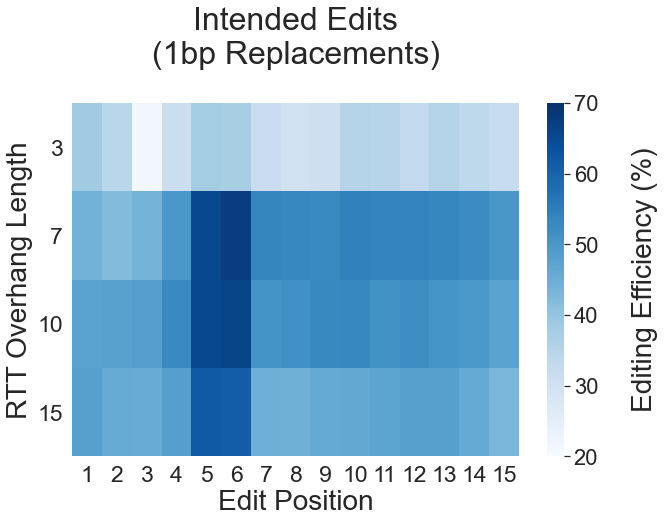

In [55]:
sn.set(font_scale=2)

RToverhanglengthlist = [3,7,10,15]
editpositionlist = list(range(0,15))
RTheatmaparray = np.empty([4,15])
for editpositionindex, editposition in enumerate(editpositionlist):
    for RToverhangindex, RToverhang in enumerate(RToverhanglengthlist):
        editrates = templatedf[(templatedf['Correction_Type'] == 'Replacement')&(templatedf['RToverhanglength'] == RToverhang)&(templatedf['Editing_Position'] ==editposition)]['averageedited']
        RTheatmaparray[RToverhangindex, editpositionindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(10, 6.5))
ax.set_title('Intended Edits\n(1bp Replacements)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Blues", as_cmap=True)
ax = sn.heatmap(RTheatmaparray,cmap=cmap,cbar_kws={'label': '\nEditing Efficiency (%)'},vmin=20, vmax=70)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = list(range(1,16))
plt.xticks(np.arange(len(editpositionlist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = ['3','7','10','15']
plt.yticks(np.arange(4) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Edit Position', fontsize=28)
ax.set_ylabel('RTT Overhang Length', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'rtoverhanglength_editpos_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

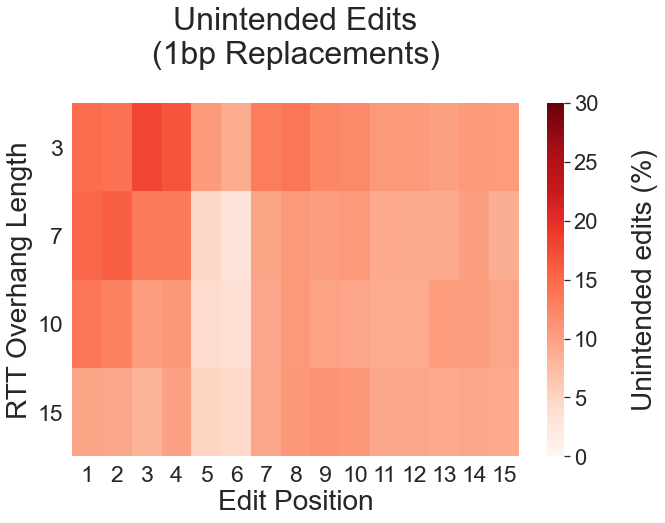

In [56]:
sn.set(font_scale=2)

RToverhanglengthlist = [3,7,10,15]
editpositionlist = list(range(0,15))
RTheatmaparray = np.empty([4,15])
for editpositionindex, editposition in enumerate(editpositionlist):
    for RToverhangindex, RToverhang in enumerate(RToverhanglengthlist):
        editrates = templatedf[(templatedf['Correction_Type'] == 'Replacement')&(templatedf['RToverhanglength'] == RToverhang)&(templatedf['Editing_Position'] ==editposition)]['averageindel']
        RTheatmaparray[RToverhangindex, editpositionindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(10, 6.5))
ax.set_title('Unintended Edits\n(1bp Replacements)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Reds", as_cmap=True)
ax = sn.heatmap(RTheatmaparray,cmap=cmap,cbar_kws={'label': '\nUnintended edits (%)'},vmin=0,vmax=30)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = list(range(1,16))
plt.xticks(np.arange(len(editpositionlist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = ['3','7','10','15']
plt.yticks(np.arange(4) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Edit Position', fontsize=28)
ax.set_ylabel('RTT Overhang Length', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'indelsReplacement_rtoverhanglength_editpos_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

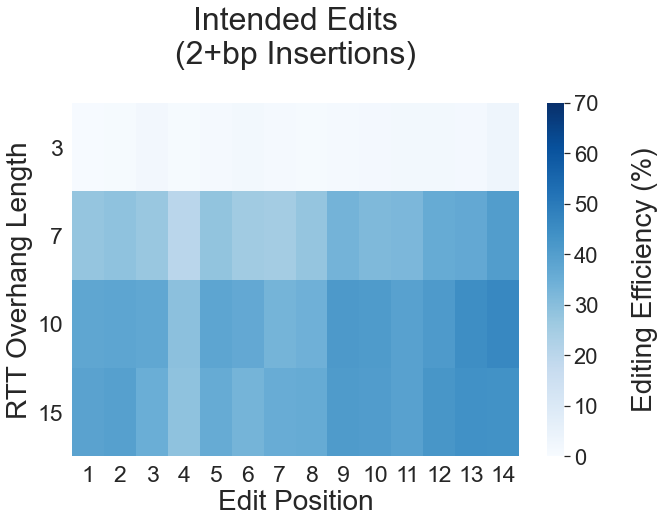

In [57]:
sn.set(font_scale=2)

RToverhanglengthlist = [3,7,10,15]
editpositionlist = list(range(0,14))
RTheatmaparray = np.empty([4,14])
for editpositionindex, editposition in enumerate(editpositionlist):
    for RToverhangindex, RToverhang in enumerate(RToverhanglengthlist):
        editrates = templatedf[(templatedf['Correction_Type'] == 'Insertion')&(templatedf['Correction_Length'] >1)&(templatedf['RToverhanglength'] == RToverhang)&(templatedf['Editing_Position'] ==editposition)]['averageedited']
        RTheatmaparray[RToverhangindex, editpositionindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(10, 6.5))
ax.set_title('Intended Edits\n(2+bp Insertions)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Blues", as_cmap=True)
ax = sn.heatmap(RTheatmaparray,cmap=cmap,cbar_kws={'label': '\nEditing Efficiency (%)'},vmin=0,vmax=70)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = list(range(1,15))
plt.xticks(np.arange(len(editpositionlist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = ['3','7','10','15']
plt.yticks(np.arange(4) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Edit Position', fontsize=28)
ax.set_ylabel('RTT Overhang Length', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup6_EditPosition_RToverhang_Deletion_Insertion\\'
plt.savefig(figurepath+'rtoverhanglength_insertions_editpos_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

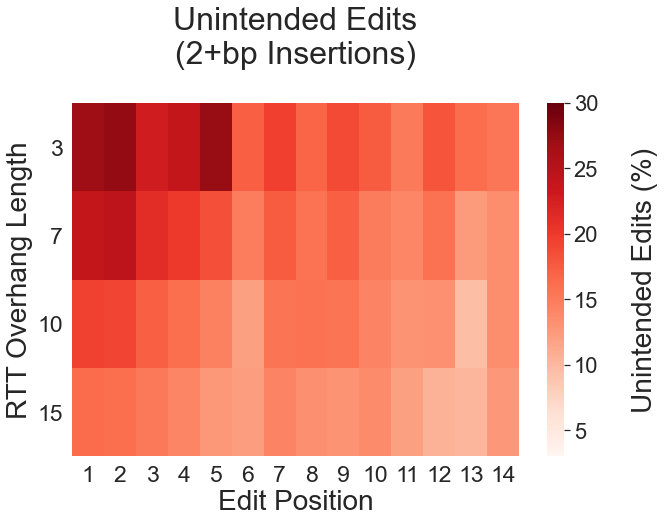

In [58]:
sn.set(font_scale=2)

RToverhanglengthlist = [3,7,10,15]
editpositionlist = list(range(0,14))
RTheatmaparray = np.empty([4,14])
for editpositionindex, editposition in enumerate(editpositionlist):
    for RToverhangindex, RToverhang in enumerate(RToverhanglengthlist):
        editrates = templatedf[(templatedf['Correction_Type'] == 'Insertion')&(templatedf['Correction_Length'] >1)&(templatedf['RToverhanglength'] == RToverhang)&(templatedf['Editing_Position'] ==editposition)]['averageindel']
        RTheatmaparray[RToverhangindex, editpositionindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(10, 6.5))
ax.set_title('Unintended Edits\n(2+bp Insertions)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Reds", as_cmap=True)
ax = sn.heatmap(RTheatmaparray,cmap=cmap,cbar_kws={'label': '\nUnintended Edits (%)'},vmin=3,vmax=30)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = list(range(1,15))
plt.xticks(np.arange(len(editpositionlist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = ['3','7','10','15']
plt.yticks(np.arange(4) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Edit Position', fontsize=28)
ax.set_ylabel('RTT Overhang Length', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup6_EditPosition_RToverhang_Deletion_Insertion\\'
plt.savefig(figurepath+'indelsinsertion2plus_rtoverhanglength_editpos_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

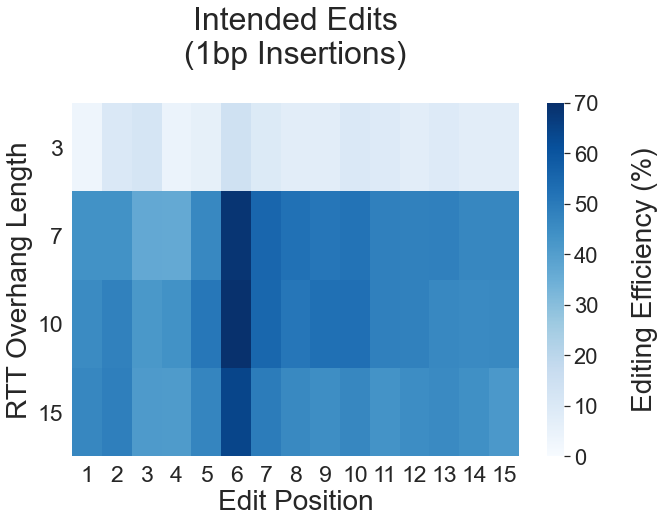

In [59]:
sn.set(font_scale=2)

RToverhanglengthlist = [3,7,10,15]
editpositionlist = list(range(0,15))
RTheatmaparray = np.empty([4,15])
for editpositionindex, editposition in enumerate(editpositionlist):
    for RToverhangindex, RToverhang in enumerate(RToverhanglengthlist):
        editrates = templatedf[(templatedf['Correction_Type'] == 'Insertion')&(templatedf['Correction_Length'] == 1)&(templatedf['RToverhanglength'] == RToverhang)&(templatedf['Editing_Position'] ==editposition)]['averageedited']
        RTheatmaparray[RToverhangindex, editpositionindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(10, 6.5))
ax.set_title('Intended Edits\n(1bp Insertions)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Blues", as_cmap=True)
ax = sn.heatmap(RTheatmaparray,cmap=cmap,cbar_kws={'label': '\nEditing Efficiency (%)'},vmin=0,vmax=70)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = list(range(1,16))
plt.xticks(np.arange(len(editpositionlist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = ['3','7','10','15']
plt.yticks(np.arange(4) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Edit Position', fontsize=28)
ax.set_ylabel('RTT Overhang Length', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup6_EditPosition_RToverhang_Deletion_Insertion\\'
plt.savefig(figurepath+'rtoverhanglength_insertions1bp_editpos_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

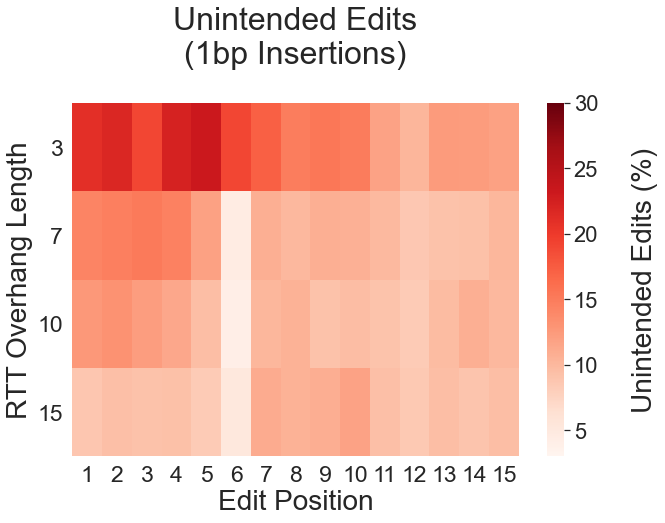

In [60]:
sn.set(font_scale=2)

RToverhanglengthlist = [3,7,10,15]
editpositionlist = list(range(0,15))
RTheatmaparray = np.empty([4,15])
for editpositionindex, editposition in enumerate(editpositionlist):
    for RToverhangindex, RToverhang in enumerate(RToverhanglengthlist):
        editrates = templatedf[(templatedf['Correction_Type'] == 'Insertion')&(templatedf['Correction_Length'] == 1)&(templatedf['RToverhanglength'] == RToverhang)&(templatedf['Editing_Position'] ==editposition)]['averageindel']
        RTheatmaparray[RToverhangindex, editpositionindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(10, 6.5))
ax.set_title('Unintended Edits\n(1bp Insertions)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Reds", as_cmap=True)
ax = sn.heatmap(RTheatmaparray,cmap=cmap,cbar_kws={'label': '\nUnintended Edits (%)'},vmin=3,vmax=30)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = list(range(1,16))
plt.xticks(np.arange(len(editpositionlist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = ['3','7','10','15']
plt.yticks(np.arange(4) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Edit Position', fontsize=28)
ax.set_ylabel('RTT Overhang Length', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup6_EditPosition_RToverhang_Deletion_Insertion\\'
plt.savefig(figurepath+'indelsinsertion1bp_rtoverhanglength_editpos_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

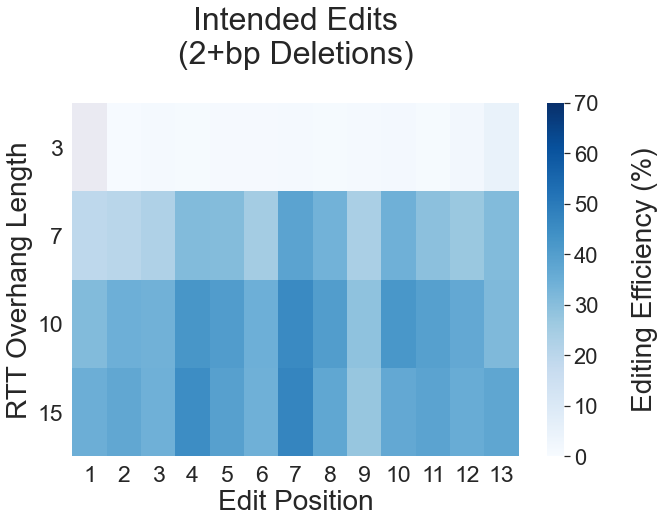

In [61]:
sn.set(font_scale=2)

RToverhanglengthlist = [3,7,10,15]
editpositionlist = list(range(0,13))
RTheatmaparray = np.empty([4,13])
for editpositionindex, editposition in enumerate(editpositionlist):
    for RToverhangindex, RToverhang in enumerate(RToverhanglengthlist):
        editrates = templatedf[(templatedf['Correction_Type'] == 'Deletion')&(templatedf['Correction_Length'] > 1)&(templatedf['RToverhanglength'] == RToverhang)&(templatedf['Editing_Position'] ==editposition)]['averageedited']
        RTheatmaparray[RToverhangindex, editpositionindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(10, 6.5))
ax.set_title('Intended Edits\n(2+bp Deletions)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Blues", as_cmap=True)
ax = sn.heatmap(RTheatmaparray,cmap=cmap,cbar_kws={'label': '\nEditing Efficiency (%)'},vmin=0,vmax=70)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = list(range(1,14))
plt.xticks(np.arange(len(editpositionlist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = ['3','7','10','15']
plt.yticks(np.arange(4) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Edit Position', fontsize=28)
ax.set_ylabel('RTT Overhang Length', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup6_EditPosition_RToverhang_Deletion_Insertion\\'
plt.savefig(figurepath+'rtoverhanglength_deletions_editpos_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

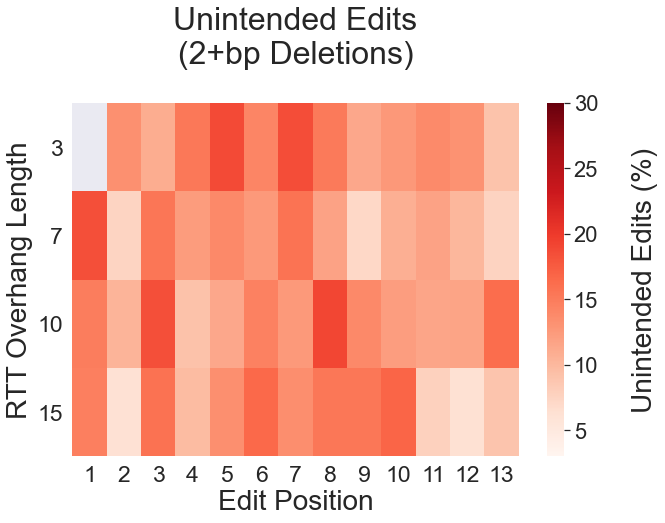

In [62]:
sn.set(font_scale=2)

RToverhanglengthlist = [3,7,10,15]
editpositionlist = list(range(0,13))
RTheatmaparray = np.empty([4,13])
for editpositionindex, editposition in enumerate(editpositionlist):
    for RToverhangindex, RToverhang in enumerate(RToverhanglengthlist):
        editrates = templatedf[(templatedf['Correction_Type'] == 'Deletion')&(templatedf['Correction_Length'] > 1)&(templatedf['RToverhanglength'] == RToverhang)&(templatedf['Editing_Position'] ==editposition)]['averageindel']
        RTheatmaparray[RToverhangindex, editpositionindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(10, 6.5))
ax.set_title('Unintended Edits\n(2+bp Deletions)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Reds", as_cmap=True)
ax = sn.heatmap(RTheatmaparray,cmap=cmap,cbar_kws={'label': '\nUnintended Edits (%)'},vmin=3,vmax=30)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = list(range(1,14))
plt.xticks(np.arange(len(editpositionlist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = ['3','7','10','15']
plt.yticks(np.arange(4) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Edit Position', fontsize=28)
ax.set_ylabel('RTT Overhang Length', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup6_EditPosition_RToverhang_Deletion_Insertion\\'
plt.savefig(figurepath+'indelsdeletion2plus_rtoverhanglength_editpos_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

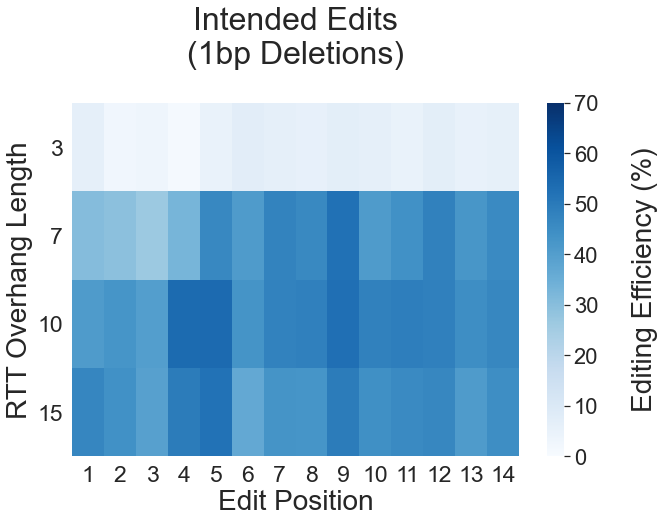

In [63]:
sn.set(font_scale=2)

RToverhanglengthlist = [3,7,10,15]
editpositionlist = list(range(0,14))
RTheatmaparray = np.empty([4,14])
for editpositionindex, editposition in enumerate(editpositionlist):
    for RToverhangindex, RToverhang in enumerate(RToverhanglengthlist):
        editrates = templatedf[(templatedf['Correction_Type'] == 'Deletion')&(templatedf['Correction_Length'] == 1)&(templatedf['RToverhanglength'] == RToverhang)&(templatedf['Editing_Position'] ==editposition)]['averageedited']
        RTheatmaparray[RToverhangindex, editpositionindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(10, 6.5))
ax.set_title('Intended Edits\n(1bp Deletions)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Blues", as_cmap=True)
ax = sn.heatmap(RTheatmaparray,cmap=cmap,cbar_kws={'label': '\nEditing Efficiency (%)'},vmin=0,vmax=70)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = list(range(1,15))
plt.xticks(np.arange(len(editpositionlist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = ['3','7','10','15']
plt.yticks(np.arange(4) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Edit Position', fontsize=28)
ax.set_ylabel('RTT Overhang Length', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup6_EditPosition_RToverhang_Deletion_Insertion\\'
plt.savefig(figurepath+'rtoverhanglength_deletions1bp_editpos_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

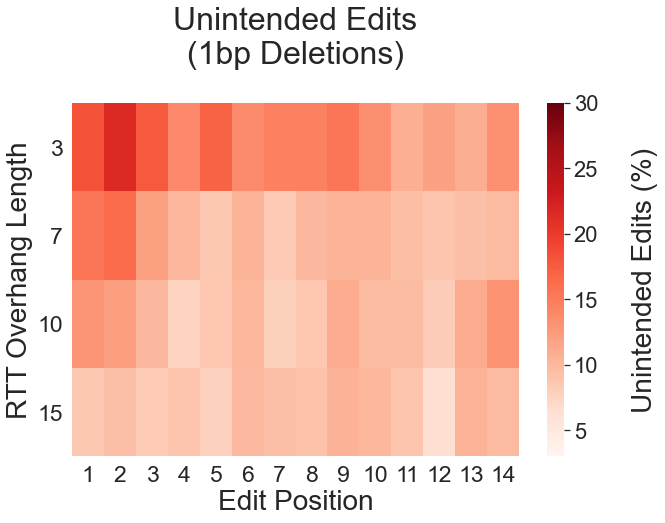

In [64]:
sn.set(font_scale=2)

RToverhanglengthlist = [3,7,10,15]
editpositionlist = list(range(0,14))
RTheatmaparray = np.empty([4,14])
for editpositionindex, editposition in enumerate(editpositionlist):
    for RToverhangindex, RToverhang in enumerate(RToverhanglengthlist):
        editrates = templatedf[(templatedf['Correction_Type'] == 'Deletion')&(templatedf['Correction_Length'] ==1)&(templatedf['RToverhanglength'] == RToverhang)&(templatedf['Editing_Position'] ==editposition)]['averageindel']
        RTheatmaparray[RToverhangindex, editpositionindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(10, 6.5))
ax.set_title('Unintended Edits\n(1bp Deletions)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Reds", as_cmap=True)
ax = sn.heatmap(RTheatmaparray,cmap=cmap,cbar_kws={'label': '\nUnintended Edits (%)'},vmin=3,vmax=30)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = list(range(1,15))
plt.xticks(np.arange(len(editpositionlist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = ['3','7','10','15']
plt.yticks(np.arange(4) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Edit Position', fontsize=28)
ax.set_ylabel('RTT Overhang Length', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup6_EditPosition_RToverhang_Deletion_Insertion\\'
plt.savefig(figurepath+'indelsdeletion1bp_rtoverhanglength_editpos_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

In [65]:
len(templatedf[(templatedf['Correction_Type'] == 'Replacement')])

57920

In [66]:
len(templatedf[(templatedf['Correction_Type'] == 'Insertion')])

28420

In [67]:
len(templatedf[(templatedf['Correction_Type'] == 'Deletion')])

6083

In [68]:
len(templatedf)

92423

## Editing type vs Editing

In [152]:
replacement = templatedf[templatedf['Correction_Type'] == 'Replacement']
insertion = templatedf[templatedf['Correction_Type'] == 'Insertion']
deletion = templatedf[templatedf['Correction_Type'] == 'Deletion']

editingtypedata = [replacement['averageedited'], insertion['averageedited'], deletion['averageedited']]
unintendeditingtypedata = [replacement['averageindel'], insertion['averageindel'], deletion['averageindel']]
insertionlengths = insertion['ReferenceAllele'].apply(lambda x: len(x))
deletionlengths = deletion['AlternateAllele'].apply(lambda x: len(x))
print('Max insertion length:', max(insertionlengths))
print('Max deletion length:', max(deletionlengths))
print('Max insertion length:', max(insertion['Correction_Length']))
print('Max deletion length:', max(deletion['Correction_Length']))


Max insertion length: 24
Max deletion length: 13
Max insertion length: 24
Max deletion length: 13


In [154]:
editingtypedata

[11       58.974300
 12       44.566968
 13       63.689458
 14       62.683709
 15       61.014068
            ...    
 87239    65.294525
 87240    32.251598
 87241    38.533059
 87242    56.212037
 87243    56.621565
 Name: averageedited, Length: 57920, dtype: float64,
 0         0.000000
 1         0.000000
 2         0.000000
 3         0.000000
 4        53.227332
            ...    
 92418    56.298183
 92419    66.750586
 92420     0.170940
 92421    42.116610
 92422    51.332990
 Name: averageedited, Length: 28420, dtype: float64,
 65        0.000000
 66       10.468704
 67        9.465289
 68        6.718597
 182       8.329524
            ...    
 83764    63.222989
 83765     5.141081
 83766    62.999674
 83767    59.619848
 83768    44.828423
 Name: averageedited, Length: 6083, dtype: float64]

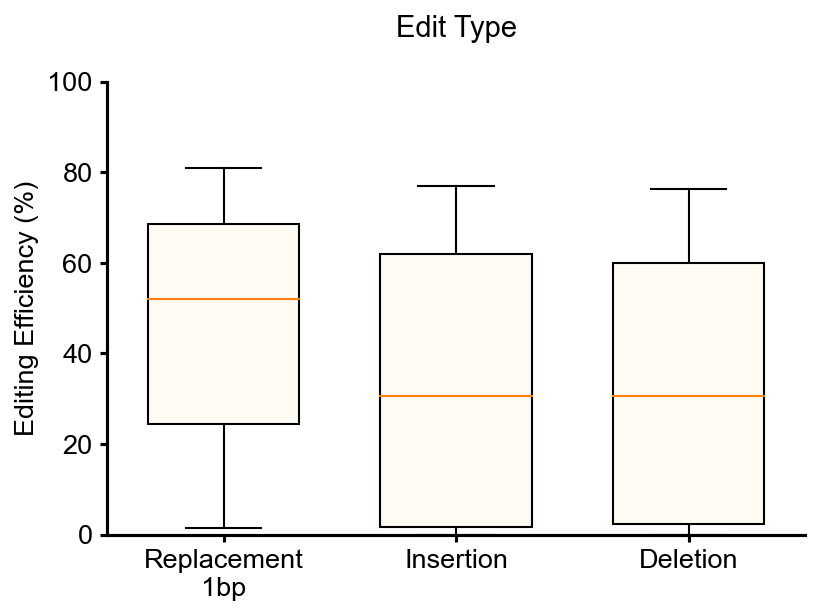

In [153]:
fig2, ax2 = plt.subplots(dpi=150)
ax2.set_title('Edit Type\n', fontsize=titlesize)
ax2.boxplot(editingtypedata, showfliers = False,**boxplot_kwargs)
ax2.set_xticklabels(['Replacement\n1bp', 'Insertion', 
                    'Deletion'])
#ax2.set_xlabel('Editing Type', fontsize=16)
ax2.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax2.tick_params(axis='x', labelsize= lsize, width=1.5)
ax2.tick_params(axis='y', labelsize= lsize, width=1.5)
ax2.set_ylim(0, 100)
ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'edit_type.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
  
# show plot
plt.show()

### Compare different PAM motifs with editing rates

In [9]:
templatedf['GGNN_PAM'] = templatedf['NGGNN_PAM'].apply(lambda x: x[1:])
ggnnlist = list(templatedf['GGNN_PAM'].unique())

namelist = []
medianlist = []
stddevlist = []
for type in ['Replacement','Insertion','Deletion']:
    for pam in ggnnlist:
        namelist.append(type+'_'+pam)
        median = templatedf[(templatedf['Correction_Type'] == type)& (templatedf['GGNN_PAM'] == pam)]['averageedited'].median()
        stddev = templatedf[(templatedf['Correction_Type'] == type)& (templatedf['GGNN_PAM'] == pam)]['averageedited'].std()
        medianlist.append(median)
        stddevlist.append(stddev)
    

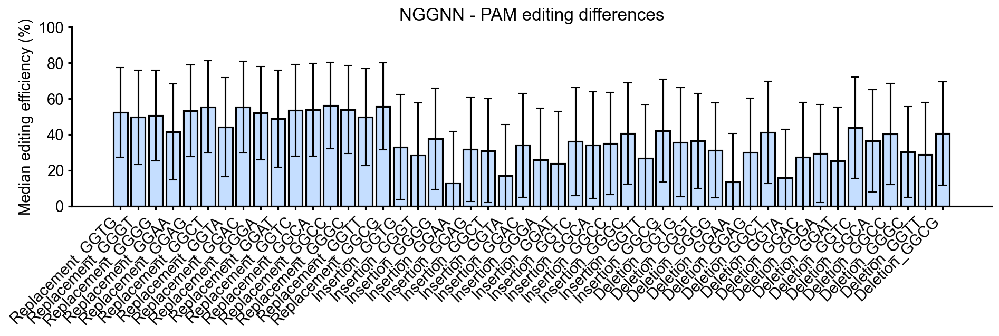

In [10]:
fig1, ax1 = plt.subplots(figsize = (15,3),dpi=150,sharex=True)
ax1.set_title('NGGNN - PAM editing differences', fontsize=titlesize)
ax1.bar(namelist,medianlist,yerr=stddevlist, **bar_kwargs)
ax1.set_xticks(range(len(namelist)))
ax1.set_xticklabels(namelist, ha="right")
ax1.set_ylabel('Median editing efficiency (%)', fontsize=lsize)
ax1.tick_params(axis='x', labelsize= lsize, width=1.5, rotation=45)
ax1.tick_params(axis='y', labelsize= lsize, width=1.5)
ax1.set_ylim(0, 100)
ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)

In [11]:
replacement = templatedf[(templatedf['Correction_Type'] == 'Replacement')& (templatedf['GGNN_PAM'] != 'GGCG')]
insertion = templatedf[(templatedf['Correction_Type'] == 'Insertion') & (templatedf['Correction_Length'] <=15) & (templatedf['GGNN_PAM'] != 'GGCG')]
deletion = templatedf[(templatedf['Correction_Type'] == 'Deletion') & (templatedf['Correction_Length'] <=11) & (templatedf['GGNN_PAM'] != 'GGCG')]

editingtypedata = [replacement['averageedited'], insertion['averageedited'], deletion['averageedited']]
unintendeditingtypedata = [replacement['averageindel'], insertion['averageindel'], deletion['averageindel']]
insertionlengths = insertion['ReferenceAllele'].apply(lambda x: len(x))
deletionlengths = deletion['AlternateAllele'].apply(lambda x: len(x))
print('Max insertion length:', max(insertionlengths))
print('Max deletion length:', max(deletionlengths))
print('Max insertion length:', max(insertion['Correction_Length']))
print('Max deletion length:', max(deletion['Correction_Length']))

print('Median replacement:', replacement['averageedited'].median())
print('Median deletion:', deletion['averageedited'].median())
print('Median insertion:', insertion['averageedited'].median())

Max insertion length: 15
Max deletion length: 11
Max insertion length: 15
Max deletion length: 11
Median replacement: 51.800900889828256
Median deletion: 30.301761837867044
Median insertion: 30.275892039372053


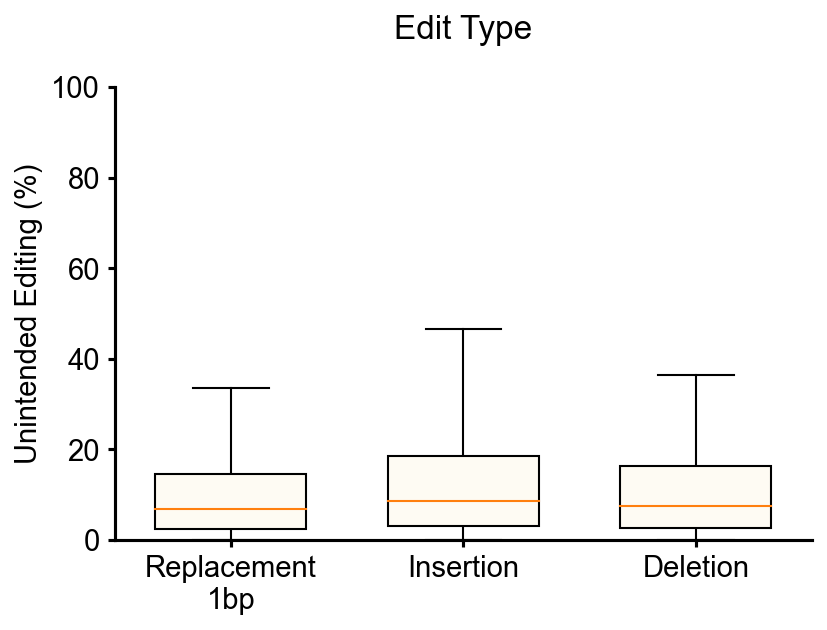

In [12]:
fig2, ax2 = plt.subplots(dpi=150)
ax2.set_title('Edit Type\n', fontsize=titlesize)
ax2.boxplot(unintendeditingtypedata, showfliers = False, **boxplot_kwargs)
ax2.set_xticklabels(['Replacement\n1bp', 'Insertion', 
                    'Deletion'])
#ax2.set_xlabel('Editing Type', fontsize=16)
ax2.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax2.tick_params(axis='x', labelsize= lsize, width=1.5)
ax2.tick_params(axis='y', labelsize= lsize, width=1.5)
ax2.set_ylim(0, 100)
ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'edit_type_unintendedediting.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
  
# show plot
plt.show()

In [13]:
print(f'Replacement median: {round(replacement.median())}')
print(f'Insertion median: {round(insertion.median())}')
print(f'Deletion median: {round(deletion.median())}')

Replacement median: Unnamed: 0          48532.0
Unnamed: 0.1        48532.0
PBSlength              13.0
RToverhanglength        7.0
RTlength               16.0
                     ...   
original_base_mt        2.0
edited_base_mt          2.0
bestoverhang           10.0
Namenr               6500.0
uniqueindex         36756.0
Length: 147, dtype: float64
Insertion median: Unnamed: 0          95102.0
Unnamed: 0.1        95102.0
PBSlength              13.0
RToverhanglength        7.0
RTlength               17.0
                     ...   
original_base_mt        0.0
edited_base_mt          4.0
bestoverhang           10.0
Namenr               6668.0
uniqueindex         73141.0
Length: 147, dtype: float64
Deletion median: Unnamed: 0          64330.0
Unnamed: 0.1        64330.0
PBSlength              13.0
RToverhanglength        7.0
RTlength               15.0
                     ...   
original_base_mt        4.0
edited_base_mt          0.0
bestoverhang           10.0
Namenr               

## Insertion length vs editing

21882
2934
1103
2501


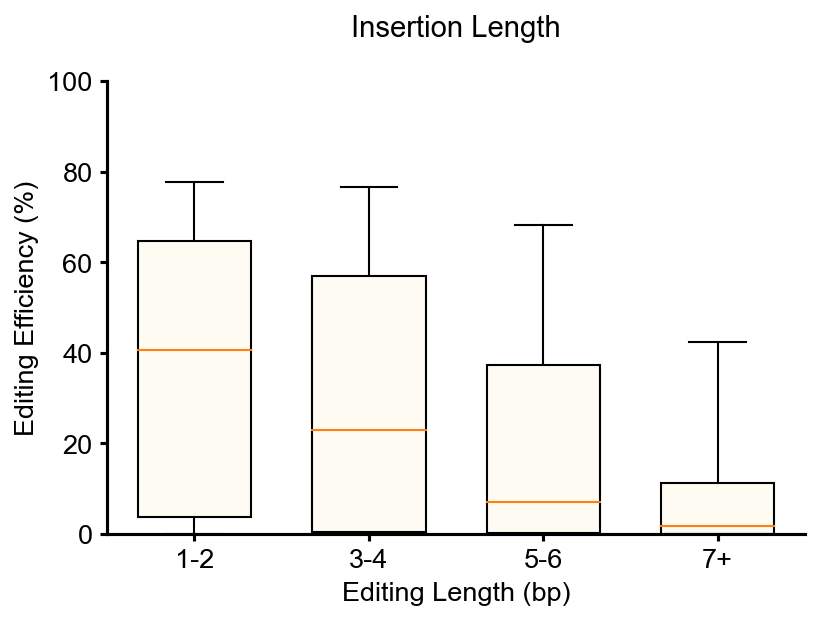

In [155]:
insertiondf = templatedf[templatedf['Correction_Type'] == 'Insertion']
length1_2 = insertiondf[(insertiondf['Correction_Length'] > 0)&(insertiondf['Correction_Length'] <= 2)]['averageedited']
length3_4 = insertiondf[(insertiondf['Correction_Length'] > 2)&(insertiondf['Correction_Length'] <= 4)]['averageedited']
length5_6 = insertiondf[(insertiondf['Correction_Length'] > 4)&(insertiondf['Correction_Length'] <= 6)]['averageedited']
length7andmore = insertiondf[insertiondf['Correction_Length'] >=7]['averageedited']
print(len(length1_2))
print(len(length3_4))
print(len(length5_6))
print(len(length7andmore))

editinglengthdata = [length1_2, length3_4, length5_6,length7andmore]

fig2, ax3 = plt.subplots(dpi=150)
ax3.set_title('Insertion Length\n', fontsize=titlesize)
ax3.boxplot(editinglengthdata, showfliers = False, **boxplot_kwargs)
ax3.set_xticklabels(['1-2', '3-4', '5-6','7+'])
ax3.set_xlabel('Editing Length (bp)', fontsize=lsize)
ax3.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax3.tick_params(axis='x', labelsize= lsize, width=1.5)
ax3.tick_params(axis='y', labelsize= lsize, width=1.5)
ax3.set_ylim(0, 100)
ax3.spines['right'].set_visible(False)
ax3.spines['top'].set_visible(False)

figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'insertionlength_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
# show plot
plt.show()

## Unintended Editing vs. Insertion Length

21882
2934
1103
2501


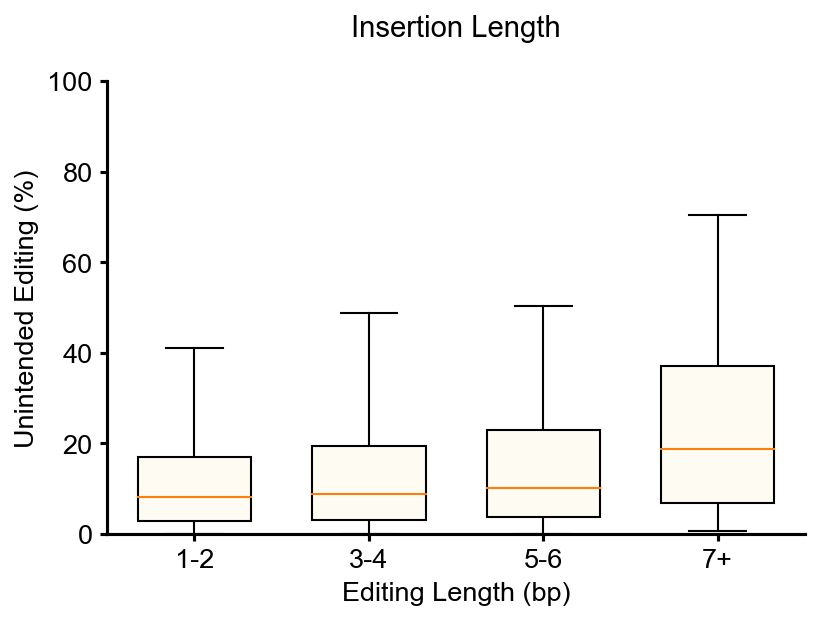

In [156]:
insertiondf = templatedf[templatedf['Correction_Type'] == 'Insertion']
length1_2 = insertiondf[(insertiondf['Correction_Length'] > 0)&(insertiondf['Correction_Length'] <= 2)]['averageindel']
length3_4 = insertiondf[(insertiondf['Correction_Length'] > 2)&(insertiondf['Correction_Length'] <= 4)]['averageindel']
length5_6 = insertiondf[(insertiondf['Correction_Length'] > 4)&(insertiondf['Correction_Length'] <= 6)]['averageindel']
length7andmore = insertiondf[insertiondf['Correction_Length'] >=7]['averageindel']

print(len(length1_2))
print(len(length3_4))
print(len(length5_6))
print(len(length7andmore))

editinglengthdata = [length1_2, length3_4, length5_6,length7andmore]

fig2, ax3 = plt.subplots(dpi=150)
ax3.set_title('Insertion Length\n', fontsize=titlesize)
ax3.boxplot(editinglengthdata, showfliers = False, **boxplot_kwargs)
ax3.set_xticklabels(['1-2', '3-4', '5-6','7+'])
ax3.set_xlabel('Editing Length (bp)', fontsize=lsize)
ax3.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax3.tick_params(axis='x', labelsize= lsize, width=1.5)
ax3.tick_params(axis='y', labelsize= lsize, width=1.5)
ax3.set_ylim(0, 100)
ax3.spines['right'].set_visible(False)
ax3.spines['top'].set_visible(False)

figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'insertionlength_unintended_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
# show plot
plt.show()

## Deletion length vs editing

5457
459
115
52


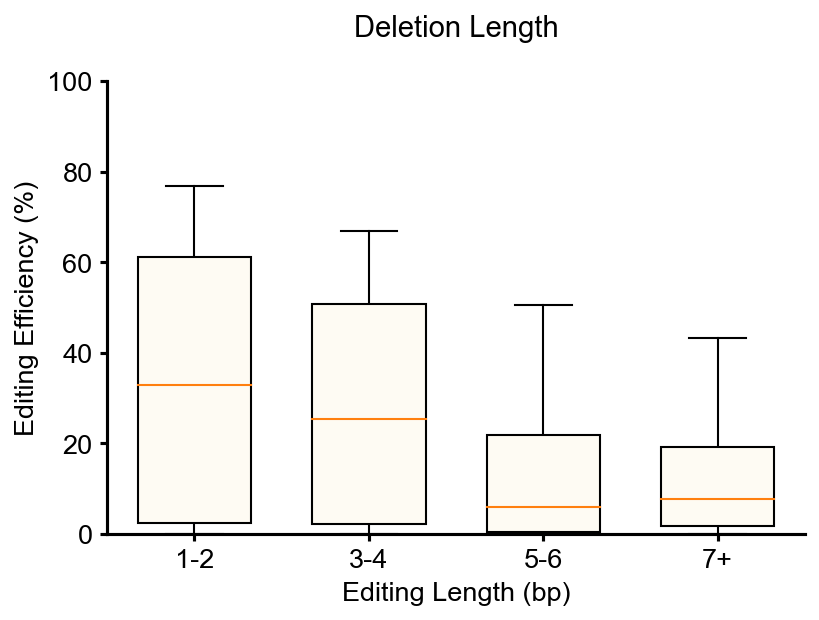

In [157]:
deletiondf = templatedf[templatedf['Correction_Type'] == 'Deletion']
#length1 = deletiondf[deletiondf['Correction_Length'] == 1]['averageedited']
#length2 = deletiondf[deletiondf['Correction_Length'] == 2]['averageedited']
#length3 = deletiondf[deletiondf['Correction_Length'] == 3]['averageedited']
#length4 = deletiondf[deletiondf['Correction_Length'] == 4]['averageedited']
#length5 = deletiondf[deletiondf['Correction_Length'] == 5]['averageedited']
#length6andmore = deletiondf[deletiondf['Correction_Length'] > 6]['averageedited']

length1_2 = deletiondf[(deletiondf['Correction_Length'] > 0)&(deletiondf['Correction_Length'] <= 2)]['averageedited']
length3_4 = deletiondf[(deletiondf['Correction_Length'] > 2)&(deletiondf['Correction_Length'] <= 4)]['averageedited']
length5_6 = deletiondf[(deletiondf['Correction_Length'] > 4)&(deletiondf['Correction_Length'] <= 6)]['averageedited']
#length7_8 = deletiondf[(deletiondf['Correction_Length'] > 6)&(deletiondf['Correction_Length'] <= 8)]['averageedited']
#length9_10 = deletiondf[(deletiondf['Correction_Length'] > 8)&(deletiondf['Correction_Length'] <= 10)]['averageedited']
length7andmore = deletiondf[deletiondf['Correction_Length'] >=7]['averageedited']

print(len(length1_2))
print(len(length3_4))
print(len(length5_6))
print(len(length7andmore))

editinglengthdata = [length1_2, length3_4, length5_6,length7andmore]

#editinglengthdata = [length1, length2, length3,length4,length5,length6andmore]

fig4, ax4 = plt.subplots(dpi=150)
ax4.set_title('Deletion Length\n', fontsize=titlesize)
ax4.boxplot(editinglengthdata, showfliers = False, **boxplot_kwargs)
#ax4.set_xticklabels(['1', '2', '3', '4','5','6+'])
ax4.set_xticklabels(['1-2', '3-4', '5-6','7+'])
ax4.set_xlabel('Editing Length (bp)', fontsize=lsize)
ax4.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax4.tick_params(axis='x', labelsize= lsize, width=1.5)
ax4.tick_params(axis='y', labelsize= lsize, width=1.5)
ax4.set_ylim(0, 100)
ax4.spines['right'].set_visible(False)
ax4.spines['top'].set_visible(False)

figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'deletionlength_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
# show plot
plt.show()

## Unintended Editing vs. Deletion Length

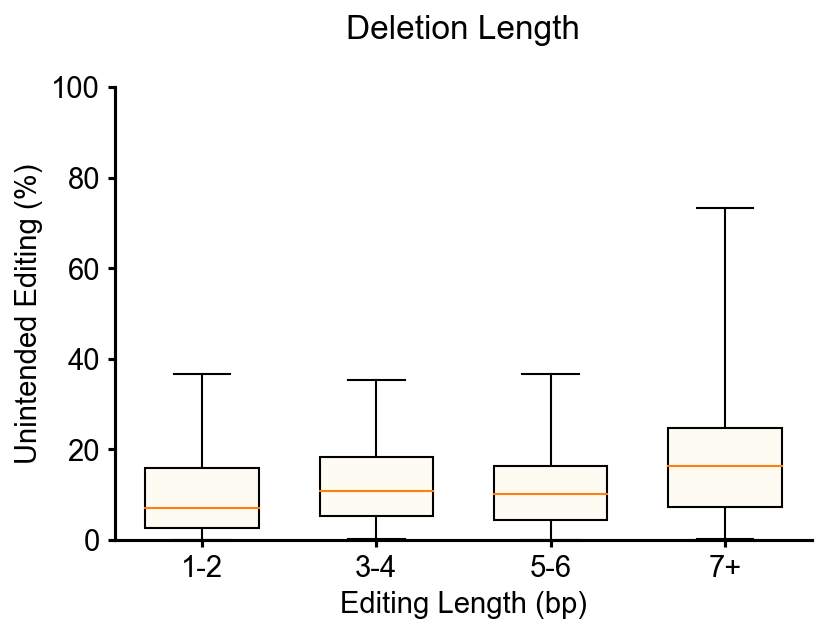

In [18]:
deletiondf = templatedf[templatedf['Correction_Type'] == 'Deletion']

length1_2 = deletiondf[(deletiondf['Correction_Length'] > 0)&(deletiondf['Correction_Length'] <= 2)]['averageindel']
length3_4 = deletiondf[(deletiondf['Correction_Length'] > 2)&(deletiondf['Correction_Length'] <= 4)]['averageindel']
length5_6 = deletiondf[(deletiondf['Correction_Length'] > 4)&(deletiondf['Correction_Length'] <= 6)]['averageindel']
length7andmore = deletiondf[deletiondf['Correction_Length'] >=7]['averageindel']

editinglengthdata = [length1_2, length3_4, length5_6,length7andmore]

fig4, ax4 = plt.subplots(dpi=150)
ax4.set_title('Deletion Length\n', fontsize=titlesize)
ax4.boxplot(editinglengthdata, showfliers = False, **boxplot_kwargs)
#ax4.set_xticklabels(['1', '2', '3', '4','5','6+'])
ax4.set_xticklabels(['1-2', '3-4', '5-6','7+'])
ax4.set_xlabel('Editing Length (bp)', fontsize=lsize)
ax4.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax4.tick_params(axis='x', labelsize= lsize, width=1.5)
ax4.tick_params(axis='y', labelsize= lsize, width=1.5)
ax4.set_ylim(0, 100)
ax4.spines['right'].set_visible(False)
ax4.spines['top'].set_visible(False)

figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'deletionlength_unintended_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
# show plot
plt.show()

## Replacement bases vs efficiency

In [175]:
basechangelist = [('A','G'), ('A','C'),('A','T'),('C','A'),('C','G'),('C','T'),('T','A'),('T','G'),('T','C'),('G','A'),('G','C'),('G','T')]
repdata=[]
replacementdict = {}
for basechange in basechangelist:
    df = templatedf[(templatedf['AlternateAllele'] == basechange[0]) & (templatedf['ReferenceAllele'] == basechange[1]) & (templatedf['Target_Strand'] == "'Fw'")]['averageedited']
    dfrev = templatedf[(templatedf['AlternateAllele'] == str(Seq(basechange[0]).reverse_complement())) & (templatedf['ReferenceAllele'] == str(Seq(basechange[1]).reverse_complement())) & (templatedf['Target_Strand'] == "'Rv'")]['averageedited']
    finaldf = df.append(dfrev)
    repdata.append(finaldf)
    replacementdict[basechange[0]+'to'+basechange[1]] = finaldf

mediandata = [x.median() for x in repdata]
labels= ['AtoG', 'AtoC', 'AtoT','CtoA','CtoG','CtoT','TtoA','TtoG','TtoC','GtoA','GtoC','GtoT']
sortdf = pd.DataFrame()
sortdf['label']=labels
sortdf['mediandata']=mediandata
sortdf.sort_values(by='mediandata', ascending=False, inplace=True)
labels=sortdf['label']

repdata=[]
for ind, row in sortdf.iterrows():
    repdata.append(replacementdict[row['label']])

In [176]:
for x in repdata:
    print(len(x))

4482
5892
6576
3622
5252
3768
4868
4644
4864
5767
4832
3353


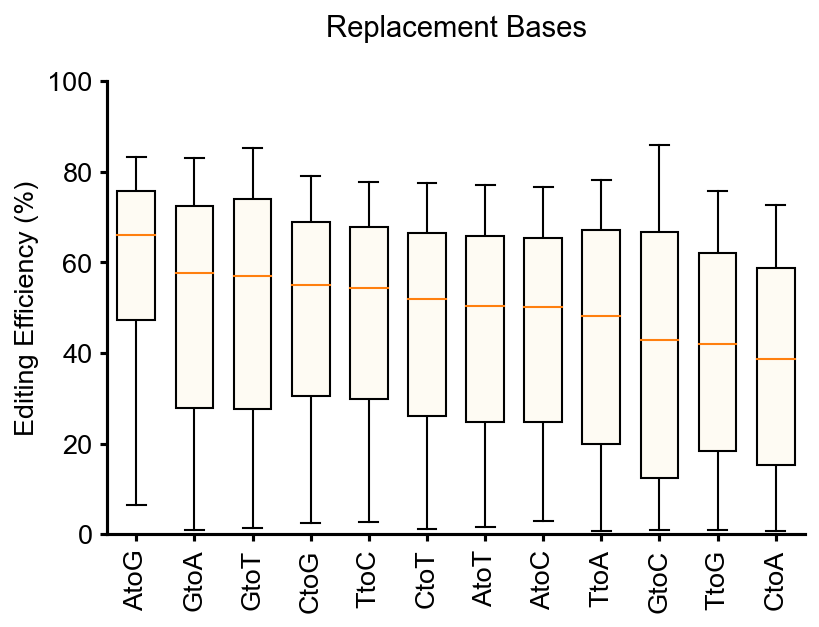

In [177]:
fig5, ax5 = plt.subplots(figsize=(6,4),dpi=150)
ax5.set_title('Replacement Bases\n', fontsize=titlesize)

ax5.boxplot(repdata,showfliers = False, **boxplot_kwargs)
ax5.set_xticklabels(labels)
#ax5.set_xlabel('\nEdit Type', fontsize=lsize)
ax5.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax5.tick_params(axis='x', labelsize= lsize, width=1.5)
ax5.tick_params(axis='y', labelsize= lsize, width=1.5)
plt.xticks(rotation=90)
ax5.set_ylim(0, 100)
ax5.spines['right'].set_visible(False)
ax5.spines['top'].set_visible(False)
# show plot
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'replacementbases_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

## Replacement bases vs unintended editing

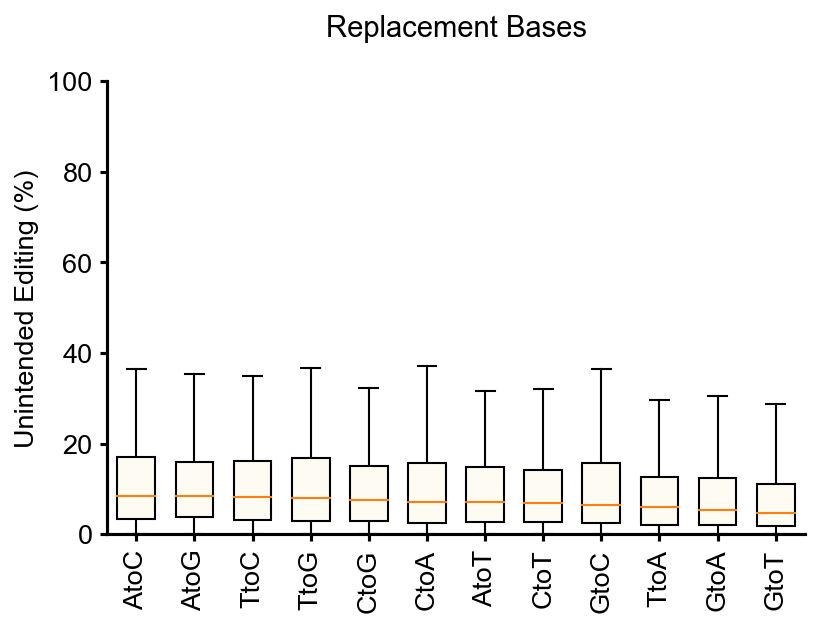

In [178]:
basechangelist = [('A','G'), ('A','C'),('A','T'),('C','A'),('C','G'),('C','T'),('T','A'),('T','G'),('T','C'),('G','A'),('G','C'),('G','T')]
repdata=[]
replacementdict = {}
for basechange in basechangelist:
    df = templatedf[(templatedf['AlternateAllele'] == basechange[0]) & (templatedf['ReferenceAllele'] == basechange[1]) & (templatedf['Target_Strand'] == "'Fw'")]['averageindel']
    dfrev = templatedf[(templatedf['AlternateAllele'] == str(Seq(basechange[0]).reverse_complement())) & (templatedf['ReferenceAllele'] == str(Seq(basechange[1]).reverse_complement())) & (templatedf['Target_Strand'] == "'Rv'")]['averageindel']
    finaldf = df.append(dfrev)
    repdata.append(finaldf)
    replacementdict[basechange[0]+'to'+basechange[1]] = finaldf

mediandata = [x.median() for x in repdata]
labels= ['AtoG', 'AtoC', 'AtoT','CtoA','CtoG','CtoT','TtoA','TtoG','TtoC','GtoA','GtoC','GtoT']
sortdf = pd.DataFrame()
sortdf['label']=labels
sortdf['mediandata']=mediandata
sortdf.sort_values(by='mediandata', ascending=False, inplace=True)
labels=sortdf['label']

repdata=[]
for ind, row in sortdf.iterrows():
    repdata.append(replacementdict[row['label']])
fig5, ax5 = plt.subplots(figsize=(6,4),dpi=150)
ax5.set_title('Replacement Bases\n', fontsize=titlesize)

ax5.boxplot(repdata, showfliers = False, **boxplot_kwargs)
ax5.set_xticklabels(labels)
#ax5.set_xlabel('\nEdit Type', fontsize=lsize)
ax5.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax5.tick_params(axis='x', labelsize= lsize, width=1.5)
ax5.tick_params(axis='y', labelsize= lsize, width=1.5)
plt.xticks(rotation=90)
ax5.set_ylim(0, 100)
ax5.spines['right'].set_visible(False)
ax5.spines['top'].set_visible(False)
# show plot
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'replacementbases_unintended_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

In [179]:
for x in repdata:
    print(len(x))

4644
4482
5252
4832
3622
3353
4868
3768
5767
4864
5892
6576


## Analysis of Replacement bases efficiency *without* PAM
PAM is always G, therefore this can lead to a bias of the overall efficiency of editing of bases

In [180]:
basechangelist = [('A','G'), ('A','C'),('A','T'),('C','A'),('C','G'),('C','T'),('T','A'),('T','G'),('T','C'),('G','A'),('G','C'),('G','T')]
repdata=[]
replacementdict = {}
for basechange in basechangelist:
    df = templatedf[(templatedf['AlternateAllele'] == basechange[0]) & (templatedf['ReferenceAllele'] == basechange[1]) & (templatedf['Target_Strand'] == "'Fw'") & (templatedf['Editing_Position'] != 4) &(templatedf['Editing_Position'] != 5)]['averageedited']
    dfrev = templatedf[(templatedf['AlternateAllele'] == str(Seq(basechange[0]).reverse_complement())) & (templatedf['ReferenceAllele'] == str(Seq(basechange[1]).reverse_complement())) & (templatedf['Target_Strand'] == "'Rv'") & (templatedf['Editing_Position'] != 4) &(templatedf['Editing_Position'] != 5)]['averageedited']
    finaldf = df.append(dfrev)
    repdata.append(finaldf)
    replacementdict[basechange[0]+'to'+basechange[1]] = finaldf

mediandata = [x.median() for x in repdata]
labels= ['AtoG', 'AtoC', 'AtoT','CtoA','CtoG','CtoT','TtoA','TtoG','TtoC','GtoA','GtoC','GtoT']
sortdf = pd.DataFrame()
sortdf['label']=labels
sortdf['mediandata']=mediandata
sortdf.sort_values(by='mediandata', ascending=False, inplace=True)
labels=sortdf['label']

repdata=[]
for ind, row in sortdf.iterrows():
    repdata.append(replacementdict[row['label']])

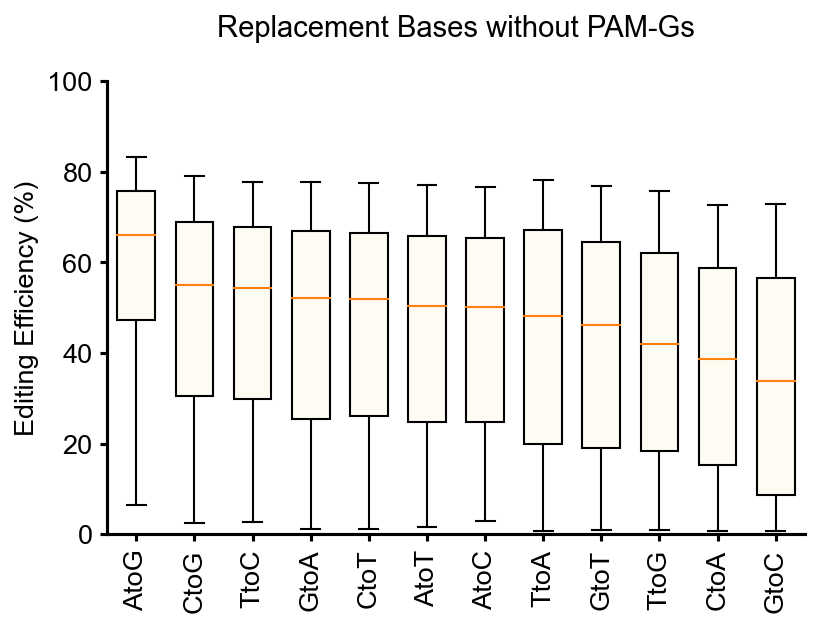

In [181]:

fig5, ax5 = plt.subplots(dpi=150)
ax5.set_title('Replacement Bases without PAM-Gs\n', fontsize=titlesize)

ax5.boxplot(repdata, showfliers = False, **boxplot_kwargs)
ax5.set_xticklabels(labels)
#ax5.set_xlabel('\nEdit Type', fontsize=lsize)
ax5.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax5.tick_params(axis='x', labelsize= lsize, width=1.5)
ax5.tick_params(axis='y', labelsize= lsize, width=1.5)
plt.xticks(rotation=90)
ax5.set_ylim(0, 100)
ax5.spines['right'].set_visible(False)
ax5.spines['top'].set_visible(False)
# show plot
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'replacementbases_withoutPAM_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

In [182]:
for x in repdata:
    print(len(x))

4482
3622
5252
3591
3768
4868
4644
4864
3403
4832
3353
4016


## Replacement bases w/o PAM-Gs vs unintended editing

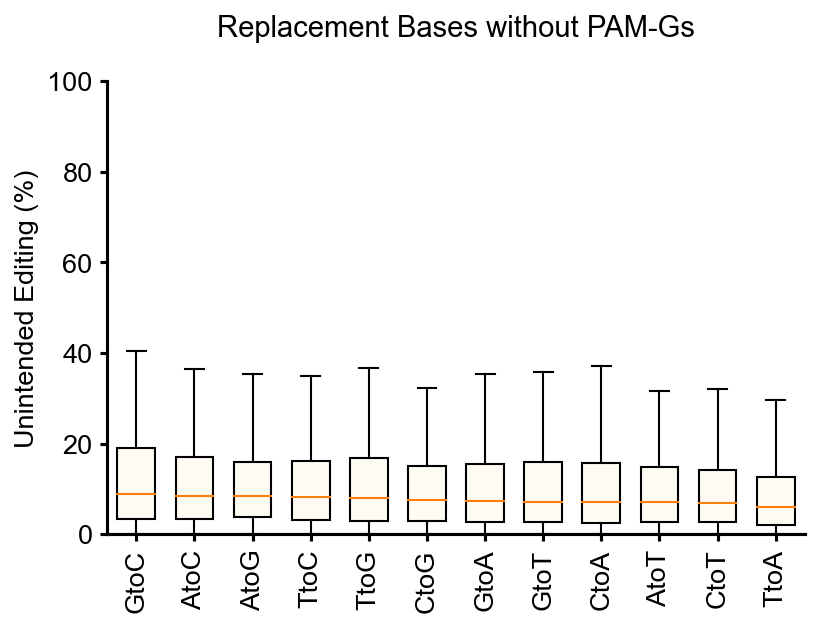

In [185]:
basechangelist = [('A','G'), ('A','C'),('A','T'),('C','A'),('C','G'),('C','T'),('T','A'),('T','G'),('T','C'),('G','A'),('G','C'),('G','T')]
repdata=[]
replacementdict = {}
for basechange in basechangelist:
    df = templatedf[(templatedf['AlternateAllele'] == basechange[0]) & (templatedf['ReferenceAllele'] == basechange[1]) & (templatedf['Target_Strand'] == "'Fw'") & (templatedf['Editing_Position'] != 4) &(templatedf['Editing_Position'] != 5)]['averageindel']
    dfrev = templatedf[(templatedf['AlternateAllele'] == str(Seq(basechange[0]).reverse_complement())) & (templatedf['ReferenceAllele'] == str(Seq(basechange[1]).reverse_complement())) & (templatedf['Target_Strand'] == "'Rv'") & (templatedf['Editing_Position'] != 4) &(templatedf['Editing_Position'] != 5)]['averageindel']
    finaldf = df.append(dfrev)
    repdata.append(finaldf)
    replacementdict[basechange[0]+'to'+basechange[1]] = finaldf

mediandata = [x.median() for x in repdata]
labels= ['AtoG', 'AtoC', 'AtoT','CtoA','CtoG','CtoT','TtoA','TtoG','TtoC','GtoA','GtoC','GtoT']
sortdf = pd.DataFrame()
sortdf['label']=labels
sortdf['mediandata']=mediandata
sortdf.sort_values(by='mediandata', ascending=False, inplace=True)
labels=sortdf['label']

repdata=[]
for ind, row in sortdf.iterrows():
    repdata.append(replacementdict[row['label']])

fig5, ax5 = plt.subplots(dpi=150)
ax5.set_title('Replacement Bases without PAM-Gs\n', fontsize=titlesize)

ax5.boxplot(repdata,showfliers = False, **boxplot_kwargs)
ax5.set_xticklabels(labels)
#ax5.set_xlabel('\nEdit Type', fontsize=lsize)
ax5.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax5.tick_params(axis='x', labelsize= lsize, width=1.5)
ax5.tick_params(axis='y', labelsize= lsize, width=1.5)
plt.xticks(rotation=90)
ax5.set_ylim(0, 100)
ax5.spines['right'].set_visible(False)
ax5.spines['top'].set_visible(False)
# show plot
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'replacementbases_withoutPAM_unintended_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

In [186]:
for x in repdata:
    print(len(x))

4016
4644
4482
5252
4832
3622
3591
3403
3353
4868
3768
4864


## Analysis of Replacement bases efficiency at PAM Gs only
PAM is always G, therefore this can lead to a bias of the overall efficiency of editing of bases

In [172]:
basechangelist = [('A','G'), ('A','C'),('A','T'),('C','A'),('C','G'),('C','T'),('T','A'),('T','G'),('T','C'),('G','A'),('G','C'),('G','T')]
repdata=[]
replacementdict = {}
for basechange in basechangelist:
    df = templatedf[(templatedf['AlternateAllele'] == basechange[0]) & (templatedf['ReferenceAllele'] == basechange[1]) & (templatedf['Target_Strand'] == "'Fw'") & (templatedf['Editing_Position'] > 3) &(templatedf['Editing_Position'] < 6)]['averageedited']
    dfrev = templatedf[(templatedf['AlternateAllele'] == str(Seq(basechange[0]).reverse_complement())) & (templatedf['ReferenceAllele'] == str(Seq(basechange[1]).reverse_complement())) & (templatedf['Target_Strand'] == "'Rv'") & (templatedf['Editing_Position'] > 3) &(templatedf['Editing_Position'] < 6)]['averageedited']
    finaldf = df.append(dfrev)
    repdata.append(finaldf)
    replacementdict[basechange[0]+'to'+basechange[1]] = finaldf

mediandata = [x.median() for x in repdata]
labels= ['AtoG', 'AtoC', 'AtoT','CtoA','CtoG','CtoT','TtoA','TtoG','TtoC','GtoA','GtoC','GtoT']
sortdf = pd.DataFrame()
sortdf['label']=labels
sortdf['mediandata']=mediandata
sortdf.sort_values(by='mediandata', ascending=False, inplace=True)
labels=sortdf['label']

repdata=[]
for ind, row in sortdf.iterrows():
    repdata.append(replacementdict[row['label']])

In [174]:
for x in repdata:
    print(len(x))

1751
3173
2301
0
0
0
0
0
0
0
0
0


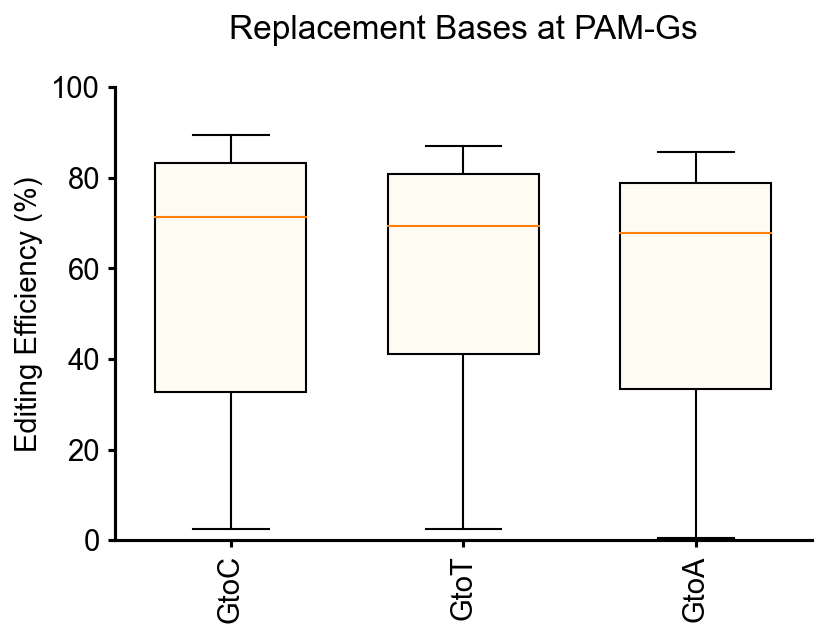

In [26]:
fig5, ax5 = plt.subplots(dpi=150)
ax5.set_title('Replacement Bases at PAM-Gs\n', fontsize=titlesize)

ax5.boxplot(repdata[:3], showfliers = False,**boxplot_kwargs)
ax5.set_xticklabels(labels[:3])
#ax5.set_xlabel('\nEdit Type', fontsize=lsize)
ax5.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax5.tick_params(axis='x', labelsize= lsize, width=1.5)
ax5.tick_params(axis='y', labelsize= lsize, width=1.5)
plt.xticks(rotation=90)
ax5.set_ylim(0, 100)
ax5.spines['right'].set_visible(False)
ax5.spines['top'].set_visible(False)
# show plot
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'replacementbases_atPAM_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

## Analysis of Replacement bases unintended editing at PAM Gs only

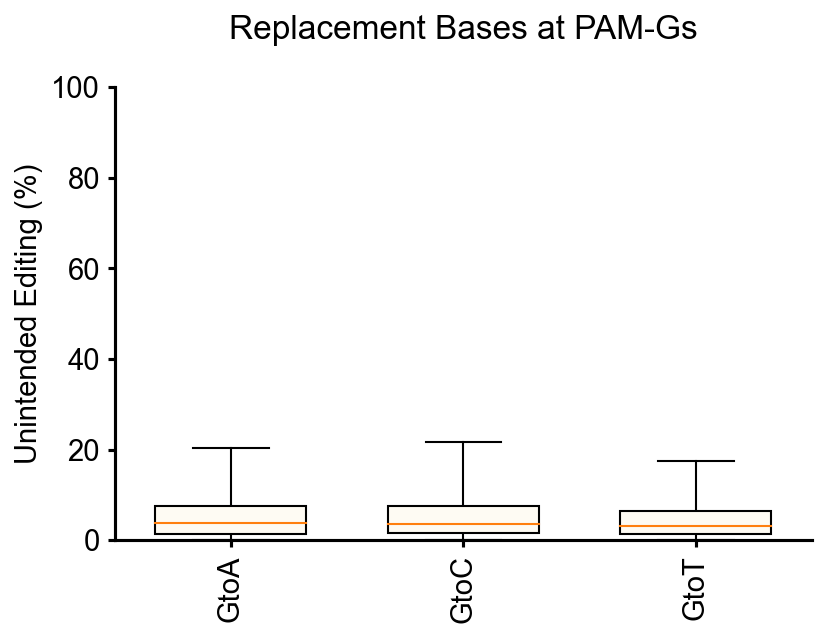

In [27]:
basechangelist = [('A','G'), ('A','C'),('A','T'),('C','A'),('C','G'),('C','T'),('T','A'),('T','G'),('T','C'),('G','A'),('G','C'),('G','T')]
repdata=[]
replacementdict = {}
for basechange in basechangelist:
    df = templatedf[(templatedf['AlternateAllele'] == basechange[0]) & (templatedf['ReferenceAllele'] == basechange[1]) & (templatedf['Target_Strand'] == "'Fw'") & (templatedf['Editing_Position'] > 3) &(templatedf['Editing_Position'] < 6)]['averageindel']
    dfrev = templatedf[(templatedf['AlternateAllele'] == str(Seq(basechange[0]).reverse_complement())) & (templatedf['ReferenceAllele'] == str(Seq(basechange[1]).reverse_complement())) & (templatedf['Target_Strand'] == "'Rv'") & (templatedf['Editing_Position'] > 3) &(templatedf['Editing_Position'] < 6)]['averageindel']
    finaldf = df.append(dfrev)
    repdata.append(finaldf)
    replacementdict[basechange[0]+'to'+basechange[1]] = finaldf

mediandata = [x.median() for x in repdata]
labels= ['AtoG', 'AtoC', 'AtoT','CtoA','CtoG','CtoT','TtoA','TtoG','TtoC','GtoA','GtoC','GtoT']
sortdf = pd.DataFrame()
sortdf['label']=labels
sortdf['mediandata']=mediandata
sortdf.sort_values(by='mediandata', ascending=False, inplace=True)
labels=sortdf['label']

repdata=[]
for ind, row in sortdf.iterrows():
    repdata.append(replacementdict[row['label']])
fig5, ax5 = plt.subplots(dpi=150)
ax5.set_title('Replacement Bases at PAM-Gs\n', fontsize=titlesize)

ax5.boxplot(repdata[:3], showfliers = False, **boxplot_kwargs)
ax5.set_xticklabels(labels[:3])
#ax5.set_xlabel('\nEdit Type', fontsize=lsize)
ax5.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax5.tick_params(axis='x', labelsize= lsize, width=1.5)
ax5.tick_params(axis='y', labelsize= lsize, width=1.5)
plt.xticks(rotation=90)
ax5.set_ylim(0, 100)
ax5.spines['right'].set_visible(False)
ax5.spines['top'].set_visible(False)
# show plot
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'replacementbases_atPAM_unintended_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

In [28]:
path = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
walton = pd.read_csv(path+'20211116_Walton_NGGN.csv')

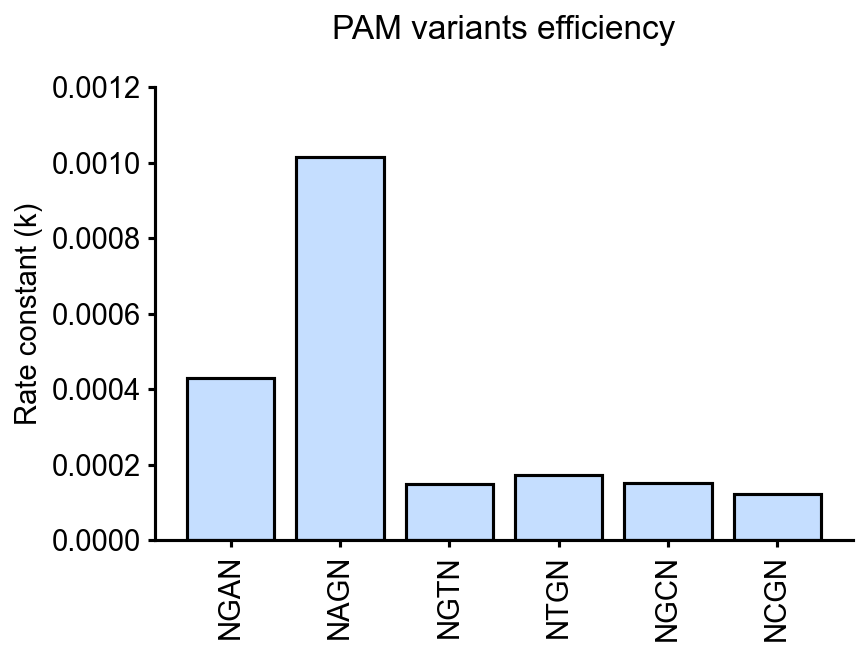

In [29]:
NGGN = walton['NGGN']
NGAN = walton['NGAN']
NAGN = walton['NAGN']
NGTN = walton['NGTN']
NTGN = walton['NTGN']
NGCN = walton['NGCN']
NCGN = walton['NCGN']

variants = [NGAN,NAGN,NGTN,NTGN,NGCN,NCGN]
variantsmedian = [x.median() for x in variants]



fig5, ax5 = plt.subplots(dpi=150)
ax5.set_title('PAM variants efficiency\n', fontsize=titlesize)

ax5.bar(list(walton.columns)[1:],variantsmedian, **bar_kwargs)
#ax5.set_xticklabels(walton.columns)
#ax5.set_xlabel('\nEdit Type', fontsize=lsize)
ax5.set_ylabel('Rate constant (k)', fontsize=lsize)
ax5.tick_params(axis='x', labelsize= lsize, width=1.5)
ax5.tick_params(axis='y', labelsize= lsize, width=1.5)
plt.xticks(rotation=90)
ax5.set_ylim(0, 0.0012)
ax5.spines['right'].set_visible(False)
ax5.spines['top'].set_visible(False)
# show plot
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'PAMvariantefficiency.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

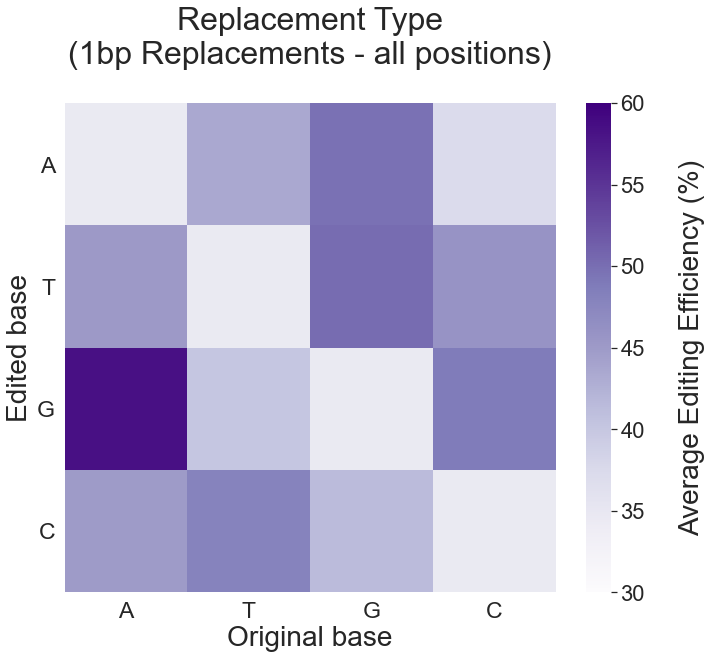

In [30]:
sn.set(font_scale=2)
originalbaselist = ['A','T','G','C']
editedbaselist = ['A','T','G','C']
replacementeditheatmaparray = np.empty([4,4])
for originalbaseindex, originalbase in enumerate(originalbaselist):
    for editedbaseindex, editedbase in enumerate(editedbaselist):
        df = templatedf[(templatedf['AlternateAllele'] == originalbase) & (templatedf['ReferenceAllele'] == editedbase) & (templatedf['Target_Strand'] == "'Fw'")]['averageedited']
        dfrev = templatedf[(templatedf['AlternateAllele'] == str(Seq(originalbase).reverse_complement())) & (templatedf['ReferenceAllele'] == str(Seq(editedbase).reverse_complement())) & (templatedf['Target_Strand'] == "'Rv'")]['averageedited']
        editrates = df.append(dfrev)
        replacementeditheatmaparray[editedbaseindex, originalbaseindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(11, 9))
ax.set_title('Replacement Type\n(1bp Replacements - all positions)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Purples", as_cmap=True)
ax = sn.heatmap(replacementeditheatmaparray,cmap=cmap,cbar_kws={'label': '\nAverage Editing Efficiency (%)'},vmin=30, vmax=60)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = originalbaselist
plt.xticks(np.arange(len(originalbaselist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = editedbaselist
plt.yticks(np.arange(len(editedbaselist)) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Original base', fontsize=28)
ax.set_ylabel('Edited base', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'replacement_allpos_editbases_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

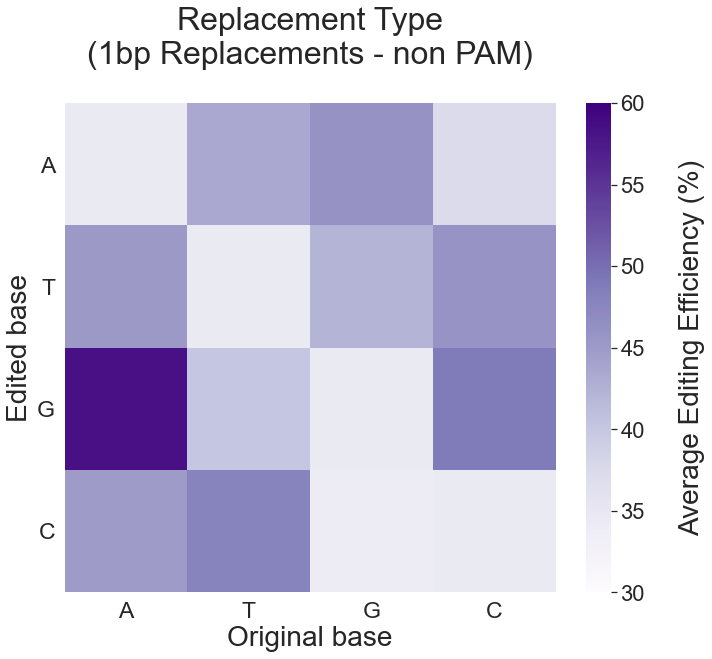

In [31]:
sn.set(font_scale=2)
originalbaselist = ['A','T','G','C']
editedbaselist = ['A','T','G','C']
replacementeditheatmaparray = np.empty([4,4])
for originalbaseindex, originalbase in enumerate(originalbaselist):
    for editedbaseindex, editedbase in enumerate(editedbaselist):
        df = templatedf[(templatedf['AlternateAllele'] == originalbase) & (templatedf['ReferenceAllele'] == editedbase) & (templatedf['Target_Strand'] == "'Fw'") & (templatedf['Editing_Position'] != 4) &(templatedf['Editing_Position'] != 5)]['averageedited']
        dfrev = templatedf[(templatedf['AlternateAllele'] == str(Seq(originalbase).reverse_complement())) & (templatedf['ReferenceAllele'] == str(Seq(editedbase).reverse_complement())) & (templatedf['Target_Strand'] == "'Rv'") & (templatedf['Editing_Position'] != 4) &(templatedf['Editing_Position'] != 5)]['averageedited']
        editrates = df.append(dfrev)
        replacementeditheatmaparray[editedbaseindex, originalbaseindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(11, 9))
ax.set_title('Replacement Type\n(1bp Replacements - non PAM)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Purples", as_cmap=True)
ax = sn.heatmap(replacementeditheatmaparray,cmap=cmap,cbar_kws={'label': '\nAverage Editing Efficiency (%)'},vmin=30, vmax=60)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = originalbaselist
plt.xticks(np.arange(len(originalbaselist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = editedbaselist
plt.yticks(np.arange(len(editedbaselist)) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Original base', fontsize=28)
ax.set_ylabel('Edited base', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'replacement_nonPAM_editbases_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

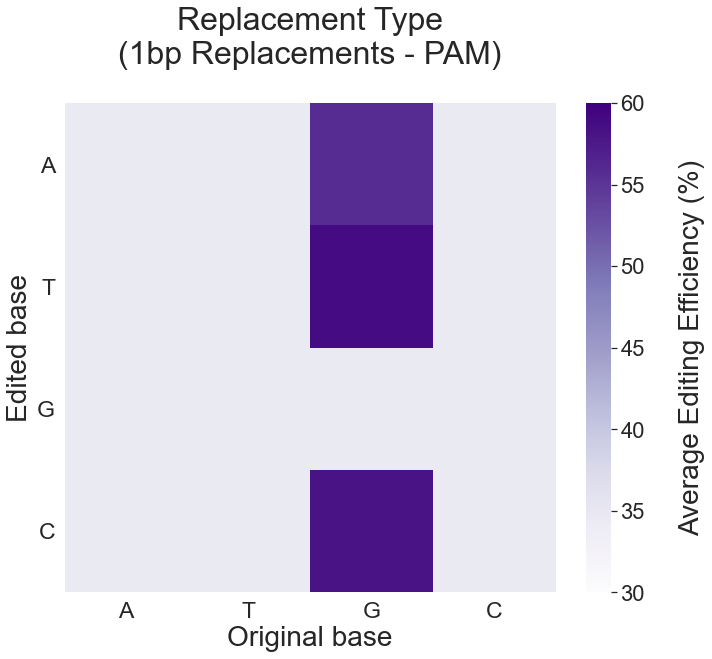

In [32]:
sn.set(font_scale=2)
originalbaselist = ['A','T','G','C']
editedbaselist = ['A','T','G','C']
replacementeditheatmaparray = np.empty([4,4])
for originalbaseindex, originalbase in enumerate(originalbaselist):
    for editedbaseindex, editedbase in enumerate(editedbaselist):
        df = templatedf[(templatedf['AlternateAllele'] == originalbase) & (templatedf['ReferenceAllele'] == editedbase) & (templatedf['Target_Strand'] == "'Fw'") & (templatedf['Editing_Position'] > 3) &(templatedf['Editing_Position'] < 6)]['averageedited']
        dfrev = templatedf[(templatedf['AlternateAllele'] == str(Seq(originalbase).reverse_complement())) & (templatedf['ReferenceAllele'] == str(Seq(editedbase).reverse_complement())) & (templatedf['Target_Strand'] == "'Rv'") & (templatedf['Editing_Position'] > 3) &(templatedf['Editing_Position'] < 6)]['averageedited']
        editrates = df.append(dfrev)
        replacementeditheatmaparray[editedbaseindex, originalbaseindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(11, 9))
ax.set_title('Replacement Type\n(1bp Replacements - PAM)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Purples", as_cmap=True)
ax = sn.heatmap(replacementeditheatmaparray,cmap=cmap,cbar_kws={'label': '\nAverage Editing Efficiency (%)'},vmin=30, vmax=60)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = originalbaselist
plt.xticks(np.arange(len(originalbaselist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = editedbaselist
plt.yticks(np.arange(len(editedbaselist)) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Original base', fontsize=28)
ax.set_ylabel('Edited base', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'replacement_PAM_editbases_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

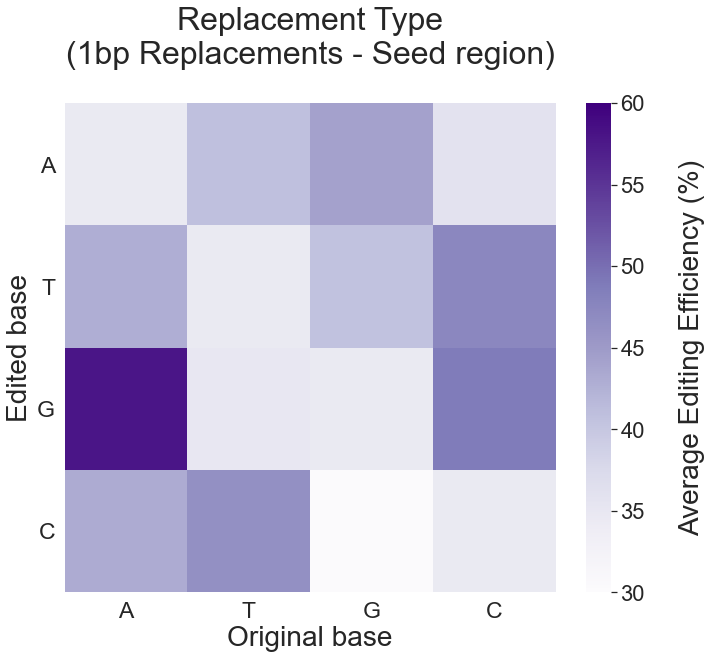

In [ ]:
sn.set(font_scale=2)
originalbaselist = ['A','T','G','C']
editedbaselist = ['A','T','G','C']
replacementeditheatmaparray = np.empty([4,4])
for originalbaseindex, originalbase in enumerate(originalbaselist):
    for editedbaseindex, editedbase in enumerate(editedbaselist):
        df = templatedf[(templatedf['AlternateAllele'] == originalbase) & (templatedf['ReferenceAllele'] == editedbase) & (templatedf['Target_Strand'] == "'Fw'") & (templatedf['Editing_Position'] < 4)]['averageedited']
        dfrev = templatedf[(templatedf['AlternateAllele'] == str(Seq(originalbase).reverse_complement())) & (templatedf['ReferenceAllele'] == str(Seq(editedbase).reverse_complement())) & (templatedf['Target_Strand'] == "'Rv'") & (templatedf['Editing_Position'] < 4)]['averageedited']
        editrates = df.append(dfrev)
        replacementeditheatmaparray[editedbaseindex, originalbaseindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(11, 9))
ax.set_title('Replacement Type\n(1bp Replacements - Seed region)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Purples", as_cmap=True)
ax = sn.heatmap(replacementeditheatmaparray,cmap=cmap,cbar_kws={'label': '\nAverage Editing Efficiency (%)'},vmin=30, vmax=60)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = originalbaselist
plt.xticks(np.arange(len(originalbaselist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = editedbaselist
plt.yticks(np.arange(len(editedbaselist)) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel('Original base', fontsize=28)
ax.set_ylabel('Edited base', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'replacement_Seed_editbases_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

## Edit rates for NGGG to NNGG vs NGGN to NNGN
Check if prime editing is less efficient if G after NGG is present (PAM does not become completely unusable then)

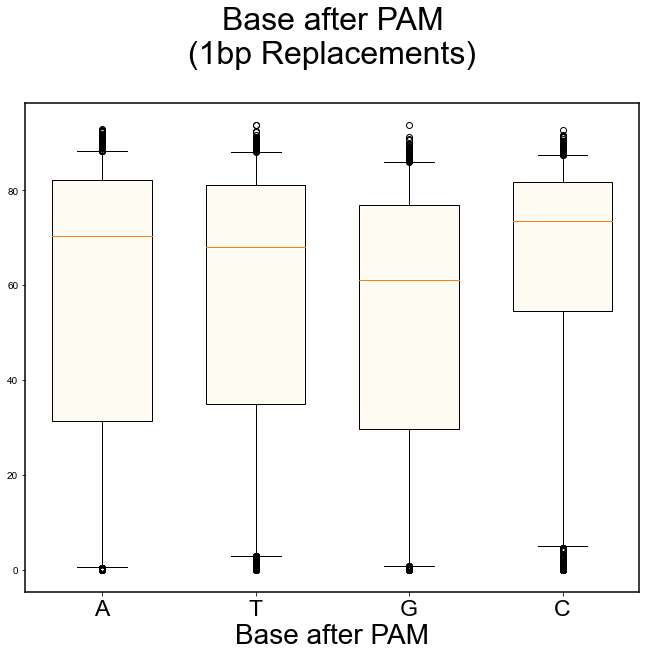

In [6]:
baseafterPAMlist = ['A','T','G','C']
protospacerendposition = -30
baseafterpamefficiencylist = []
templatedf['baseafterpam'] = templatedf['Disease_Block'].apply(lambda x: str(Seq(x[protospacerendposition-23:protospacerendposition-22]).reverse_complement()))
for baseafterPAMindex, baseafterPAM in enumerate(baseafterPAMlist):
    #nickbaseafter = str(Seq(row['Disease_Block'][protospacerendposition-23:protospacerendposition-22]).reverse_complement())
    editrates = templatedf[(templatedf['Correction_Type'] == 'Replacement') &(templatedf['baseafterpam'] == baseafterPAM) & (templatedf['Editing_Position'] == 4)]['averageedited']
    baseafterpamefficiencylist.append(editrates)
fig, ax = plt.subplots(figsize=(11, 9))
ax.set_title('Base after PAM\n(1bp Replacements)\n', fontsize=32)
ax.boxplot(baseafterpamefficiencylist, **boxplot_kwargs)
#ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = baseafterPAMlist
plt.xticks([1,2,3,4], labels=xticks_labels, fontsize=23)
ax.set_xlabel('Base after PAM', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.show()

## Edit rates for different bases before protospacer (5')
Check if prime editing efficiency is different for different bases BEFORE protospacer starts (because our protospacer was 19bp and we added a G to the 5' end

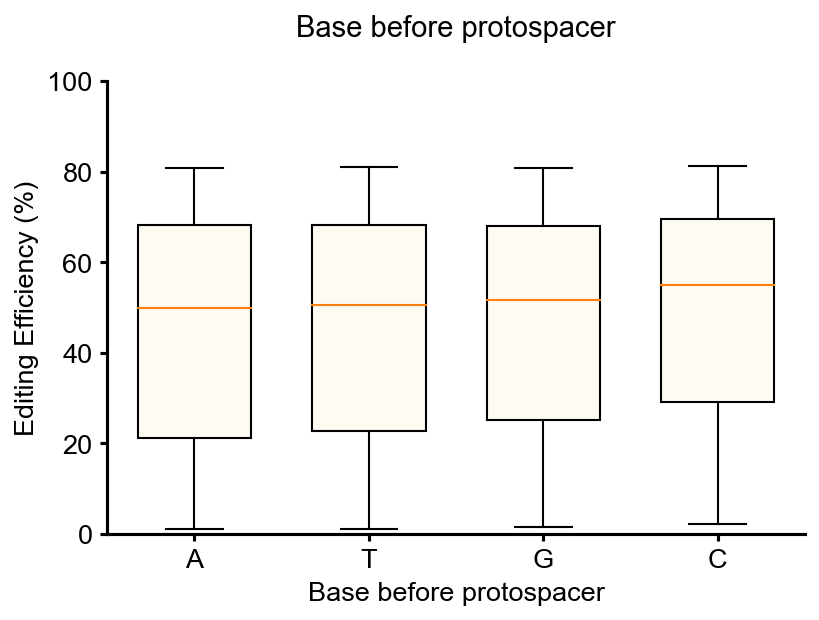

In [183]:
basebeforeprotolist = ['A','T','G','C']


protospacerendposition = -30
basebeforeprotoefficiencylist = []
templatedf['basebeforeproto'] = templatedf['Disease_Block'].apply(lambda x: str(Seq(x[protospacerendposition-23:protospacerendposition-22]).reverse_complement()))
for basebeforeprotoindex, basebeforeproto in enumerate(basebeforeprotolist):
    #nickbaseafter = str(Seq(row['Disease_Block'][protospacerendposition-23:protospacerendposition-22]).reverse_complement())
    editrates = templatedf[(templatedf['Correction_Type'] == 'Replacement') &(templatedf['basebeforeproto'] == basebeforeproto)]['averageedited']
    basebeforeprotoefficiencylist.append(editrates)
fig, ax = plt.subplots(dpi=150)
ax.set_title('Base before protospacer\n', fontsize=titlesize)
ax.boxplot(basebeforeprotoefficiencylist, showfliers = False, **boxplot_kwargs)
#ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = basebeforeprotolist
plt.xticks([1,2,3,4], labels=xticks_labels, fontsize=23)
ax.set_xlabel('Base before protospacer', fontsize=lsize)
ax.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax.tick_params(axis='x', labelsize= lsize, width=1.5)
ax.tick_params(axis='y', labelsize= lsize, width=1.5)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.set_ylim(0, 100)
#ax.set_ylabel('Edited base', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'basebeforeprotospacer_boxplot.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

In [184]:
for x in basebeforeprotoefficiencylist:
    print(len(x))

16694
13792
12861
14573


In [8]:
medianlist = [x.median() for x in basebeforeprotoefficiencylist[:3]]
medianlist
nonC = pd.Series()
nonC = nonC.append(basebeforeprotoefficiencylist[0]).append(basebeforeprotoefficiencylist[1]).append(basebeforeprotoefficiencylist[2])
print('NonC median:',nonC.median())
print('C median:',basebeforeprotoefficiencylist[3].median())

NonC median: 50.61925620395974
C median: 55.03480051574425


C:\Users\nimath\AppData\Local\Temp/ipykernel_300/3537264919.py:3: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  nonC = pd.Series()


## Unintended editing rates for different bases before protospacer (5')


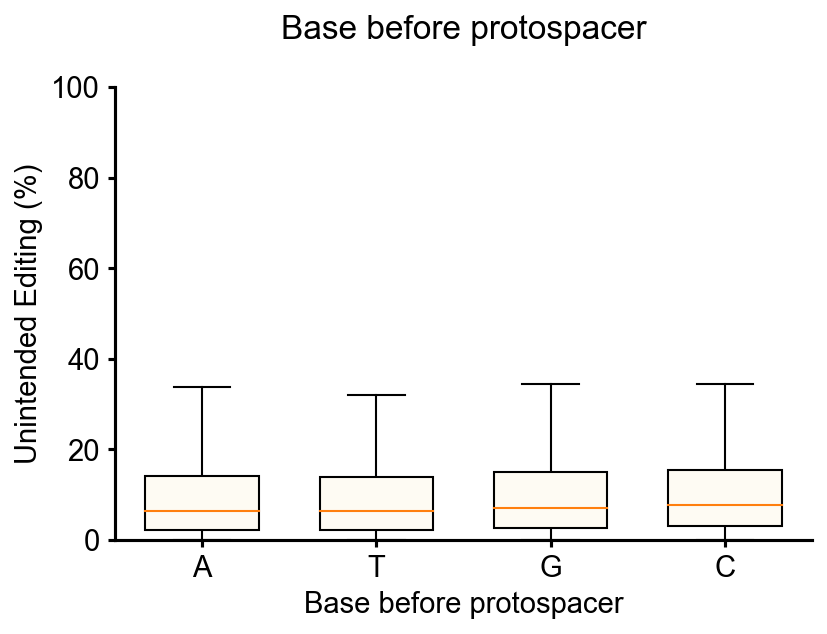

In [9]:
basebeforeprotolist = ['A','T','G','C']


protospacerendposition = -30
basebeforeprotoefficiencylist = []
templatedf['basebeforeproto'] = templatedf['Disease_Block'].apply(lambda x: str(Seq(x[protospacerendposition-23:protospacerendposition-22]).reverse_complement()))
for basebeforeprotoindex, basebeforeproto in enumerate(basebeforeprotolist):
    #nickbaseafter = str(Seq(row['Disease_Block'][protospacerendposition-23:protospacerendposition-22]).reverse_complement())
    editrates = templatedf[(templatedf['Correction_Type'] == 'Replacement') &(templatedf['basebeforeproto'] == basebeforeproto)]['averageindel']
    basebeforeprotoefficiencylist.append(editrates)
fig, ax = plt.subplots(dpi=150)
ax.set_title('Base before protospacer\n', fontsize=titlesize)
ax.boxplot(basebeforeprotoefficiencylist, showfliers = False, **boxplot_kwargs)
#ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = basebeforeprotolist
plt.xticks([1,2,3,4], labels=xticks_labels, fontsize=23)
ax.set_xlabel('Base before protospacer', fontsize=lsize)
ax.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax.tick_params(axis='x', labelsize= lsize, width=1.5)
ax.tick_params(axis='y', labelsize= lsize, width=1.5)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.set_ylim(0, 100)
#ax.set_ylabel('Edited base', fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'basebeforeprotospacer_boxplot_unintendedediting.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

## DeepCas9 vs. Editing rate

In [11]:
deep9 = templatedf['deepcas9'].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([deep9,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, deepz = deep9[idx], editeff[idx], z[idx]
deep9_R = stats.spearmanr(templatedf['deepcas9'], templatedf['averageedited'])[0]
deep9_r = stats.pearsonr(templatedf['deepcas9'], templatedf['averageedited'])[0]

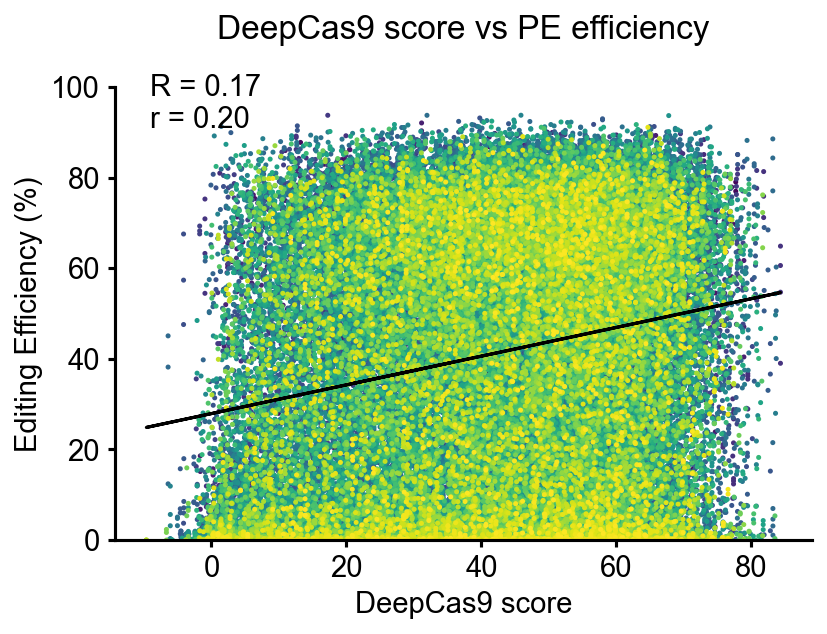

In [12]:
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('DeepCas9 score vs PE efficiency\n', fontsize=16)
ax7.scatter(templatedf['deepcas9'], templatedf['averageedited'], c=deepz, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('DeepCas9 score', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf['deepcas9'], templatedf['averageedited'], 1)
ax7.plot(templatedf['deepcas9'], m*templatedf['deepcas9'] + b, color='black')
ax7.set_ylim(0, 100)

ax7.text(0.05,1.03, 'R = '+str(deep9_R)[:4]+'\nr = '+str(deep9_r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'deepcas9editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## DeepCas9 vs. Unintended editing

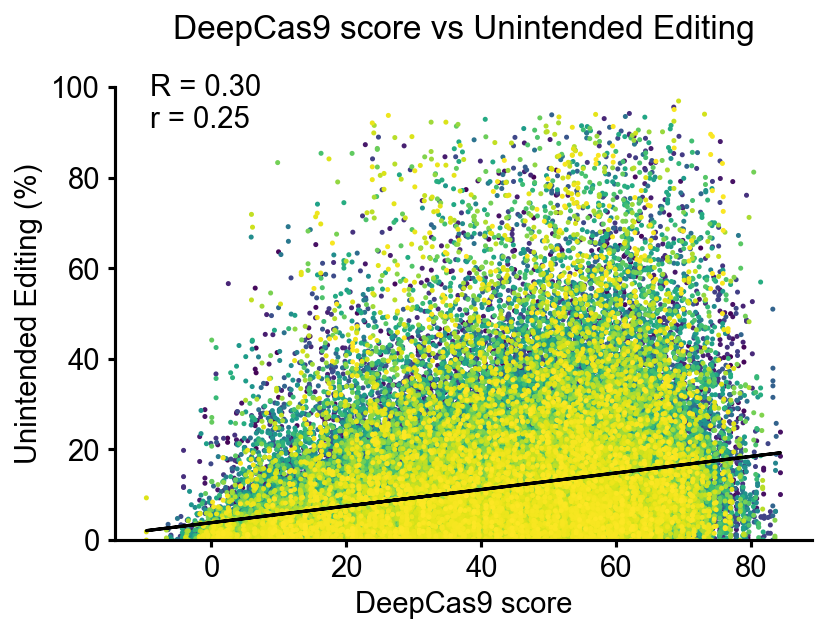

In [13]:
deep9 = templatedf['deepcas9'].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([deep9,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, deepz = deep9[idx], editeff[idx], z[idx]
deep9_R = stats.spearmanr(templatedf['deepcas9'], templatedf['averageindel'])[0]
deep9_r = stats.pearsonr(templatedf['deepcas9'], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('DeepCas9 score vs Unintended Editing\n', fontsize=16)
ax7.scatter(templatedf['deepcas9'], templatedf['averageindel'], c=deepz, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('DeepCas9 score', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf['deepcas9'], templatedf['averageindel'], 1)
ax7.plot(templatedf['deepcas9'], m*templatedf['deepcas9'] + b, color='black')
ax7.set_ylim(0, 100)

ax7.text(0.05,1.03, 'R = '+str(deep9_R)[:4]+'\nr = '+str(deep9_r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'deepcas9unintendedediting.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## DeepCas9 vs. Editing rate (only GtoC Pos 5)
Show correlation of DeepCas9 vs. Schwanklab editing on position 5 with GtoC replacements to compare DeepCas9 with DeepPE model.

In [14]:
templatedfGtoC = templatedf[(templatedf['AlternateAllele'] == 'G') & (templatedf['ReferenceAllele'] == 'C') & (templatedf['Editing_Position'] == 5)]
deep9 = templatedfGtoC['deepcas9'].reset_index(drop=True)
editeff = templatedfGtoC['averageedited'].reset_index(drop=True)
xy = np.vstack([deep9,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = deep9[idx], editeff[idx], z[idx]
deep9_R = stats.spearmanr(templatedfGtoC['deepcas9'], templatedfGtoC['averageedited'])[0]
deep9_r = stats.pearsonr(templatedfGtoC['deepcas9'], templatedfGtoC['averageedited'])[0]

In [15]:
deep9_R

0.19563797032028443

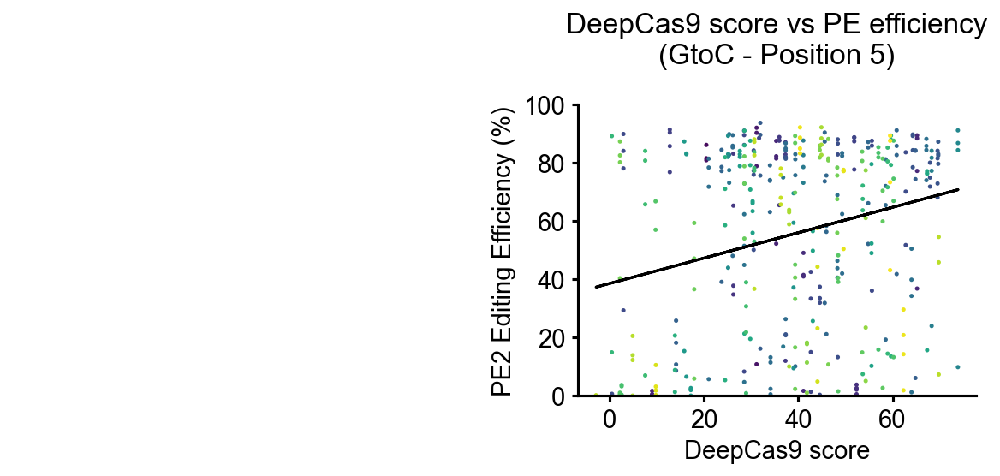

In [16]:
fig7, ax7 = plt.subplots(figsize = (4, 3), dpi=150)
plt.rcParams['axes.linewidth'] = 1.5
ax7.set_title('DeepCas9 score vs PE efficiency\n(GtoC - Position 5)\n', fontsize=titlesize)
ax7.scatter(templatedfGtoC['deepcas9'], templatedfGtoC['averageedited'], c=z, s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('DeepCas9 score', fontsize=lsize)
ax7.set_ylabel('PE2 Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedfGtoC['deepcas9'], templatedfGtoC['averageedited'], 1)
ax7.plot(templatedfGtoC['deepcas9'], m*templatedfGtoC['deepcas9'] + b, color='black')
ax7.set_ylim(0, 100)

ax7.text(-1,0.15, 'R = '+str(deep9_R)[:4]+'\nr = '+str(deep9_r)[:4], transform=ax.transAxes, fontsize=14,
        verticalalignment='top')
plt.show()

## Analysis of GC content in Extension-part

In [17]:
gcextension = templatedf['Extension_GC_content'].reset_index(drop=True)

editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([gcextension,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, gcextensionz = gcextension[idx], editeff[idx], z[idx]
gcextension_R = stats.spearmanr(templatedf['Extension_GC_content'], templatedf['averageedited'])[0]
gcextension_r = stats.pearsonr(templatedf['Extension_GC_content'], templatedf['averageedited'])[0]

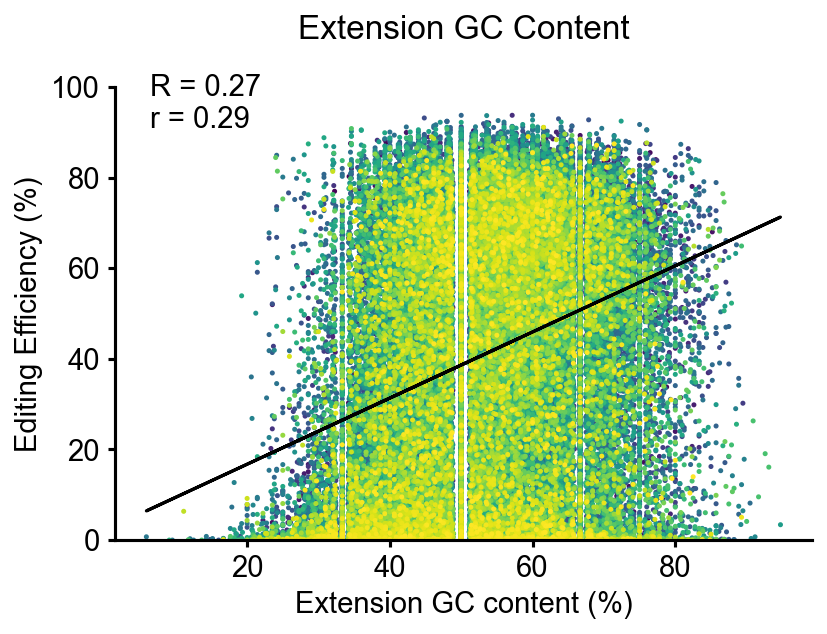

In [18]:
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Extension GC Content\n', fontsize=16)
ax7.scatter(templatedf['Extension_GC_content'], templatedf['averageedited'], c=gcextensionz, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Extension GC content (%)', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf['Extension_GC_content'], templatedf['averageedited'], 1)
ax7.plot(templatedf['Extension_GC_content'], m*templatedf['Extension_GC_content'] + b, color='black')
ax7.set_ylim(0, 100)

ax7.text(0.05,1.03, 'R = '+str(gcextension_R)[:4]+'\nr = '+str(gcextension_r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'Extension_GC_content_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Unintended Editing - Analysis of GC content in Extension-part

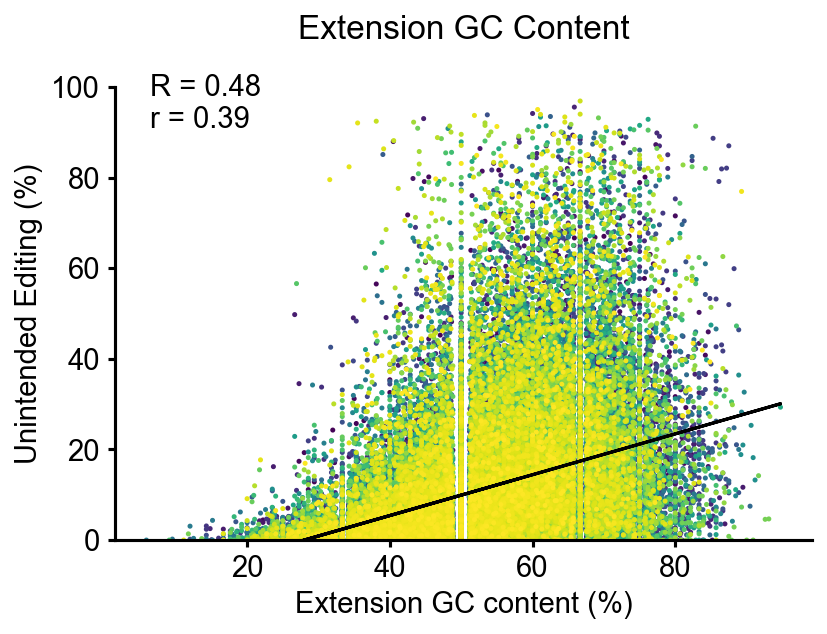

In [19]:
gcextension = templatedf['Extension_GC_content'].reset_index(drop=True)

editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([gcextension,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, gcextensionz = gcextension[idx], editeff[idx], z[idx]
gcextension_R = stats.spearmanr(templatedf['Extension_GC_content'], templatedf['averageindel'])[0]
gcextension_r = stats.pearsonr(templatedf['Extension_GC_content'], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Extension GC Content\n', fontsize=16)
ax7.scatter(templatedf['Extension_GC_content'], templatedf['averageindel'], c=gcextensionz, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Extension GC content (%)', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf['Extension_GC_content'], templatedf['averageindel'], 1)
ax7.plot(templatedf['Extension_GC_content'], m*templatedf['Extension_GC_content'] + b, color='black')
ax7.set_ylim(0, 100)

ax7.text(0.05,1.03, 'R = '+str(gcextension_R)[:4]+'\nr = '+str(gcextension_r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'Extension_GC_content_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Analysis of GC content in Protospacer

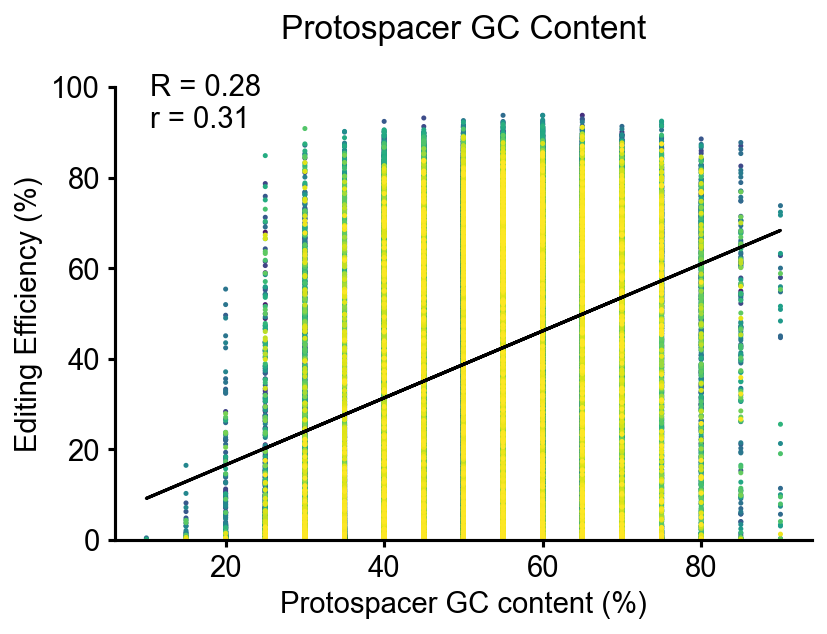

In [20]:
xaxis_column = 'Proto_GC_content'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Protospacer GC Content\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Protospacer GC content (%)', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'Protospacer_GC_content_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Analysis of GC content in Protospacer (Unintended Editing)

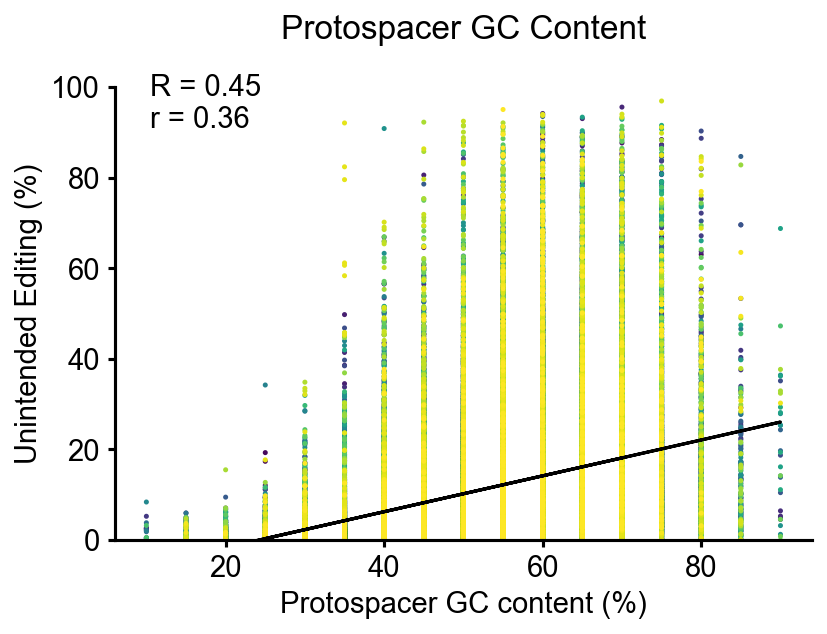

In [21]:
xaxis_column = 'Proto_GC_content'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Protospacer GC Content\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Protospacer GC content (%)', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'Protospacer_GC_content_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Analysis of GC content in RT

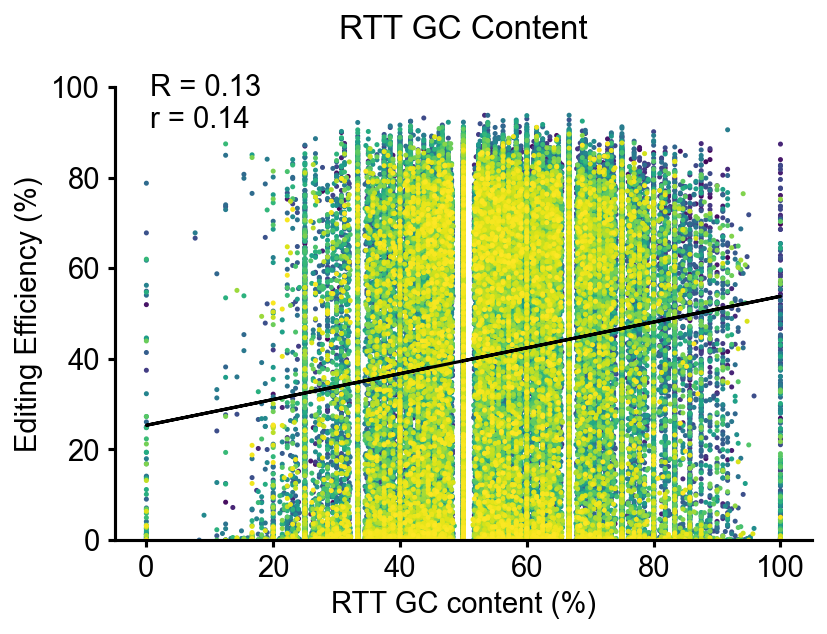

In [22]:
xaxis_column = 'RT_GC_content'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('RTT GC Content\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('RTT GC content (%)', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'RT_GC_content_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Analysis of GC content in RT (Unintended Editing)

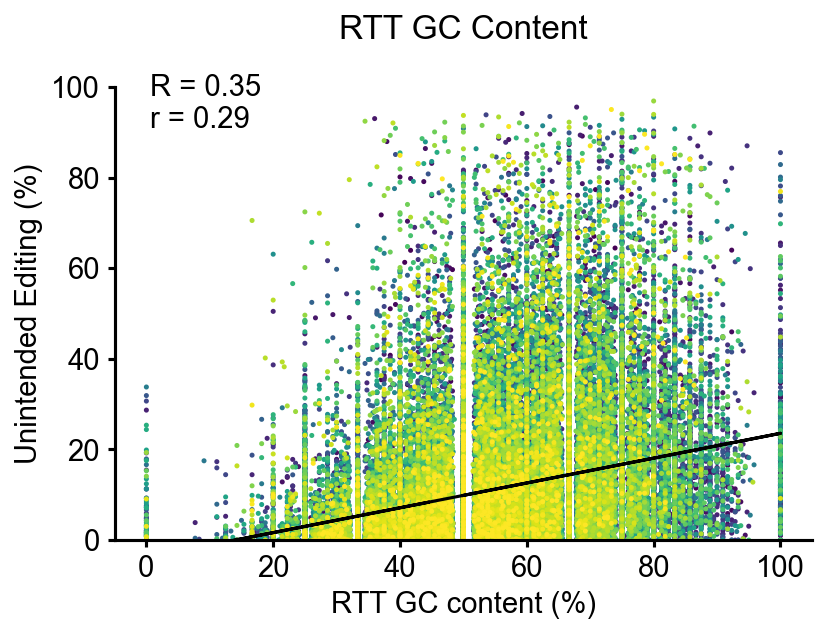

In [23]:
xaxis_column = 'RT_GC_content'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('RTT GC Content\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('RTT GC content (%)', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'RT_GC_content_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Analysis of GC content in PBS

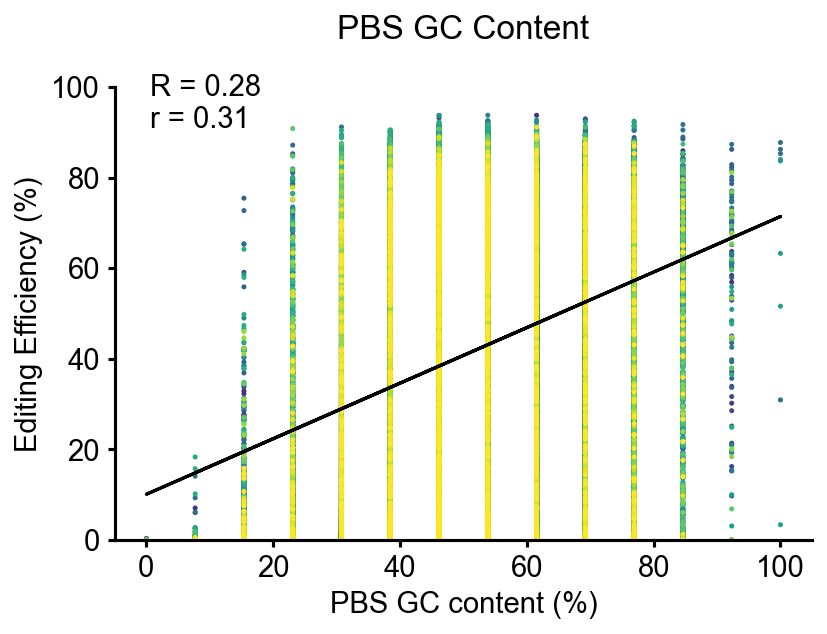

In [24]:
xaxis_column = 'PBS_GC_content'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('PBS GC Content\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('PBS GC content (%)', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'PBS_GC_content_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Analysis of GC content in PBS (Unintended Editing)

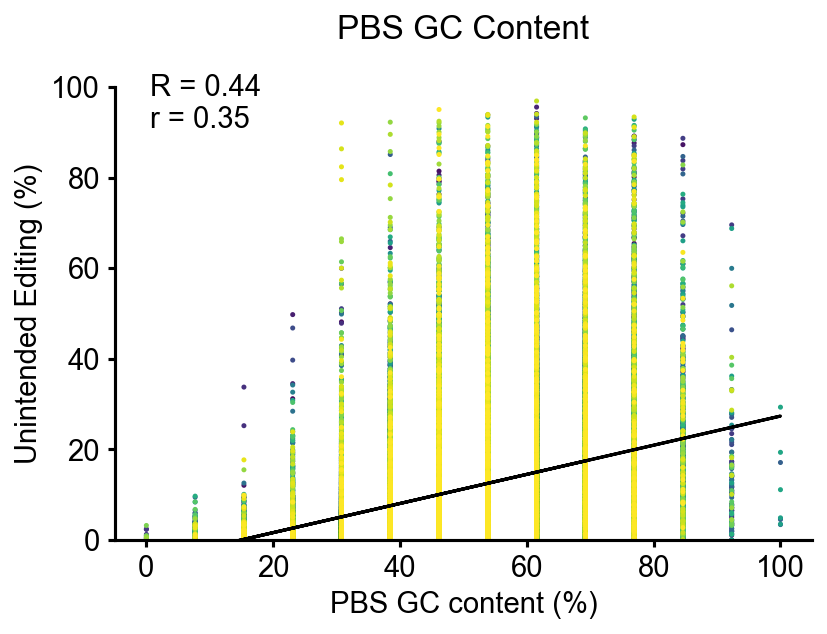

In [25]:
xaxis_column = 'PBS_GC_content'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('PBS GC Content\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('PBS GC content (%)', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'PBS_GC_content_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Analysis of GC content in original Base

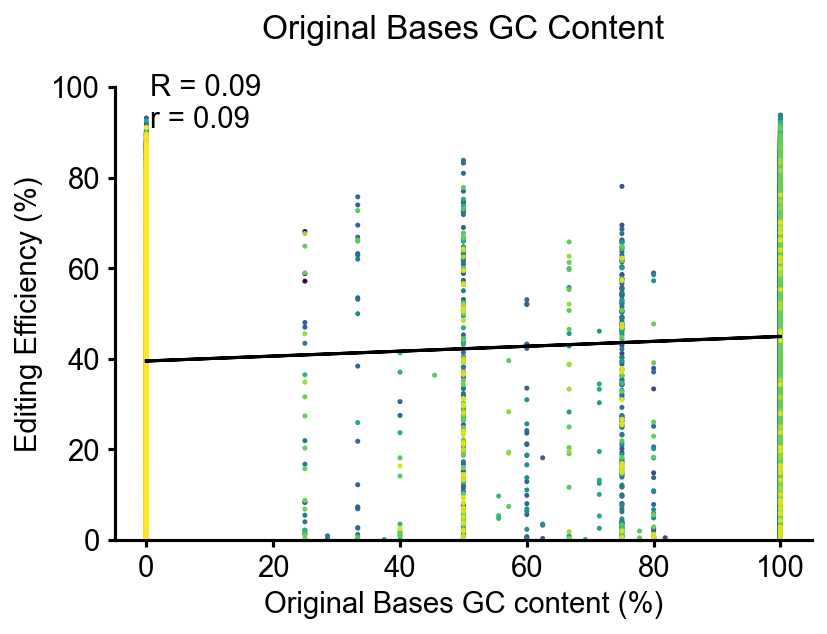

In [26]:
xaxis_column = 'original_GC_content'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Original Bases GC Content\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Original Bases GC content (%)', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'Original_Bases_GC_content_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Analysis of GC content in original Base (Unintended Editing)

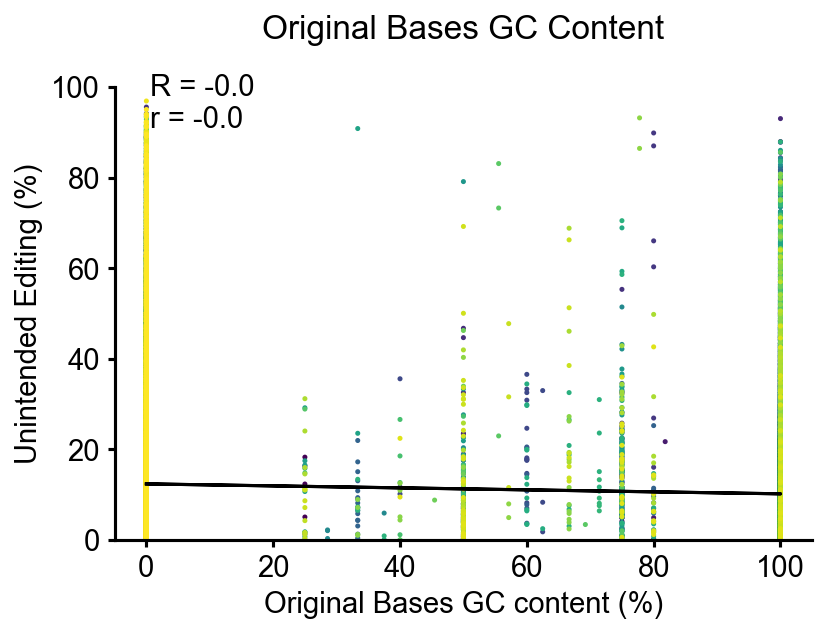

In [27]:
xaxis_column = 'original_GC_content'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Original Bases GC Content\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Original Bases GC content (%)', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'Original_Bases_GC_content_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Analysis of GC content in edited Base

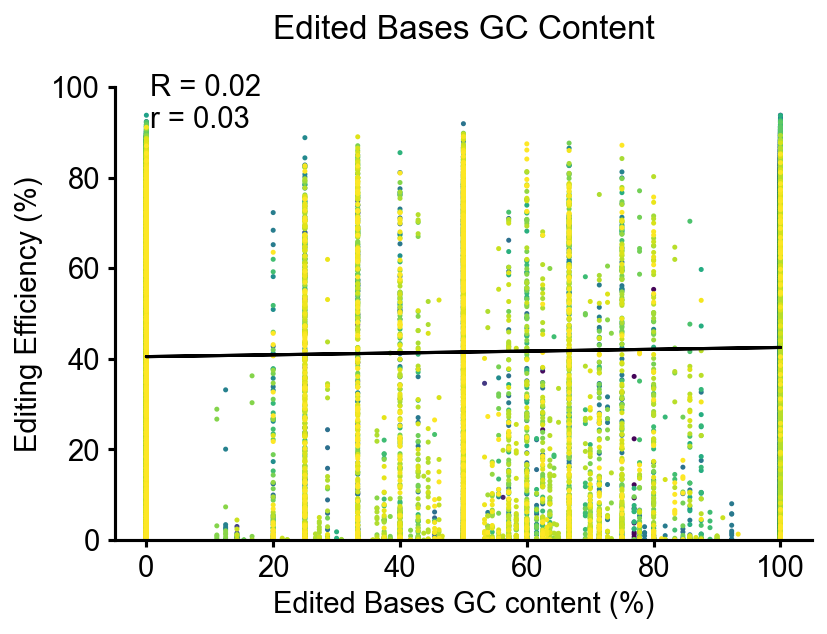

In [28]:
xaxis_column = 'edited_GC_content'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Edited Bases GC Content\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Edited Bases GC content (%)', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'Edited_Bases_GC_content_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Analysis of GC content in edited Base (unintended editing)

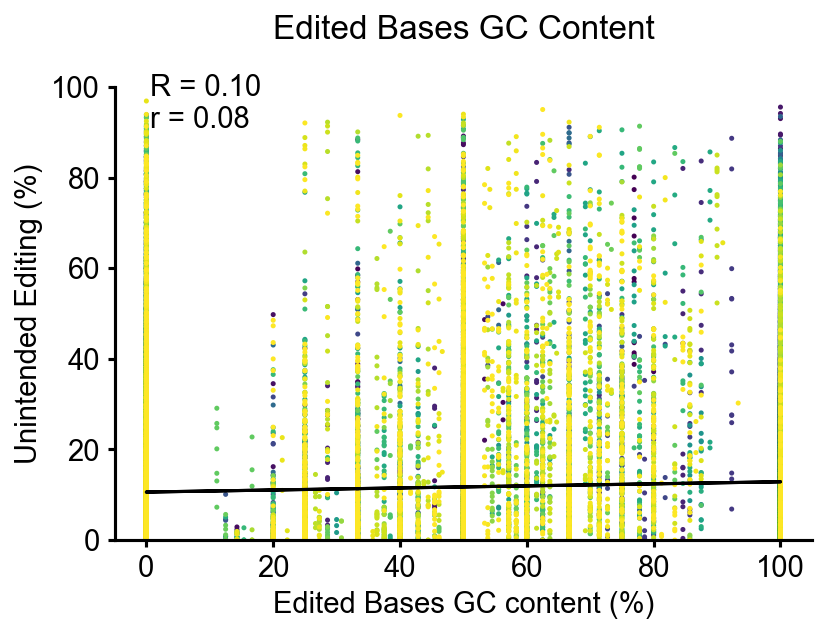

In [29]:
xaxis_column = 'edited_GC_content'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Edited Bases GC Content\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Edited Bases GC content (%)', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'Edited_Bases_GC_content_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## RToverhangmatches vs editing rate

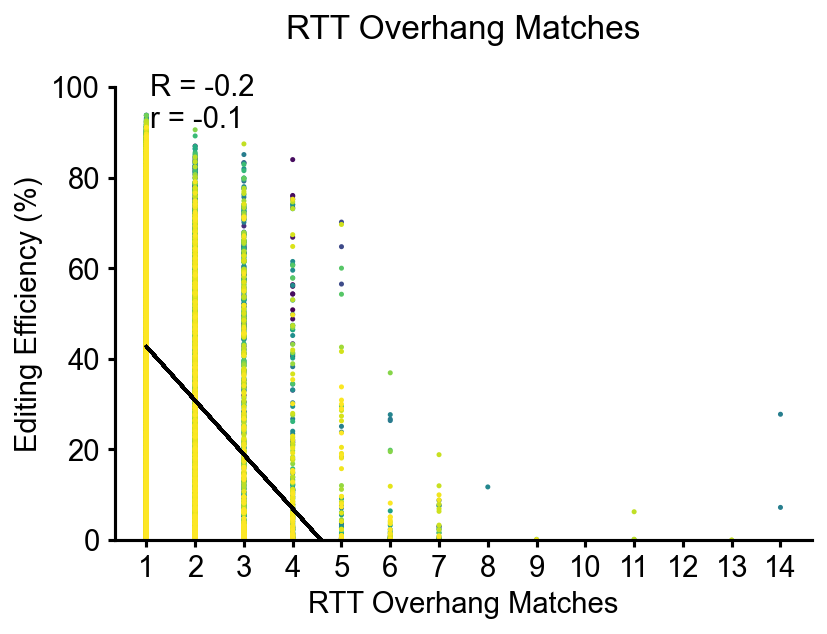

In [30]:
xaxis_column = 'RToverhangmatches'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('RTT Overhang Matches\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('RTT Overhang Matches', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_xticks(range(1,15))
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'RToverhangmatches_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## RToverhangmatches vs unintended editing rate

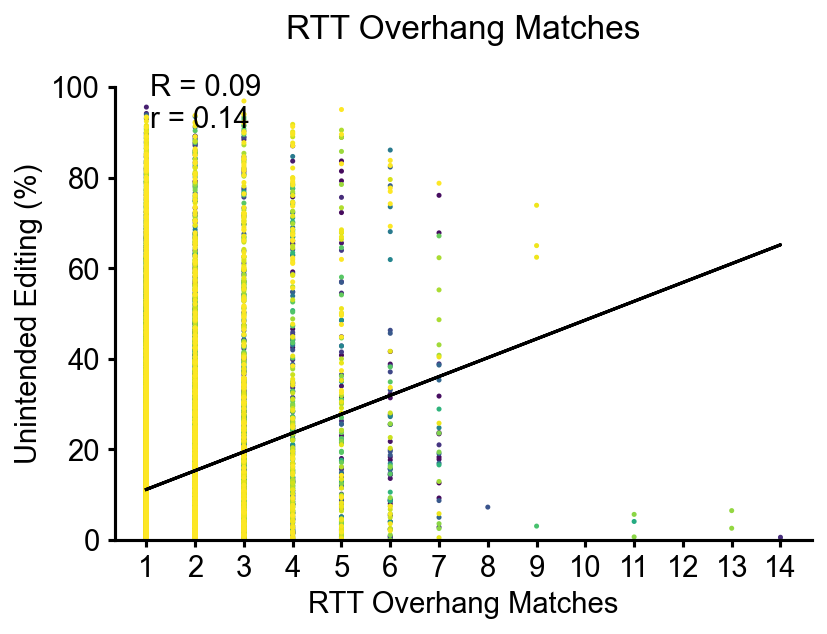

In [31]:
xaxis_column = 'RToverhangmatches'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('RTT Overhang Matches\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('RTT Overhang Matches', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_xticks(range(1,15))
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'RToverhangmatches_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## RTmt vs editing rate

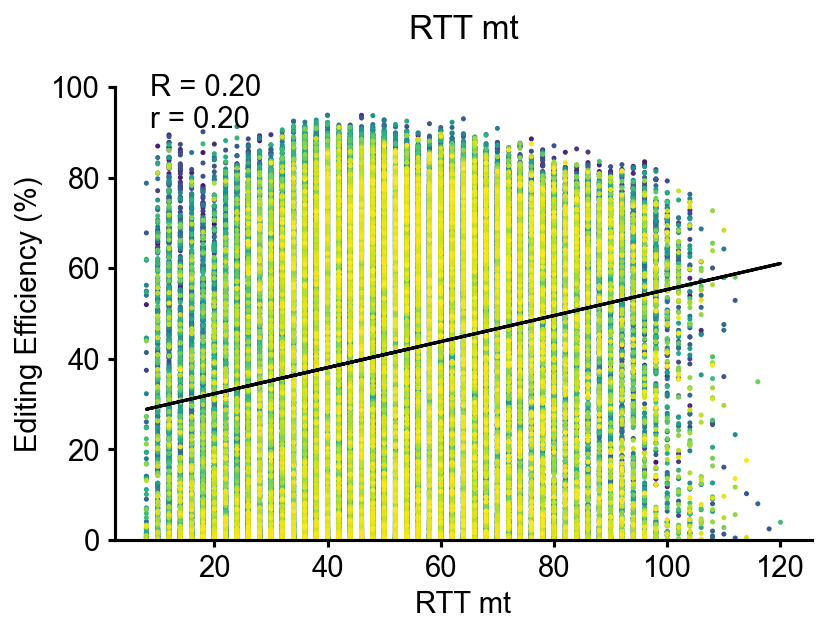

In [32]:
xaxis_column = 'RTmt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('RTT mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('RTT mt', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'RTmt_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## RTmt vs unintended editing rate

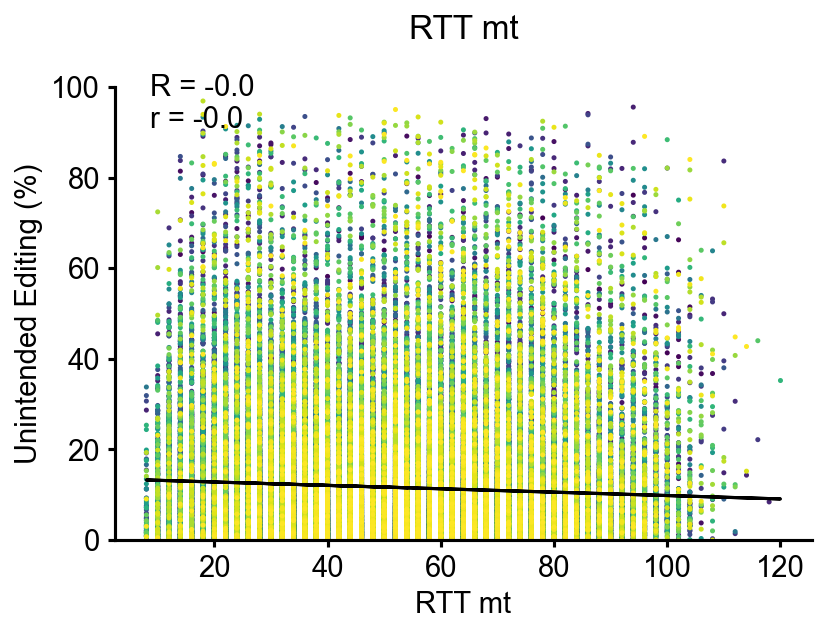

In [33]:
xaxis_column = 'RTmt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('RTT mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('RTT mt', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'RTmt_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## RToverhangmt vs editing rate

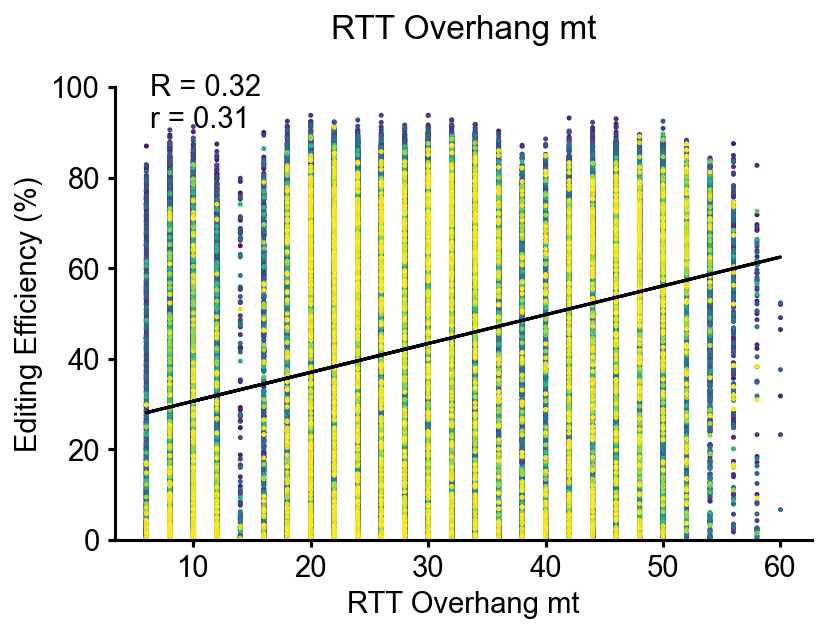

In [34]:
xaxis_column = 'RToverhangmt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('RTT Overhang mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('RTT Overhang mt', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'RToverhangmt_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

C:\Users\nimath\AppData\Local\Temp/ipykernel_16484/848652159.py:37: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax3.set_xticklabels(range(26,54,2))


23
305
1349
3293
7120
12336
17562
19303
16058
10293
3796
865
111
9


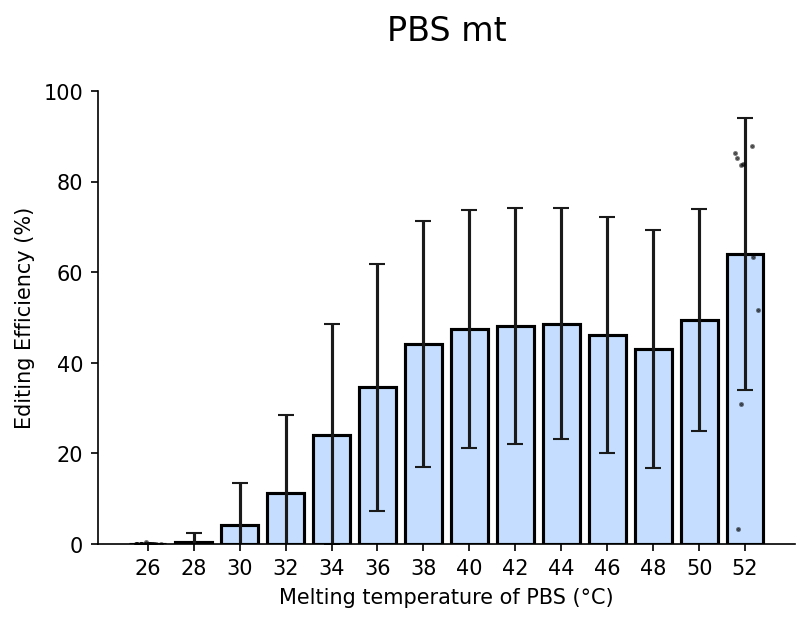

In [75]:
PBStemplist = []
PBSmeanlist = []
PBSstddevlist = []
PBSindividual = []
uniquePBSlengthlist = list(templatedf.PBSmt.unique())
uniquePBSlengthlist = sorted(uniquePBSlengthlist)
for temp in uniquePBSlengthlist:
    PBStemplist.append(str(int(temp)))
    temperaturedf = templatedf[templatedf['PBSmt'] == temp].copy()
    mean = temperaturedf.averageedited.mean()
    std = temperaturedf.averageedited.std()
    individual = list(temperaturedf.averageedited)
    PBSmeanlist.append(mean)
    PBSstddevlist.append(std)
    PBSindividual.append(individual)

sn.reset_orig()
fig2, ax3 = plt.subplots(dpi=150)
ax3.set_title('PBS mt\n', fontsize=16)
ax3.bar(PBStemplist,PBSmeanlist,yerr=PBSstddevlist, **bar_kwargs)
counter = 0
PBS26 = list(templatedf[templatedf['PBSmt'] == 26.0].averageedited)
for i in range(len(PBS26)):
    ax3.scatter(0+(np.random.random(1)-0.5)*0.6, PBS26[counter], s=2, color='black',alpha=0.5,zorder=2)
    counter+=1
    
counter = 0
PBS52 = list(templatedf[templatedf['PBSmt'] == 52.0].averageedited)
for i in range(len(PBS52)):
    ax3.scatter(13+(np.random.random(1)-0.5)*0.6, PBS52[counter], s=2, color='black',alpha=0.5,zorder=2)
    counter+=1
ax3.set_ylabel('Editing Efficiency (%)')
ax3.set_xlabel('Melting temperature of PBS (°C)')
ax3.spines['right'].set_visible(False)
ax3.spines['top'].set_visible(False)
ax3.set(ylim=(0, 100))
ax3.set_xticklabels(range(26,54,2))
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'PBSmt_barplot_editing.png', format='png',
        transparent=True,bbox_inches='tight')

for entry in PBSindividual:
    print(len(entry))

C:\Users\nimath\AppData\Local\Temp/ipykernel_16484/3965418637.py:33: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax3.set_xticklabels(range(6,62,2))


1726
6825
10705
4412
127
695
2347
5251
7164
5964
3943
3868
5043
5441
4151
2127
1277
1460
2448
3468
4015
3968
3021
1858
778
261
72
8


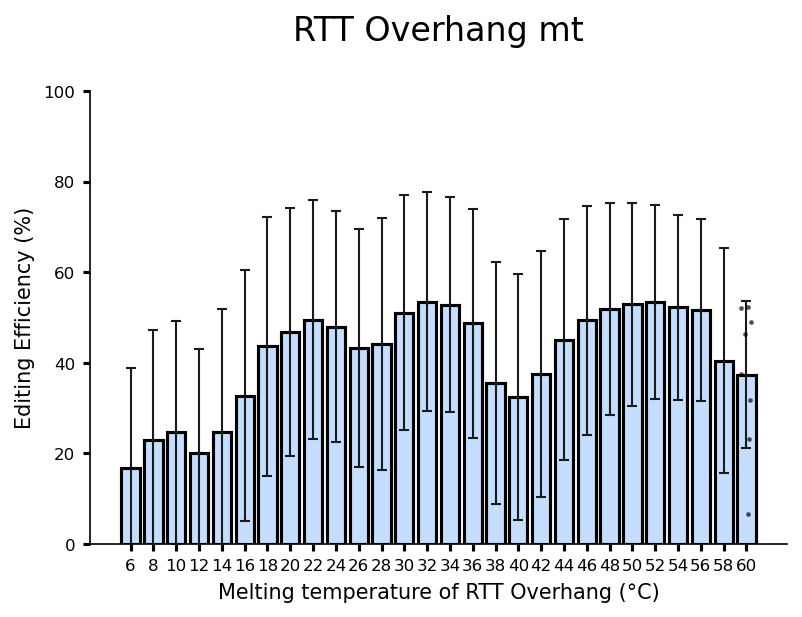

In [90]:
RToverhangtemplist = []
RToverhangmeanlist = []
RToverhangstddevlist = []
RToverhangindividual = []
uniqueRToverhanglengthlist = list(templatedf.RToverhangmt.unique())
uniqueRToverhanglengthlist = sorted(uniqueRToverhanglengthlist)
for temp in uniqueRToverhanglengthlist:
    RToverhangtemplist.append(str(int(temp)))
    temperaturedf = templatedf[templatedf['RToverhangmt'] == temp].copy()
    mean = temperaturedf.averageedited.mean()
    std = temperaturedf.averageedited.std()
    individual = list(temperaturedf.averageedited)
    RToverhangmeanlist.append(mean)
    RToverhangstddevlist.append(std)
    RToverhangindividual.append(individual)


sn.reset_orig()
fig2, ax3 = plt.subplots(dpi=150)
ax3.set_title('RTT Overhang mt\n', fontsize=16)
ax3.bar(RToverhangtemplist,RToverhangmeanlist,yerr=RToverhangstddevlist,error_kw=dict(lw=1, capsize=2.5, capthick=1), **bar_kwargs)

counter = 0
RToverhang60 = list(templatedf[templatedf['RToverhangmt'] == 60.0].averageedited)
for i in range(len(RToverhang60)):
    ax3.scatter(27+(np.random.random(1)-0.5)*0.6, RToverhang60[counter], s=2, color='black',alpha=0.5,zorder=2)
    counter+=1
ax3.set_ylabel('Editing Efficiency (%)')
ax3.set_xlabel('Melting temperature of RTT Overhang (°C)')
ax3.spines['right'].set_visible(False)
ax3.spines['top'].set_visible(False)
ax3.set(ylim=(0, 100))
ax3.set_xticklabels(range(6,62,2))
ax3.tick_params(axis='x', labelsize= 8, width=1.5)
ax3.tick_params(axis='y', labelsize= 8, width=1.5)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'RTTOverhangmt_barplot_editing.png', format='png',
        transparent=True,bbox_inches='tight')

for entry in RToverhangindividual:
    print(len(entry))

In [35]:
xaxis_column = 'RToverhangmt'
x = templatedf[xaxis_column].reset_index(drop=True)
low = templatedf[templatedf['RToverhangmt']<15]['averageedited'].mean()
high = templatedf[templatedf['RToverhangmt']>15]['averageedited'].mean()
print(low, high)

22.761548934862912 47.89552232560143


## RToverhangmt vs unintended editing rate

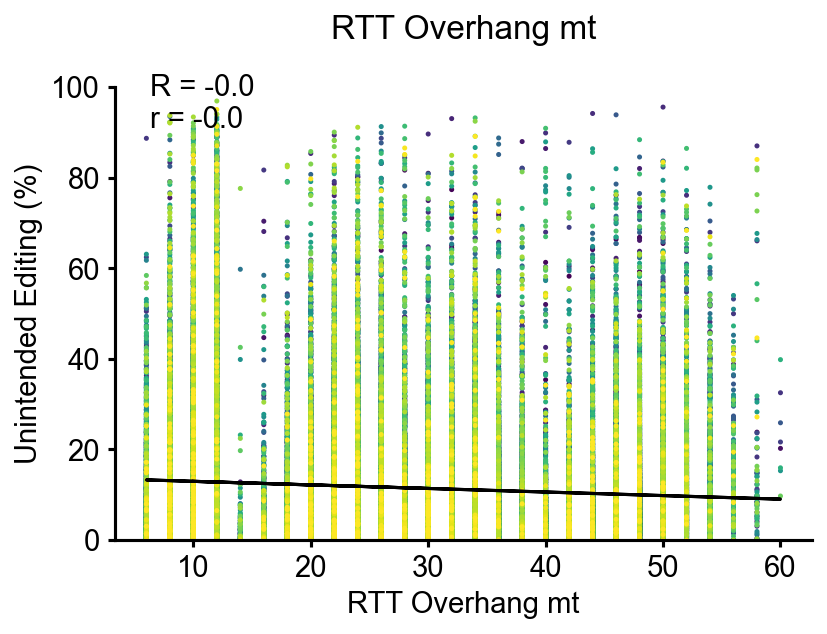

In [36]:
xaxis_column = 'RToverhangmt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('RTT Overhang mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('RTT Overhang mt', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'RToverhangmt_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## PBSmt vs editing rate

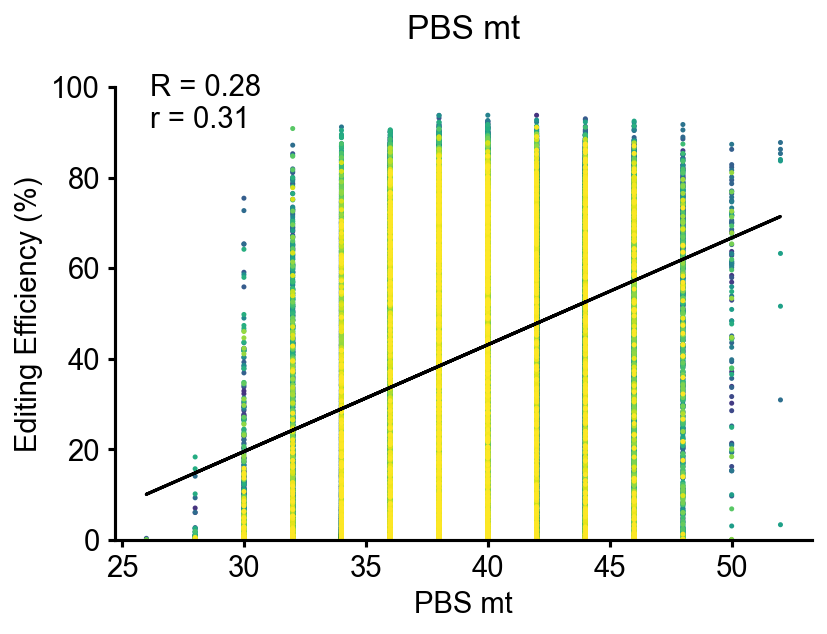

In [37]:
xaxis_column = 'PBSmt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('PBS mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('PBS mt', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'PBSmt_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## PBSmt vs unintended editing rate

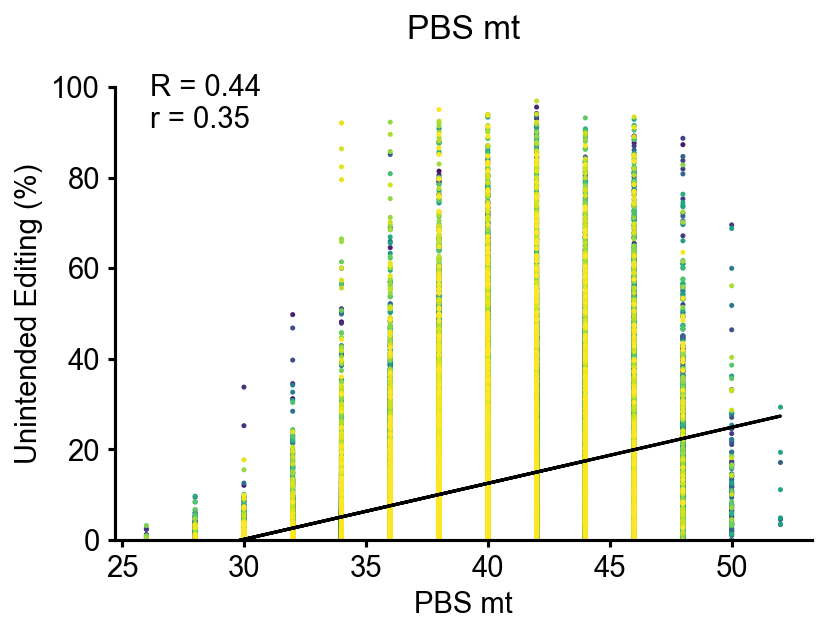

In [38]:
xaxis_column = 'PBSmt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('PBS mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('PBS mt', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'PBSmt_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Protospacermt vs editing rate

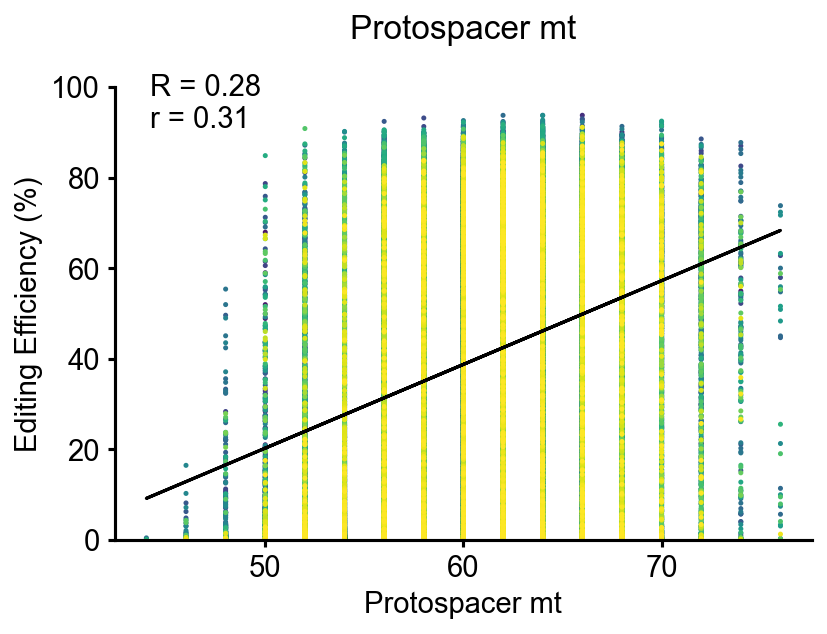

In [39]:
xaxis_column = 'protospacermt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Protospacer mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Protospacer mt', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'protospacermt_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Protospacermt vs unintended editing rate

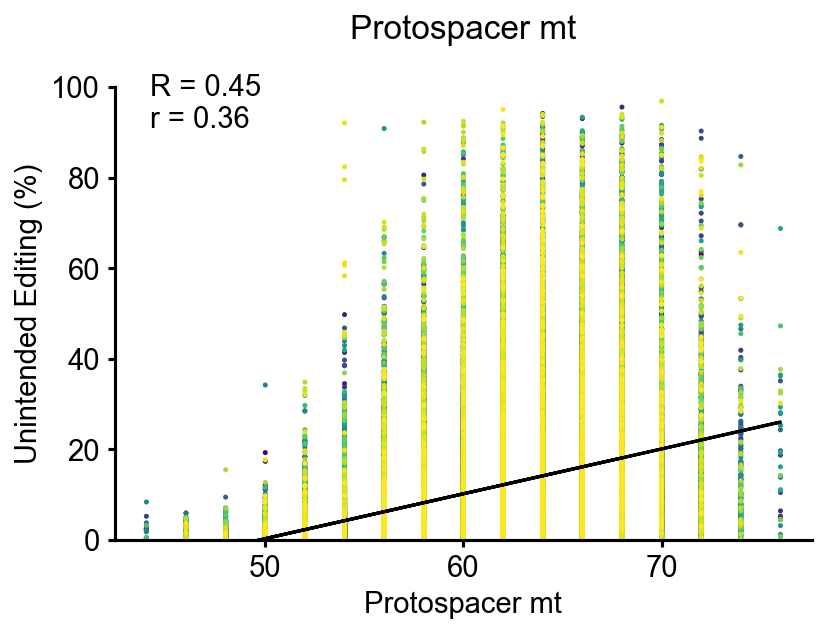

In [40]:
xaxis_column = 'protospacermt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Protospacer mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Protospacer mt', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'protospacermt_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Extensionmt vs editing rate

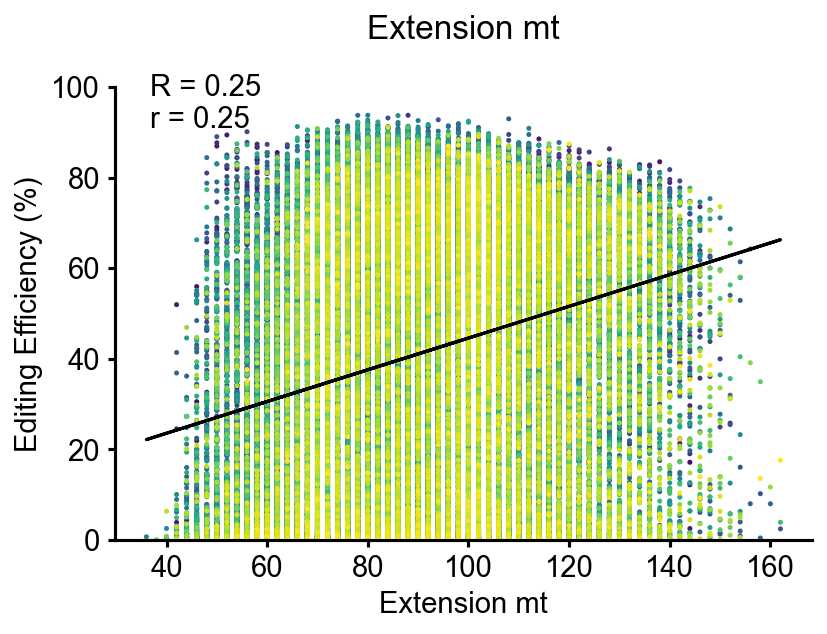

In [41]:
xaxis_column = 'extensionmt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Extension mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Extension mt', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'extensionmt_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()


## Extensionmt vs unintended editing rate

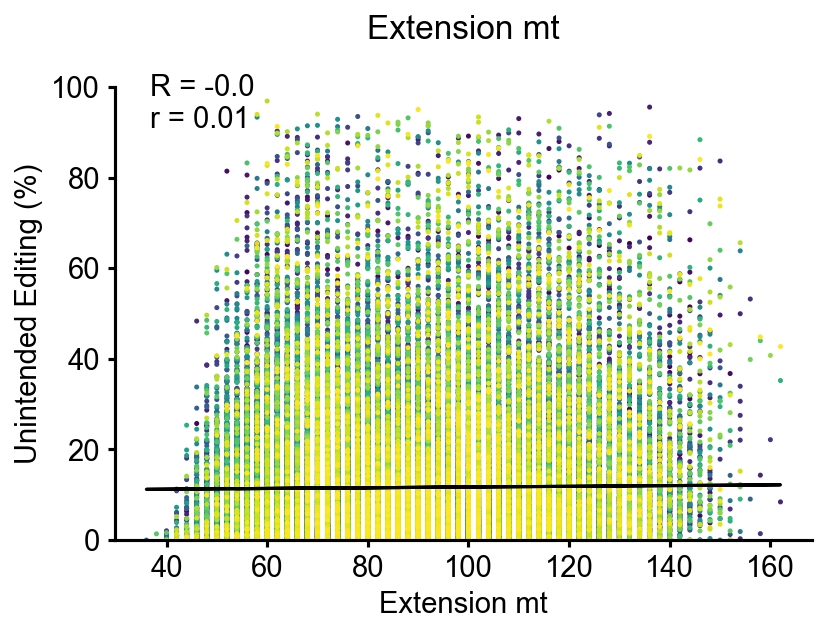

In [42]:
xaxis_column = 'extensionmt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Extension mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Extension mt', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'extensionmt_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()


## Original base mt vs editing rate

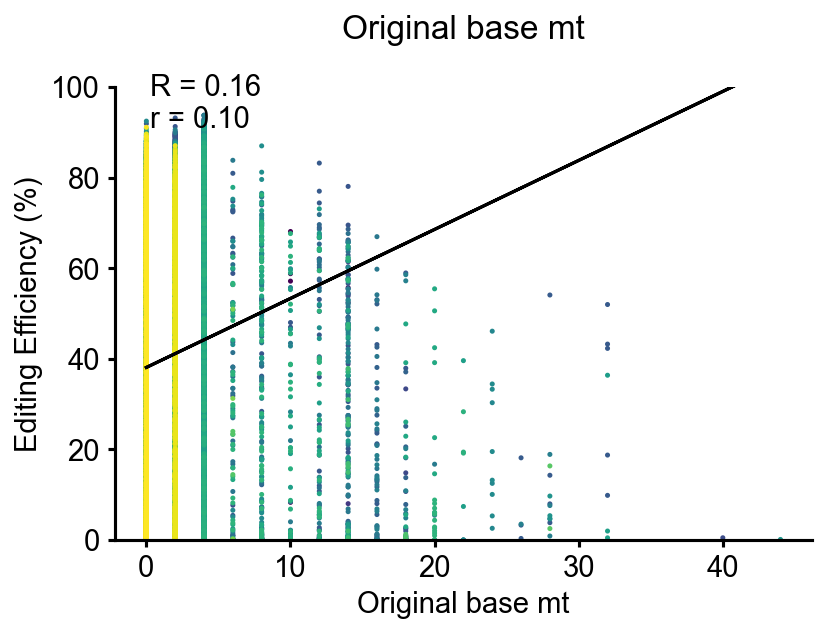

In [43]:
xaxis_column = 'original_base_mt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Original base mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Original base mt', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'original_base_mt_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Original base mt vs unintended editing rate

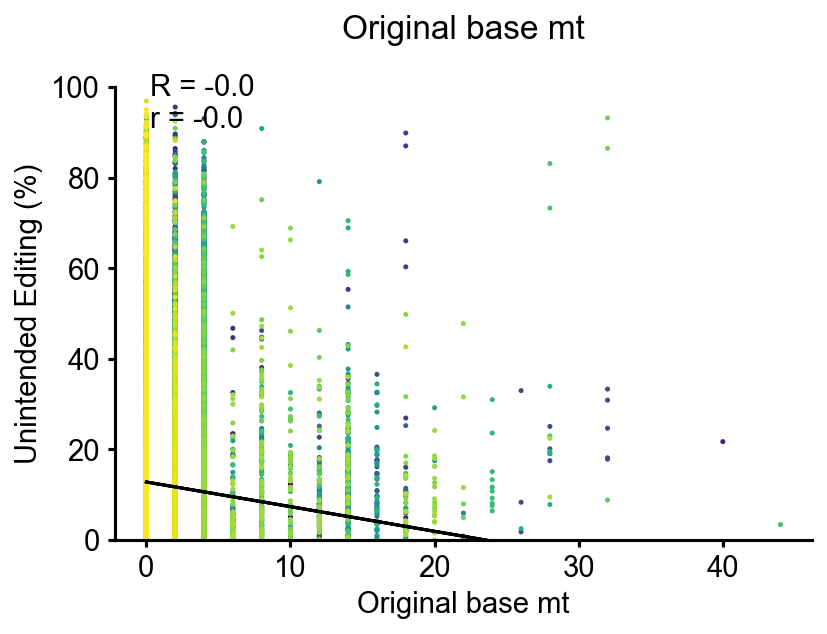

In [44]:
xaxis_column = 'original_base_mt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Original base mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Original base mt', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'original_base_mt_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Edited base mt vs editing rate

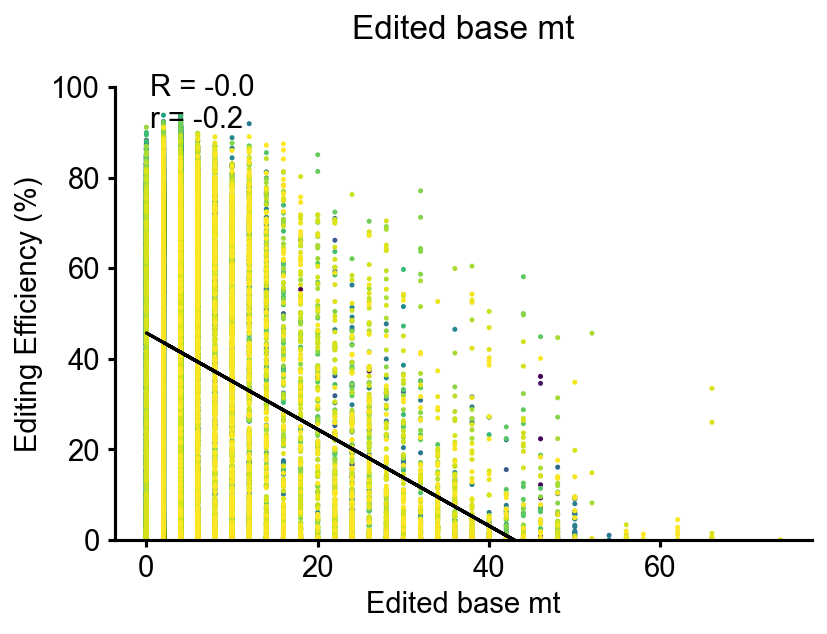

In [45]:
xaxis_column = 'edited_base_mt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Edited base mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Edited base mt', fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'edited_base_mt_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Edited base mt vs unintended editing rate

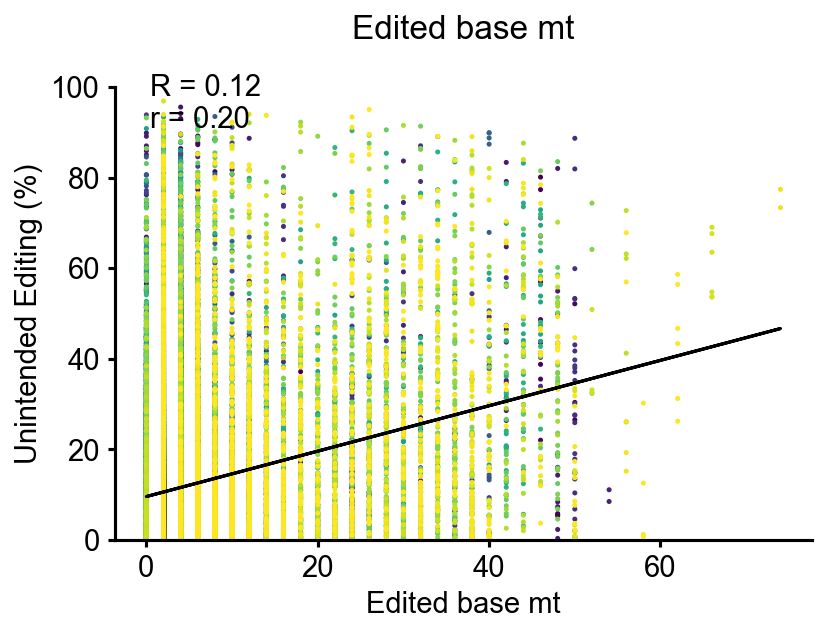

In [46]:
xaxis_column = 'edited_base_mt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
ax7.set_title('Edited base mt\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=2)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel('Edited base mt', fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'edited_base_mt_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## Analysis of GC content in PBS-part

In [47]:
gcpbs = templatedf['PBS_GC_content'].reset_index(drop=True)

editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([gcpbs,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, gcpbsz = gcpbs[idx], editeff[idx], z[idx]
gcextension_R = stats.spearmanr(templatedf['PBS_GC_content'], templatedf['averageedited'])[0]
gcextension_r = stats.pearsonr(templatedf['PBS_GC_content'], templatedf['averageedited'])[0]

## Analysis of polyT vs editing

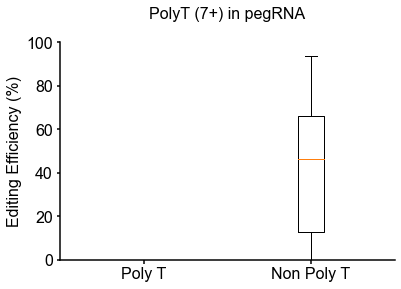

In [48]:
polyT = templatedf[templatedf['polytvalues'] == 'polytvalues']['averageedited']
nonpolyT = templatedf[templatedf['polytvalues'] != 'polytvalues']['averageedited']

editingtypedata = [polyT, nonpolyT]

fig8, ax8 = plt.subplots()
ax8.set_title('PolyT (7+) in pegRNA\n', fontsize=16)
ax8.boxplot(editingtypedata)
ax8.set_xticklabels(['Poly T', 'Non Poly T'])
#ax8.set_xlabel(fontsize=16)
ax8.set_ylabel('Editing Efficiency (%)', fontsize=16)
ax8.tick_params(axis='x', labelsize= 16, width=1.5)
ax8.tick_params(axis='y', labelsize= 16, width=1.5)
ax8.set_ylim(0,100)
ax8.spines['right'].set_visible(False)
ax8.spines['top'].set_visible(False)
  
# show plot
plt.show()

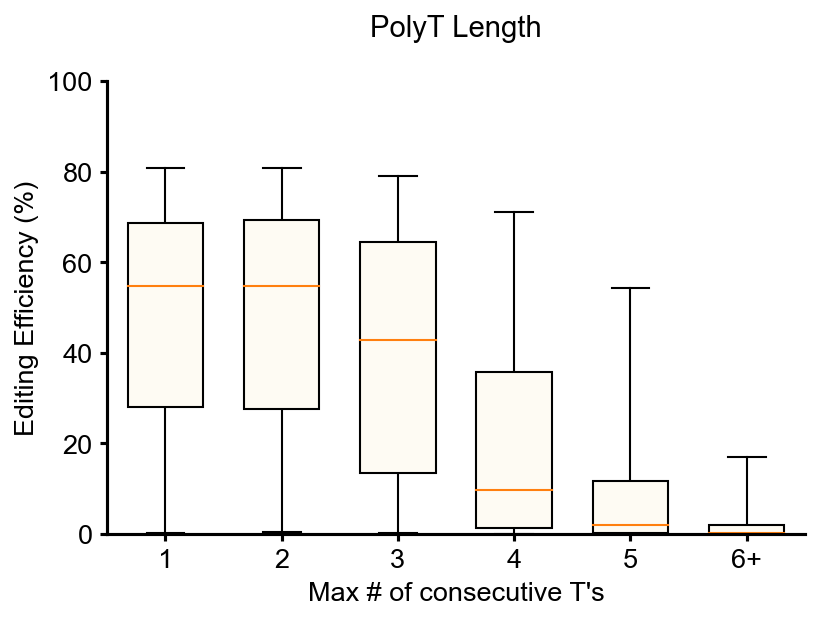

In [169]:
polytoptions= sorted(list(templatedf['polytvalues'].unique()))
polytdata=[]
polypiedata=[]
plus6=[]

flierprops = dict(markeredgecolor='#1d1d1d')
#flierprops = dict(markeredgecolor='black')
#polytlabels=polytoptions
#polytlabels=[0,1,2,3,4,5,'6+']
for entry in polytoptions:
    if entry <6:
        polytdata.append(templatedf[templatedf['polytvalues']==entry]['averageedited'])
        polypiedata.append(len(templatedf[templatedf['polytvalues']==entry]))
    elif entry >= 6:
        plus6.extend(templatedf[templatedf['polytvalues']==entry]['averageedited'])
        
polytdata.append(plus6)
polypiedata.append(len(plus6))
polytlabels = [1,2,3,4,5,'6+'] # rename polytlabels for labelling x-axis correctly

fig30, ax30 = plt.subplots(figsize=(6,4), dpi=150)
ax30.set_title('PolyT Length\n', fontsize=titlesize)
ax30.boxplot(polytdata, showfliers = False, **boxplot_kwargs)
ax30.set_xticklabels(polytlabels)
ax30.set_xlabel("Max # of consecutive T's", fontsize=lsize)
ax30.tick_params(axis='x', labelsize= lsize, width=1.5)
ax30.tick_params(axis='y', labelsize= lsize, width=1.5)
ax30.set_ylim(0,100)
ax30.spines['right'].set_visible(False)
ax30.spines['top'].set_visible(False)
ax30.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'polyt_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

In [171]:
for x in polytdata:
    print(len(x))

12005
42611
24574
9223
2918
1092


In [50]:
templatedf['polytvalues'].unique()

array([4, 1, 2, 3, 5, 6, 7, 8, 9], dtype=int64)

In [51]:
len(polytdata)

6

In [52]:
oneandtwo = polytdata[0].append(polytdata[1])
three = polytdata[2]
four = polytdata[3]
fiveplus = polytdata[4].append(pd.Series(polytdata[5]))
len(oneandtwo)
#print(f'Zero median: {round(zero.median())}')
print(f'OneandTwo median: {round(oneandtwo.median())}')
print(f'Three median: {round(three.median())}')
print(f'Four median: {round(four.median())}')
print(f'Five+ median: {round(fiveplus.median())}')

OneandTwo median: 55
Three median: 43
Four median: 10
Five+ median: 1


## polybase Graph - Editing

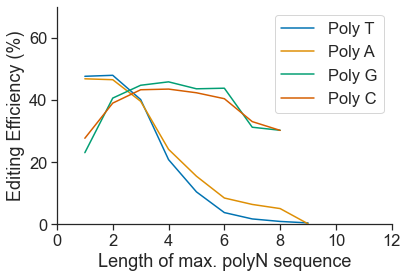

In [53]:
sn.set(font="Arial")
sn.set(font_scale=1.5)
sn.set_style("ticks")
sn.set_palette("colorblind")

fig10, ax = plt.subplots()
ax = sn.lineplot(x='polytvalues', y='averageedited', data=templatedf, label='Poly T', ci=None)
ax = sn.lineplot(x='polyavalues', y='averageedited', data=templatedf, label='Poly A', ci=None)
ax = sn.lineplot(x='polygvalues', y='averageedited', data=templatedf, label='Poly G', ci=None)
ax = sn.lineplot(x='polycvalues', y='averageedited', data=templatedf, label='Poly C', ci=None)
ax.set_ylabel('Editing Efficiency (%)')
ax.set_xlabel('Length of max. polyN sequence')
ax.set(ylim=(0, 70))
ax.set(xlim=(0, 12))
ax.set_yticks([0,20,40,60])
ax.set_xticks(range(0,14,2))
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'polybase_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')

## polybase Graph - Unintended editing

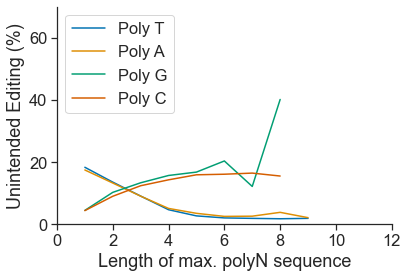

In [54]:
sn.set(font="Arial")
sn.set(font_scale=1.5)
sn.set_style("ticks")
sn.set_palette("colorblind")

fig10, ax = plt.subplots()
ax = sn.lineplot(x='polytvalues', y='averageindel', data=templatedf, label='Poly T', ci=None)
ax = sn.lineplot(x='polyavalues', y='averageindel', data=templatedf, label='Poly A', ci=None)
ax = sn.lineplot(x='polygvalues', y='averageindel', data=templatedf, label='Poly G', ci=None)
ax = sn.lineplot(x='polycvalues', y='averageindel', data=templatedf, label='Poly C', ci=None)
ax.set_ylabel('Unintended Editing (%)')
ax.set_xlabel('Length of max. polyN sequence')
ax.set(ylim=(0, 70))
ax.set(xlim=(0, 12))
ax.set_yticks([0,20,40,60])
ax.set_xticks(range(0,14,2))
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'polybase_unintended_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')

## Editing position vs efficiency

In [55]:
editpos = templatedf['Editing_Position'].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([editpos, editeff])
z = gaussian_kde(xy)(xy)

# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = editpos[idx], editeff[idx], z[idx]
editpos_R = stats.spearmanr(editpos, editeff)[0]
editpos_r = stats.pearsonr(editpos, editeff)[0]

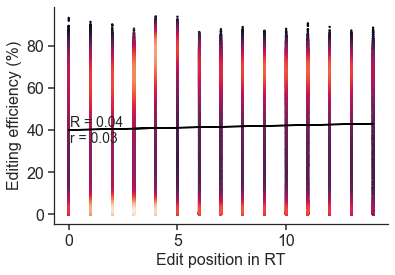

In [56]:
fig9, ax9 = plt.subplots()
plt.rcParams['axes.linewidth'] = 1.5
ax9.scatter(x, y, c=z, s=2)
ax9.tick_params(axis='x', labelsize= 16, width=1.5)
ax9.tick_params(axis='y', labelsize= 16, width=1.5)
ax9.set_xlabel('Edit position in RT', fontsize=16)
ax9.set_ylabel('Editing efficiency (%)', fontsize=16)
ax9.spines['right'].set_visible(False)
ax9.spines['top'].set_visible(False)
ax9.text(0.05, 0.5, 'R = '+str(round(editpos_R,2))+'\nr = '+str(round(editpos_r,2)), transform=ax9.transAxes, fontsize=14,
        verticalalignment='top')
m, b = np.polyfit(templatedf['Editing_Position'], templatedf['averageedited'], 1)
ax9.plot(templatedf['Editing_Position'], m*templatedf['Editing_Position'] + b, color='black')
plt.show()

## Boxplots of editpositions of replacements

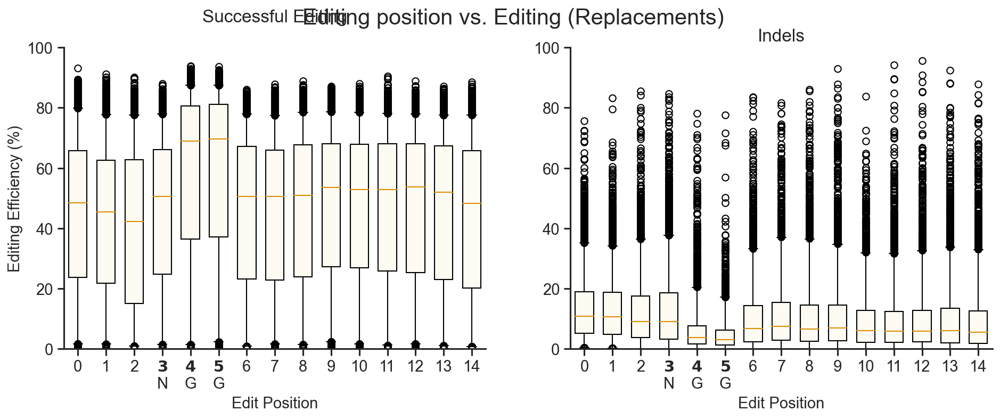

In [57]:
editpos = templatedf['Editing_Position'].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
editpositions = sorted(editpos.unique().tolist())
fig10, (ax10,ax11) = plt.subplots(1,2,figsize=(15,5),dpi=150)
fig10.suptitle('Editing position vs. Editing (Replacements)', fontsize=20)
editingchar = ['averageedited', 'averageindel']
for ind,ax in enumerate(fig10.get_axes()):
    editpositiondata = {}
    for position in editpositions:
        df = templatedf[(templatedf['Editing_Position'] == position)&(templatedf['Correction_Type'] == 'Replacement')][editingchar[ind]]
        editpositiondata[position] = df

    labels, data = [*zip(*editpositiondata.items())]
    # remove editing position 0, since for replacements there is no "0" but it starts with 1
    labels = list(labels)

    data = list(data)

    ax.boxplot(data, **boxplot_kwargs)
    #ax.set_xticklabels(labels)
    ax.set_xticklabels(['0','1','2',r"$\bf{3}$"+'\nN',r"$\bf{4}$"+'\nG',r"$\bf{5}$"+'\nG',"6",'7','8','9','10','11','12','13','14'])
    ax.set_xlabel('Edit Position', fontsize=lsize)
    ax.tick_params(axis='x', labelsize= lsize, width=1.5)
    ax.tick_params(axis='y', labelsize= lsize, width=1.5)
    ax.set_ylim(0,100)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
ax10.set_title('Successful Editing\n', fontsize=titlesize)
ax11.set_title('Indels', fontsize=titlesize)
ax10.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
#ax10.set_xticklabels(['1','2','3','4\nN',r"$\bf{5}$"+'\nG',r"$\bf{6}$"+'\nG','7','8','9','10','11','12','13','14','15'])
#r"$\bf{"+xticklist[entry['proto_position']-1]+"}$"

# show plot
plt.show()

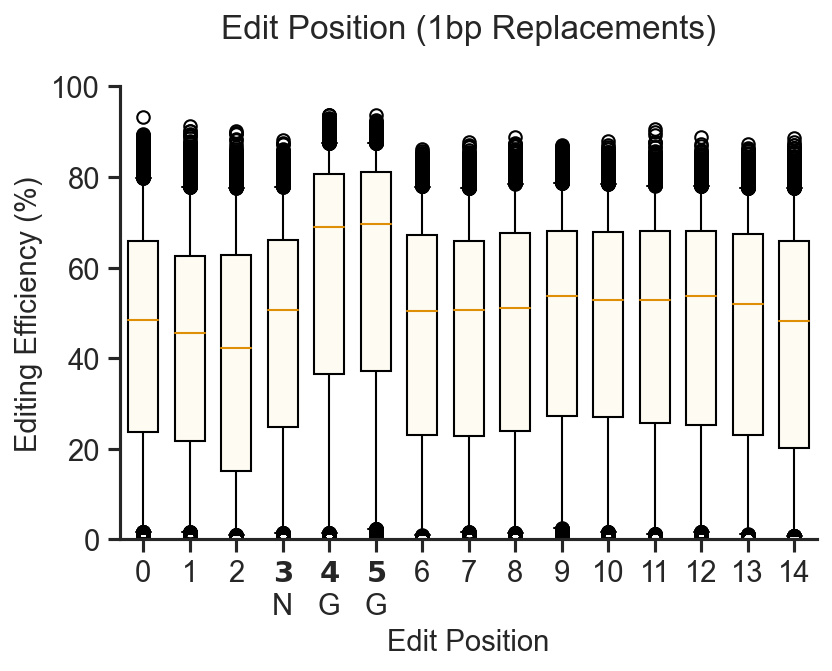

In [58]:
editpos = templatedf['Editing_Position'].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
editpositions = sorted(editpos.unique().tolist())
fig10, (ax10) = plt.subplots(1,1,figsize=(6,4),dpi=150)
editingchar = ['averageedited']
for ind,ax in enumerate(fig10.get_axes()):
    editpositiondata = {}
    for position in editpositions:
        df = templatedf[(templatedf['Editing_Position'] == position)&(templatedf['Correction_Type'] == 'Replacement')][editingchar[ind]]
        editpositiondata[position] = df

    labels, data = [*zip(*editpositiondata.items())]
    # remove editing position 0, since for replacements there is no "0" but it starts with 1
    labels = list(labels)

    data = list(data)

    ax.boxplot(data, **boxplot_kwargs)
    #ax.set_xticklabels(labels)
    ax.set_xticklabels(['0','1','2',r"$\bf{3}$"+'\nN',r"$\bf{4}$"+'\nG',r"$\bf{5}$"+'\nG',"6",'7','8','9','10','11','12','13','14'])
    ax.set_xlabel('Edit Position', fontsize=lsize)
    ax.tick_params(axis='x', labelsize= lsize, width=1.5)
    ax.tick_params(axis='y', labelsize= lsize, width=1.5)
    ax.set_ylim(0,100)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
ax10.set_title('Edit Position (1bp Replacements)\n', fontsize=titlesize)
ax10.set_ylabel('Editing Efficiency (%)', fontsize=lsize)

figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'replacementposition_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
# show plot
plt.show()

## Boxplots of editpositions of insertions

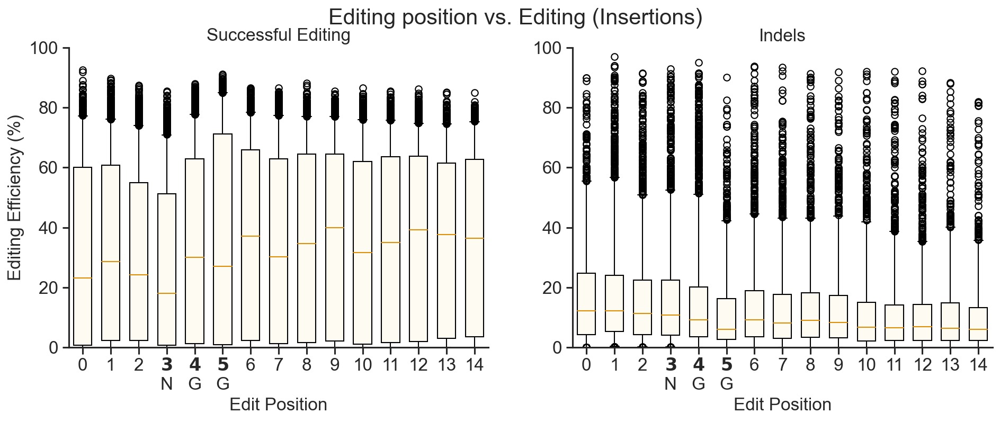

In [59]:
editpositions = sorted(editpos.unique().tolist())
fig10, (ax10,ax11) = plt.subplots(1,2,figsize=(15,5),dpi=150)
fig10.suptitle('Editing position vs. Editing (Insertions)', fontsize=20)
editingchar = ['averageedited', 'averageindel']
for ind,ax in enumerate(fig10.get_axes()):
    editpositiondata = {}
    for position in editpositions:
        df = templatedf[(templatedf['Editing_Position'] == position)&(templatedf['Correction_Type'] == 'Insertion')][editingchar[ind]]
        editpositiondata[position] = df

    labels, data = [*zip(*editpositiondata.items())]
    # remove editing position 0, since for replacements there is no "0" but it starts with 1
    labels = list(labels)
    data = list(data)
    ax.boxplot(data, **boxplot_kwargs)
    #ax.set_xticklabels(labels)
    ax.set_xticklabels(['0','1','2',r"$\bf{3}$"+'\nN',r"$\bf{4}$"+'\nG',r"$\bf{5}$"+'\nG',"6",'7','8','9','10','11','12','13','14'])
    ax.set_xlabel('Edit Position', fontsize=16)
    ax.tick_params(axis='x', labelsize= 16, width=1.5)
    ax.tick_params(axis='y', labelsize= 16, width=1.5)
    ax.set_ylim(0,100)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
ax10.set_title('Successful Editing', fontsize=16)
ax11.set_title('Indels', fontsize=16)
ax10.set_ylabel('Editing Efficiency (%)', fontsize=16)
#ax10.set_xticklabels(['1','2','3','4\nN',r"$\bf{5}$"+'\nG',r"$\bf{6}$"+'\nG','7','8','9','10','11','12','13','14','15'])
#r"$\bf{"+xticklist[entry['proto_position']-1]+"}$"

# show plot
plt.show()

## Last RT nucleotide vs. Editing Efficiency

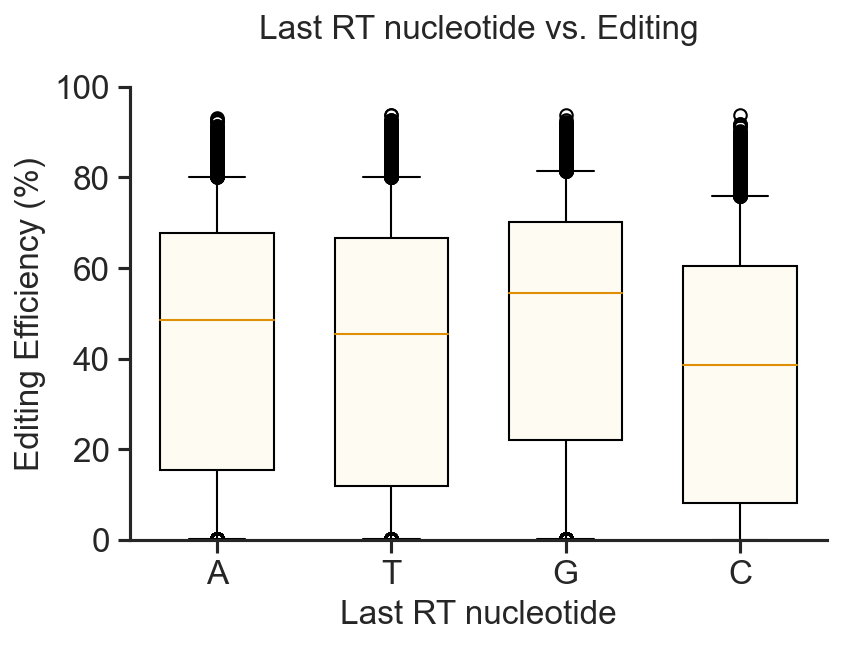

In [60]:
# flapbasebefore_revcomp corresponds to the last nucleotide of the reversetemplate (on the RNA, not the revcomp DNA counterpart! same convention as in Anzalone et al.)


A = templatedf[templatedf['flapbasebefore_revcomp'] == 'A']['averageedited']
T = templatedf[templatedf['flapbasebefore_revcomp'] == 'T']['averageedited']
G = templatedf[templatedf['flapbasebefore_revcomp'] == 'G']['averageedited']
C = templatedf[templatedf['flapbasebefore_revcomp'] == 'C']['averageedited']

lastRTnucdata = [A,T,G,C]

fig11, ax11 = plt.subplots(dpi=150)
ax11.set_title('Last RT nucleotide vs. Editing\n', fontsize=16)
ax11.boxplot(lastRTnucdata, **boxplot_kwargs)
ax11.set_xticklabels(['A','T','G','C'])
ax11.set_xlabel('Last RT nucleotide', fontsize=16)
ax11.set_ylabel('Editing Efficiency (%)', fontsize=16)
ax11.tick_params(axis='x', labelsize= 16, width=1.5)
ax11.tick_params(axis='y', labelsize= 16, width=1.5)
ax11.set_ylim(0,100)
ax11.spines['right'].set_visible(False)
ax11.spines['top'].set_visible(False)
# show plot
plt.show()

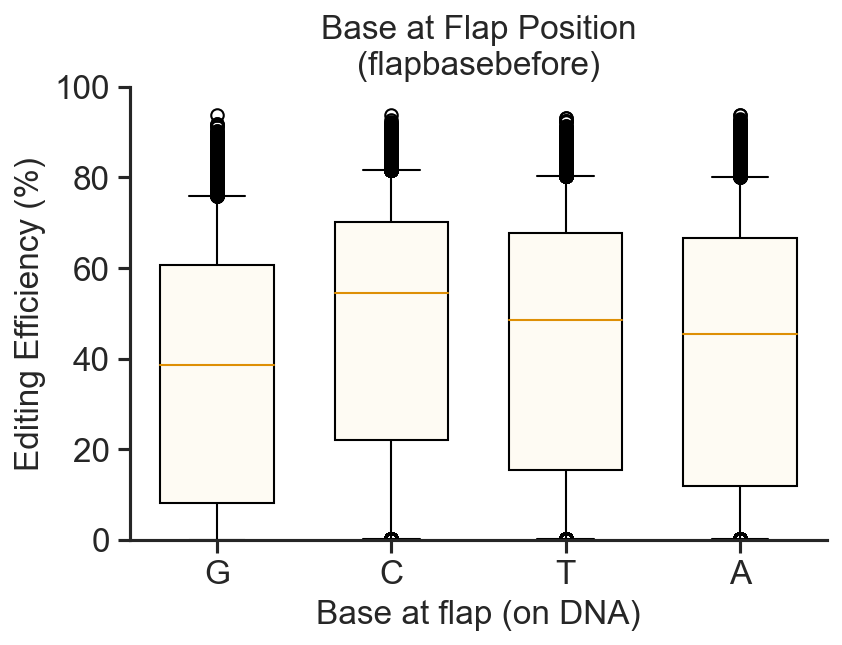

In [61]:
A = templatedf[templatedf['flapbasebefore'] == 'A']['averageedited']
T = templatedf[templatedf['flapbasebefore'] == 'T']['averageedited']
G = templatedf[templatedf['flapbasebefore'] == 'G']['averageedited']
C = templatedf[templatedf['flapbasebefore'] == 'C']['averageedited']

flapbasebeforelist = [G,C,T,A]

fig11, ax11 = plt.subplots(dpi=150)
ax11.set_title('Base at Flap Position\n(flapbasebefore)', fontsize=16)
ax11.boxplot(flapbasebeforelist,**boxplot_kwargs)
ax11.set_xticklabels(['G','C','T','A'])
ax11.set_xlabel('Base at flap (on DNA)', fontsize=16)
ax11.set_ylabel('Editing Efficiency (%)', fontsize=16)
ax11.tick_params(axis='x', labelsize= 16, width=1.5)
ax11.tick_params(axis='y', labelsize= 16, width=1.5)
ax11.set_ylim(0,100)
ax11.spines['right'].set_visible(False)
ax11.spines['top'].set_visible(False)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'flapbasebefore_matplotlib_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

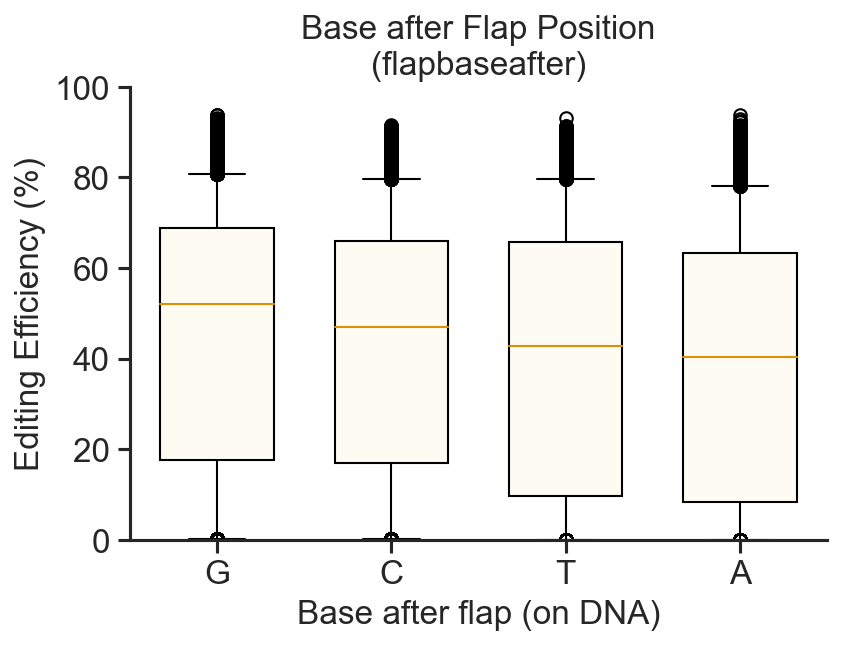

In [62]:
A = templatedf[templatedf['flapbaseafter'] == 'A']['averageedited']
T = templatedf[templatedf['flapbaseafter'] == 'T']['averageedited']
G = templatedf[templatedf['flapbaseafter'] == 'G']['averageedited']
C = templatedf[templatedf['flapbaseafter'] == 'C']['averageedited']

flapbaseafterlist = [G,C,T,A]

fig11, ax11 = plt.subplots(dpi=150)
ax11.set_title('Base after Flap Position\n(flapbaseafter)', fontsize=16)
ax11.boxplot(flapbaseafterlist,**boxplot_kwargs)
ax11.set_xticklabels(['G','C','T','A'])
ax11.set_xlabel('Base after flap (on DNA)', fontsize=16)
ax11.set_ylabel('Editing Efficiency (%)', fontsize=16)
ax11.tick_params(axis='x', labelsize= 16, width=1.5)
ax11.tick_params(axis='y', labelsize= 16, width=1.5)
ax11.set_ylim(0,100)
ax11.spines['right'].set_visible(False)
ax11.spines['top'].set_visible(False)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'flapbaseafter_matplotlib_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

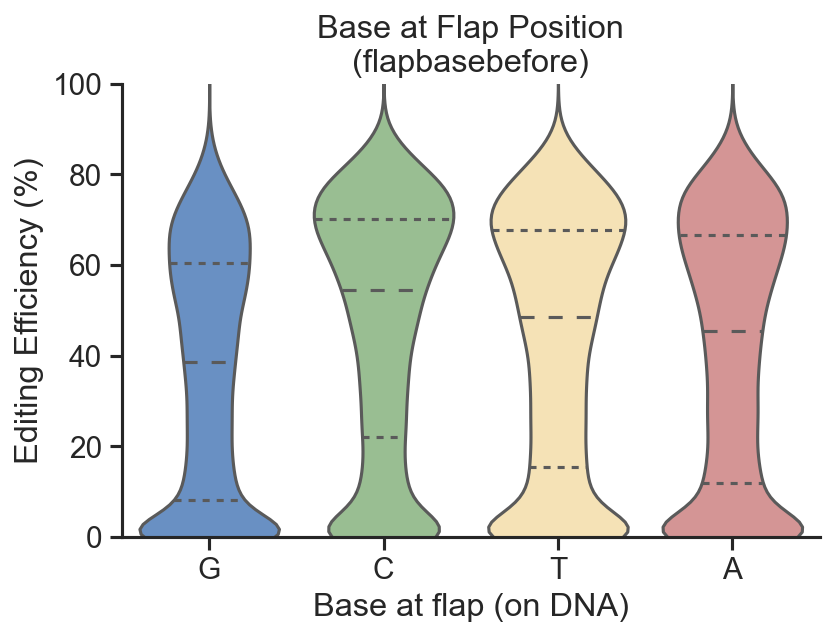

In [34]:
plt.figure(dpi= 150)
sn.set(font_scale = 1.3)
sn.set_style("ticks")
my_pal = {"G": "#5A8ED2", "C": "#94C58B", "T": "#FFE6AC", "A": "#DE8B8B"}
p = sn.violinplot(x='flapbasebefore', y='averageedited', data=templatedf, scale='width', inner='quartile', order=[ "G","C","T","A"], palette=my_pal)
sn.despine() 
p.set_xlabel("Base at flap (on DNA)")
p.set_ylabel("Editing Efficiency (%)")
p.set_title("Base at Flap Position\n(flapbasebefore)")
p.set_ylim(0,100)
for _,s in p.spines.items():
    s.set_linewidth(axesthickness)
p.xaxis.set_tick_params(width=axesthickness)
p.yaxis.set_tick_params(width=axesthickness)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'flapbasebefore_seaborn_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')

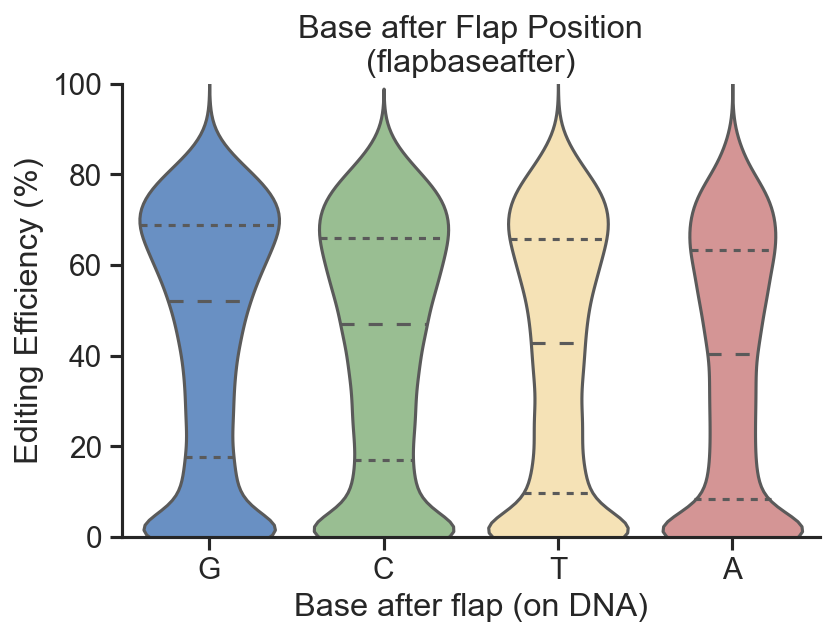

In [35]:
plt.figure(dpi= 150)
sn.set(font_scale = 1.3)
sn.set_style("ticks")
my_pal = {"G": "#5A8ED2", "C": "#94C58B", "T": "#FFE6AC", "A": "#DE8B8B"}
p = sn.violinplot(x='flapbaseafter', y='averageedited', data=templatedf, scale='width', inner='quartile', order=[ "G","C","T","A"], palette=my_pal)
sn.despine() 
p.set_xlabel("Base after flap (on DNA)")
p.set_ylabel("Editing Efficiency (%)")
p.set_title("Base after Flap Position\n(flapbaseafter)")
p.set_ylim(0,100)
for _,s in p.spines.items():
    s.set_linewidth(axesthickness)
p.xaxis.set_tick_params(width=axesthickness)
p.yaxis.set_tick_params(width=axesthickness)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'flapbaseafter_seaborn_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')

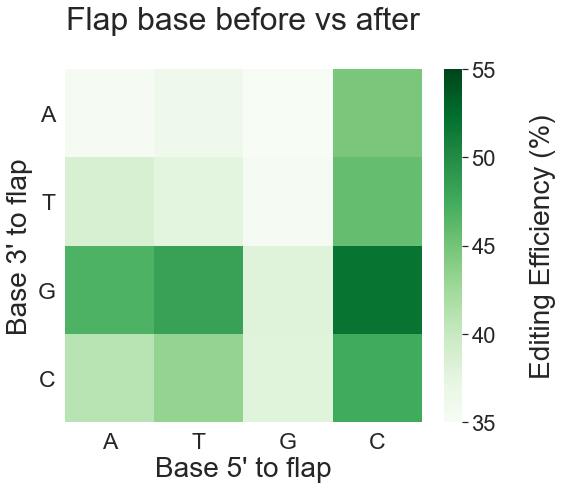

In [36]:
sn.set(font_scale=2)
basebeforelist = ['A','T','G','C']
baseafterlist = ['A','T','G','C']
motif3bpheatmaparray = np.empty([4,4])
for basebeforeindex, basebefore in enumerate(basebeforelist):
    for baseafterindex, baseafter in enumerate(baseafterlist):
        editrates = templatedf[(templatedf['flapbasebefore'] == basebefore)&(templatedf['flapbaseafter'] ==baseafter)]['averageedited']
        motif3bpheatmaparray[baseafterindex, basebeforeindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(8,6.5))
ax.set_title('Flap base before vs after\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Greens", as_cmap=True)

ax = sn.heatmap(motif3bpheatmaparray,cmap=cmap,cbar_kws={'label': '\nEditing Efficiency (%)','ticks':[35,40,45,50,55]},vmin=35,vmax=55)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = basebeforelist
plt.xticks(np.arange(len(basebeforelist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = baseafterlist
plt.yticks(np.arange(len(baseafterlist)) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel("Base 5' to flap", fontsize=28)
ax.set_ylabel("Base 3' to flap", fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'flapbasebefore_after_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

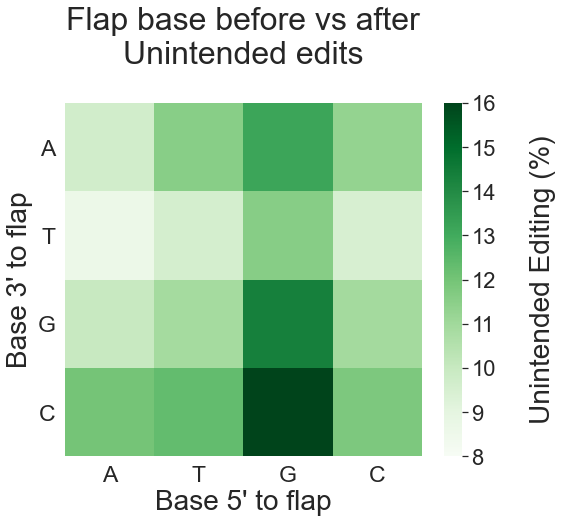

In [37]:

sn.set(font_scale=2)
basebeforelist = ['A','T','G','C']
baseafterlist = ['A','T','G','C']
motif3bpheatmaparray = np.empty([4,4])
for basebeforeindex, basebefore in enumerate(basebeforelist):
    for baseafterindex, baseafter in enumerate(baseafterlist):
        editrates = templatedf[(templatedf['flapbasebefore'] == basebefore)&(templatedf['flapbaseafter'] ==baseafter)]['averageindel']
        motif3bpheatmaparray[baseafterindex, basebeforeindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(8,6.5))
ax.set_title('Flap base before vs after\nUnintended edits\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Greens", as_cmap=True)

ax = sn.heatmap(motif3bpheatmaparray,cmap=cmap,cbar_kws={'label': '\nUnintended Editing (%)'},vmin=8,vmax=16)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = basebeforelist
plt.xticks(np.arange(len(basebeforelist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = baseafterlist
plt.yticks(np.arange(len(baseafterlist)) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel("Base 5' to flap", fontsize=28)
ax.set_ylabel("Base 3' to flap", fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'indel_flapbasebefore_after_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

In [38]:
templatedf[(templatedf['flapbaseafter'] =='G')]['averageindel'].mean()

11.845928304944177

In [39]:
templatedf[(templatedf['flapbaseafter'] =='T')]['averageindel'].mean()

9.859770314755924

## Base on targetsequence AFTER flap (on DNA)

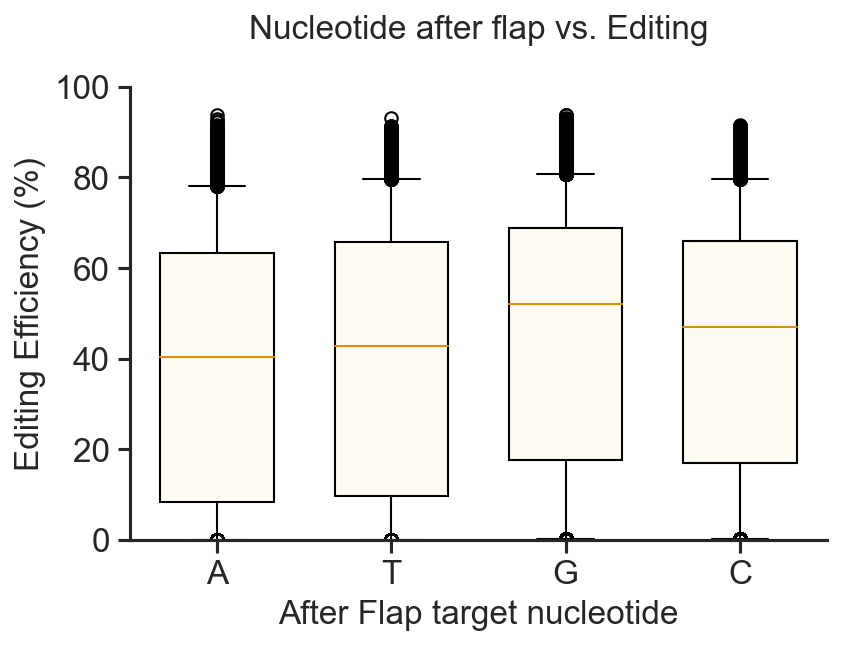

In [63]:
A = templatedf[templatedf['flapbaseafter'] == 'A']['averageedited']
T = templatedf[templatedf['flapbaseafter'] == 'T']['averageedited']
G = templatedf[templatedf['flapbaseafter'] == 'G']['averageedited']
C = templatedf[templatedf['flapbaseafter'] == 'C']['averageedited']

flapbaseafter = [A,T,G,C]

fig11, ax11 = plt.subplots(dpi=150)
ax11.set_title('Nucleotide after flap vs. Editing\n', fontsize=16)
ax11.boxplot(flapbaseafter, **boxplot_kwargs)
ax11.set_xticklabels(['A','T','G','C'])
ax11.set_xlabel('After Flap target nucleotide', fontsize=16)
ax11.set_ylabel('Editing Efficiency (%)', fontsize=16)
ax11.tick_params(axis='x', labelsize= 16, width=1.5)
ax11.tick_params(axis='y', labelsize= 16, width=1.5)
ax11.set_ylim(0,100)
ax11.spines['right'].set_visible(False)
ax11.spines['top'].set_visible(False)
# show plot
plt.show()

## Influence of flanking bases on replacement edits (motifs)

In [64]:
editmotiflist = []
editmotifdict = {}
for index, row in templatedf.iterrows():
    if row['Correction_Type'] == 'Replacement':
        #print(row['AlternateAllele'])
        #print(row['Disease_Block'][-47-row['Editing_Position']:-44-row['Editing_Position']])
        #editmotif = str(Seq(row['Disease_Block'][-47-row['Editing_Position']:-44-row['Editing_Position']]).reverse_complement())
        # sort editmotif by adjacent bases (before and after)
        editmotif = str(Seq(row['Disease_Block'][-45-(row['Editing_Position']+1):-44-(row['Editing_Position']+1)]).reverse_complement()) + 'N' + str(Seq(row['Disease_Block'][-47-(row['Editing_Position']+1):-46-(row['Editing_Position']+1)]).reverse_complement())
        editmotiflist.append(editmotif)
        if editmotif in editmotifdict:
            editmotifdict[editmotif].append(row['averageedited'])
        else:
            editmotifdict[editmotif] = [row['averageedited']]
    else:
        editmotiflist.append('')
templatedf['editmotifs'] = editmotiflist
averagelist=[]
motiflenlist=[]
for key in editmotifdict:
    averagelist.append(sum(editmotifdict[key])/len(editmotifdict[key]))
    motiflenlist.append(len(editmotifdict[key]))
    #print(key,sum(editmotifdict[key])/len(editmotifdict[key]),len(editmotifdict[key]))
editmotifdf = pd.DataFrame()
editmotifdf['Motif'] = list(editmotifdict.keys())
editmotifdf['averagemotifditing']=averagelist
editmotifdf['Motifcount'] = motiflenlist
editmotifdf['targetbase'] = editmotifdf['Motif'].apply(lambda x: x[1])
editmotifdf.sort_values(by=['averagemotifditing'], ascending=False, inplace=True)

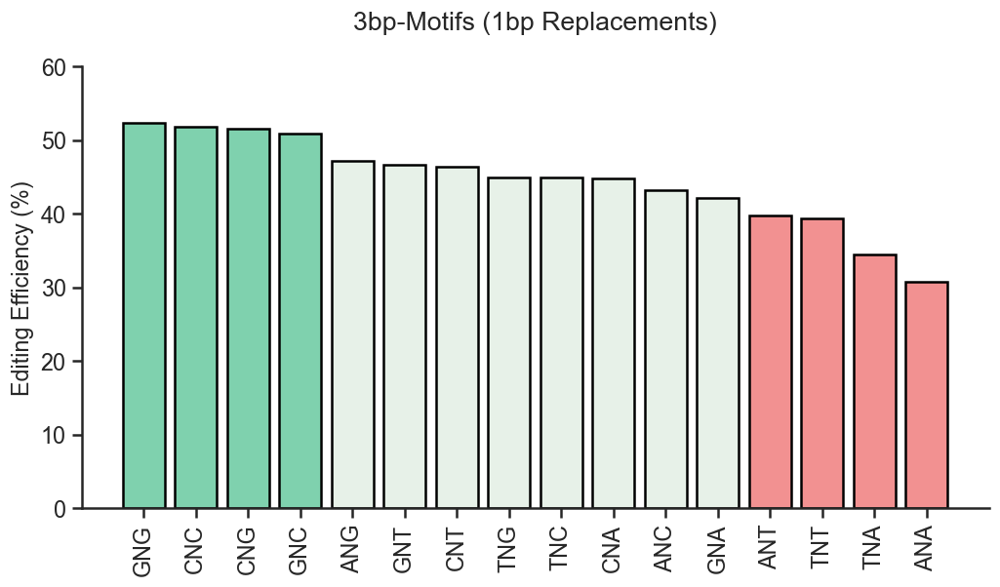

In [65]:
#fig21, (ax21, ax22, ax23, ax24) = plt.subplots(1,4, figsize = (24, 5),dpi=120)


fig21, ax21 = plt.subplots(1,1, figsize = (10, 5),dpi=120)
#fig21.suptitle('Motif vs Editing Rates (1bp Replacements)', fontsize=20)
ax21.set_title('3bp-Motifs (1bp Replacements)\n', fontsize=titlesize)
#editingchar = ['averageedited', 'averageindel']
labels = editmotifdf['Motif']
data = editmotifdf['averagemotifditing']
barchart = ax21.bar(labels,data, **bar_kwargs)
for barnr in range(4):
    barchart[barnr].set_facecolor('#7FD1AE')
for barnr in range(4,12):
    barchart[barnr].set_facecolor('#E7F1E8')
for barnr in range(-4,0,1):
    barchart[barnr].set_facecolor('#F29191')
#ax21.set_title(targetbases[ind], fontsize=16)
ax21.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax21.tick_params(axis='x', labelsize= lsize, width=1.5)
ax21.tick_params(axis='y', labelsize= lsize, width=1.5)
ax21.spines['right'].set_visible(False)
ax21.spines['top'].set_visible(False)
ax21.tick_params(axis='x', labelrotation=90)
ax21.set_ylim(0,60)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'motif_replacements_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

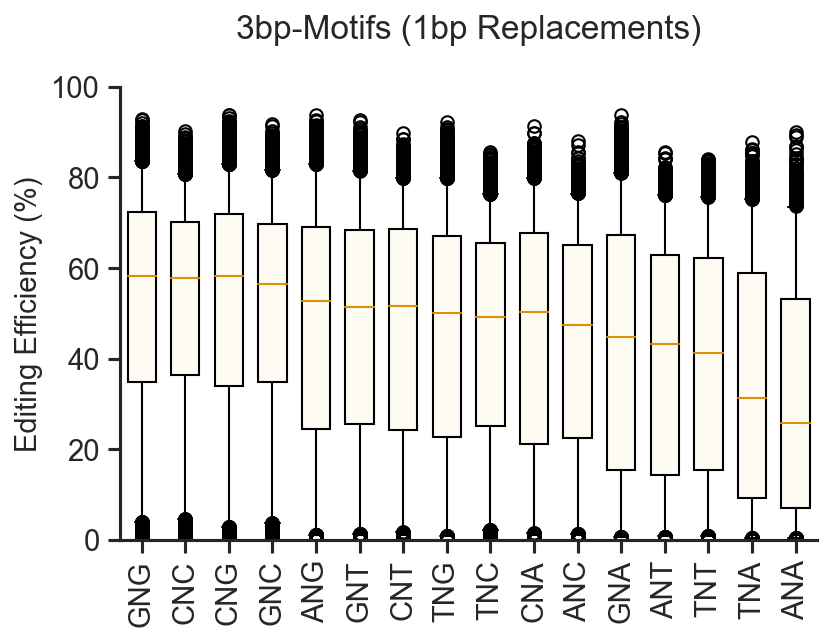

In [66]:
motifboxplotlist = []
for motif in list(editmotifdf['Motif']):
    motifboxplotlist.append(editmotifdict[motif])


fig11, ax11 = plt.subplots(dpi=150)
ax11.set_title('3bp-Motifs (1bp Replacements)\n', fontsize=titlesize)
ax11.boxplot(motifboxplotlist,**boxplot_kwargs)
ax11.set_xticklabels(list(editmotifdf['Motif']))
#ax11.set_xlabel('Last RT nucleotide', fontsize=16)
ax11.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax11.tick_params(axis='x', labelsize= lsize, width=1.5)
ax11.tick_params(axis='y', labelsize= lsize, width=1.5)
ax11.spines['right'].set_visible(False)
ax11.spines['top'].set_visible(False)
ax11.tick_params(axis='x', labelrotation=90)
#ax11.set_ylim(0,70)
ax11.set_ylim(0,100)
# show plot
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'motif_replacements_editing_boxplot.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

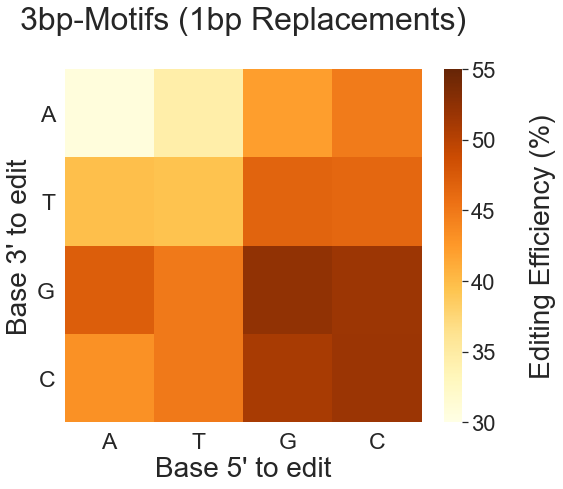

In [40]:
sn.set(font_scale=2)
basebeforelist = ['A','T','G','C']
baseafterlist = ['A','T','G','C']
motif3bpheatmaparray = np.empty([4,4])
for basebeforeindex, basebefore in enumerate(basebeforelist):
    for baseafterindex, baseafter in enumerate(baseafterlist):
        editrates = templatedf[(templatedf['Correction_Type'] == 'Replacement')&(templatedf['basebefore'] == basebefore)&(templatedf['baseafter'] ==baseafter)]['averageedited']
        motif3bpheatmaparray[baseafterindex, basebeforeindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(8,6.5))
ax.set_title('3bp-Motifs (1bp Replacements)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("YlOrBr", as_cmap=True)

ax = sn.heatmap(motif3bpheatmaparray,cmap=cmap,cbar_kws={'label': '\nEditing Efficiency (%)'},vmin=30, vmax=55)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = basebeforelist
plt.xticks(np.arange(len(basebeforelist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = baseafterlist
plt.yticks(np.arange(len(baseafterlist)) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel("Base 5' to edit", fontsize=28)
ax.set_ylabel("Base 3' to edit", fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\01_Overview_Features\\'
plt.savefig(figurepath+'basebefore_baseafter_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

## 3bp-motif - Unintended Editing

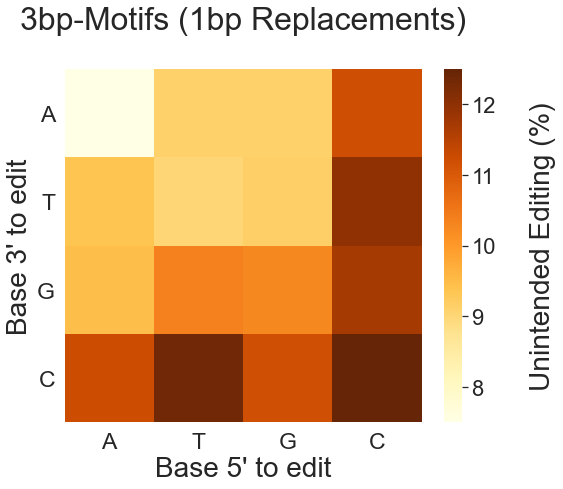

In [41]:
sn.set(font_scale=2)
basebeforelist = ['A','T','G','C']
baseafterlist = ['A','T','G','C']
motif3bpheatmaparray = np.empty([4,4])
for basebeforeindex, basebefore in enumerate(basebeforelist):
    for baseafterindex, baseafter in enumerate(baseafterlist):
        editrates = templatedf[(templatedf['Correction_Type'] == 'Replacement')&(templatedf['basebefore'] == basebefore)&(templatedf['baseafter'] ==baseafter)]['averageindel']
        motif3bpheatmaparray[baseafterindex, basebeforeindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(8,6.5))
ax.set_title('3bp-Motifs (1bp Replacements)\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("YlOrBr", as_cmap=True)

ax = sn.heatmap(motif3bpheatmaparray,cmap=cmap,cbar_kws={'label': '\nUnintended Editing (%)'},vmin=7.5, vmax=12.5)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = basebeforelist
plt.xticks(np.arange(len(basebeforelist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = baseafterlist
plt.yticks(np.arange(len(baseafterlist)) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel("Base 5' to edit", fontsize=28)
ax.set_ylabel("Base 3' to edit", fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'basebefore_baseafter_unintended_editing_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

## Nickbase before after - Editing

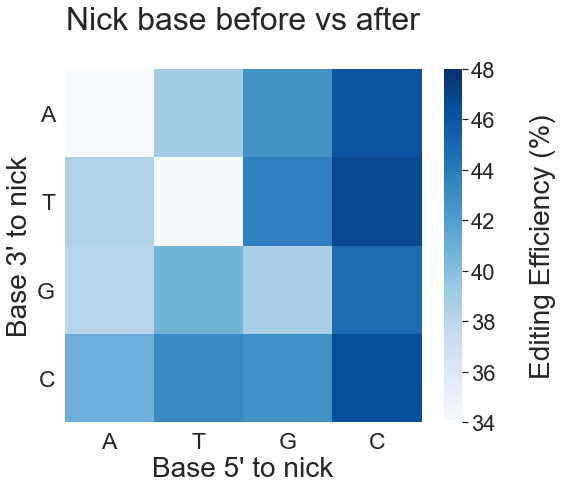

In [42]:

sn.set(font_scale=2)
basebeforelist = ['A','T','G','C']
baseafterlist = ['A','T','G','C']
motif3bpheatmaparray = np.empty([4,4])
for basebeforeindex, basebefore in enumerate(basebeforelist):
    for baseafterindex, baseafter in enumerate(baseafterlist):
        editrates = templatedf[(templatedf['nickbasebefore'] == basebefore)&(templatedf['nickbaseafter'] ==baseafter)]['averageedited']
        motif3bpheatmaparray[baseafterindex, basebeforeindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(8,6.5))
ax.set_title('Nick base before vs after\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Blues", as_cmap=True)

ax = sn.heatmap(motif3bpheatmaparray,cmap=cmap,cbar_kws={'label': '\nEditing Efficiency (%)'},vmin=34, vmax=48)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = basebeforelist
plt.xticks(np.arange(len(basebeforelist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = baseafterlist
plt.yticks(np.arange(len(baseafterlist)) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel("Base 5' to nick", fontsize=28)
ax.set_ylabel("Base 3' to nick", fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'nickbasebefore_after_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

## Nickbase before after - Unintended Editing

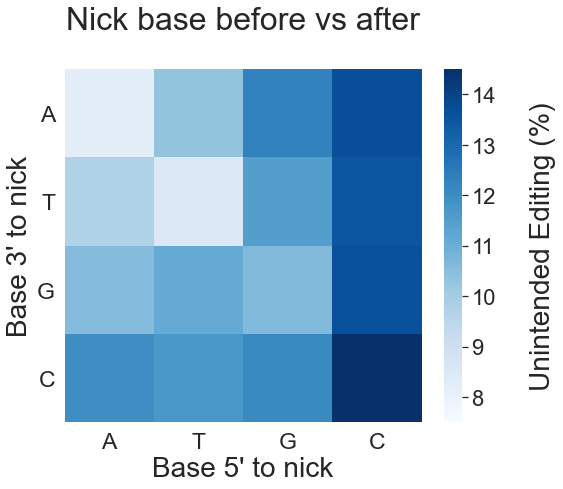

In [43]:
sn.set(font_scale=2)
basebeforelist = ['A','T','G','C']
baseafterlist = ['A','T','G','C']
motif3bpheatmaparray = np.empty([4,4])
for basebeforeindex, basebefore in enumerate(basebeforelist):
    for baseafterindex, baseafter in enumerate(baseafterlist):
        editrates = templatedf[(templatedf['nickbasebefore'] == basebefore)&(templatedf['nickbaseafter'] ==baseafter)]['averageindel']
        motif3bpheatmaparray[baseafterindex, basebeforeindex] = editrates.mean()
fig, ax = plt.subplots(figsize=(8,6.5))
ax.set_title('Nick base before vs after\n', fontsize=32)
#cmap = sn.light_palette("seagreen", as_cmap=True)
cmap = sn.color_palette("Blues", as_cmap=True)

ax = sn.heatmap(motif3bpheatmaparray,cmap=cmap,cbar_kws={'label': '\nUnintended Editing (%)'},vmin=7.5, vmax=14.5)
ax.figure.axes[-1].yaxis.label.set_size(28)

xticks_labels = basebeforelist
plt.xticks(np.arange(len(basebeforelist)) + .5, labels=xticks_labels, fontsize=23)
yticks_labels = baseafterlist
plt.yticks(np.arange(len(baseafterlist)) + .5, labels=yticks_labels, rotation=0, fontsize=23)
ax.set_xlabel("Base 5' to nick", fontsize=28)
ax.set_ylabel("Base 3' to nick", fontsize=28)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+'nickbasebefore_after_unintended_editing_heatmap.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
plt.show()

In [67]:
editmotiflist = []
editmotifdict = {}
for index, row in templatedf.iterrows():
    if row['Correction_Type'] == 'Replacement':
        #print(row['AlternateAllele'])
        #print(row['Disease_Block'][-47-row['Editing_Position']:-44-row['Editing_Position']])
        #editmotif = str(Seq(row['Disease_Block'][-47-row['Editing_Position']:-44-row['Editing_Position']]).reverse_complement())
        # sort editmotif by adjacent bases (before and after)
        editmotif = str(Seq(row['Disease_Block'][-45-(row['Editing_Position']+1):-44-(row['Editing_Position']+1)]).reverse_complement()) + 'N' + str(Seq(row['Disease_Block'][-47-(row['Editing_Position']+1):-46-(row['Editing_Position']+1)]).reverse_complement())
        editmotiflist.append(editmotif)
        if editmotif in editmotifdict:
            editmotifdict[editmotif].append(row['averageedited'])
        else:
            editmotifdict[editmotif] = [row['averageedited']]
    else:
        editmotiflist.append('')
templatedf['editmotifs'] = editmotiflist

## Influence of 5' base on editing

In [68]:
editmotiflist = []
editmotifdict = {}
for index, row in templatedf.iterrows():
    if row['Correction_Type'] == 'Replacement':
        #print(row['AlternateAllele'])
        #print(row['Disease_Block'][-47-row['Editing_Position']:-44-row['Editing_Position']])
        #editmotif = str(Seq(row['Disease_Block'][-47-row['Editing_Position']:-44-row['Editing_Position']]).reverse_complement())
        # sort editmotif by adjacent bases (before and after)
        editmotif = str(Seq(row['Disease_Block'][-47-(row['Editing_Position']+1):-46-(row['Editing_Position']+1)]).reverse_complement())
        #editmotif = str(Seq(row['Disease_Block'][-45-row['Editing_Position']:-44-row['Editing_Position']]).reverse_complement())
        editmotiflist.append(editmotif)
        if editmotif in editmotifdict:
            editmotifdict[editmotif].append(row['averageedited'])
        else:
            editmotifdict[editmotif] = [row['averageedited']]
    else:
        editmotiflist.append('')
templatedf['editmotifs'] = editmotiflist
averagelist=[]
motiflenlist=[]
for key in editmotifdict:
    averagelist.append(sum(editmotifdict[key])/len(editmotifdict[key]))
    motiflenlist.append(len(editmotifdict[key]))
    #print(key,sum(editmotifdict[key])/len(editmotifdict[key]),len(editmotifdict[key]))
editmotifdf = pd.DataFrame()
editmotifdf['Motif'] = list(editmotifdict.keys())
editmotifdf['averagemotifditing']=averagelist
editmotifdf['Motifcount'] = motiflenlist
#editmotifdf['targetbase'] = editmotifdf['Motif'].apply(lambda x: x[1])
editmotifdf.sort_values(by=['averagemotifditing'], ascending=False, inplace=True)

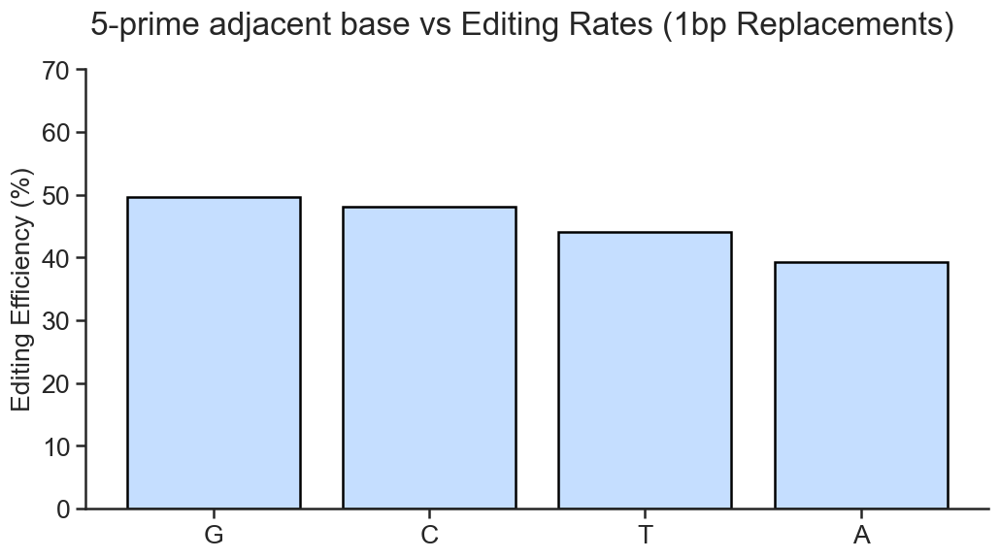

In [69]:
fig21, ax21 = plt.subplots(1,1, figsize = (10, 5),dpi=120)
fig21.suptitle('5-prime adjacent base vs Editing Rates (1bp Replacements)', fontsize=20)
#editingchar = ['averageedited', 'averageindel']
labels = editmotifdf['Motif']
data = editmotifdf['averagemotifditing']
ax21.bar(labels,data, **bar_kwargs)
#ax21.set_title(targetbases[ind], fontsize=16)
ax21.set_ylabel('Editing Efficiency (%)', fontsize=16)
ax21.tick_params(axis='x', labelsize= 16, width=1.5)
ax21.tick_params(axis='y', labelsize= 16, width=1.5)
ax21.spines['right'].set_visible(False)
ax21.spines['top'].set_visible(False)
#ax21.tick_params(axis='x', labelrotation=90)
ax21.set_ylim(0,70)
plt.show()

## Melting temperatures vs editing efficiencies

In [70]:
RTmt = templatedf['RTmt'].reset_index(drop=True)
PBSmt = templatedf['RTmt'].reset_index(drop=True)
protospacermt = templatedf['protospacermt'].reset_index(drop=True)
RToverhangmt = templatedf['RToverhangmt'].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)

#RT melting temp calculations:

RTxy = np.vstack([RTmt,editeff])
RTz = gaussian_kde(RTxy)(RTxy)
RTidx = RTz.argsort()
RTz = RTz[RTidx]
RT_R = stats.spearmanr(templatedf['RTmt'], templatedf['averageedited'])[0]
RT_r = stats.pearsonr(templatedf['RTmt'], templatedf['averageedited'])[0]

#RToverhang melting temp calculations:
RToverhangxy = np.vstack([RToverhangmt,editeff])
RToverhangz = gaussian_kde(RToverhangxy)(RToverhangxy)
RToverhangidx = RToverhangz.argsort()
RToverhangz = RToverhangz[RToverhangidx]
RToverhang_R = stats.spearmanr(templatedf['RToverhangmt'], templatedf['averageedited'])[0]
RToverhang_r = stats.pearsonr(templatedf['RToverhangmt'], templatedf['averageedited'])[0]

#PBS melting temp calculations:
PBSxy = np.vstack([PBSmt,editeff])
PBSz = gaussian_kde(PBSxy)(PBSxy)
PBSidx = PBSz.argsort()
PBSz = PBSz[PBSidx]
PBS_R = stats.spearmanr(templatedf['PBSmt'], templatedf['averageedited'])[0]
PBS_r = stats.pearsonr(templatedf['PBSmt'], templatedf['averageedited'])[0]

#Protospacer melting temp calculations:
protospacerxy = np.vstack([protospacermt,editeff])
protospacerz = gaussian_kde(protospacerxy)(protospacerxy)
protospaceridx = protospacerz.argsort()
protospacerz = protospacerz[protospaceridx]
protospacer_R = stats.spearmanr(templatedf['protospacermt'], templatedf['averageedited'])[0]
protospacer_r = stats.pearsonr(templatedf['protospacermt'], templatedf['averageedited'])[0]

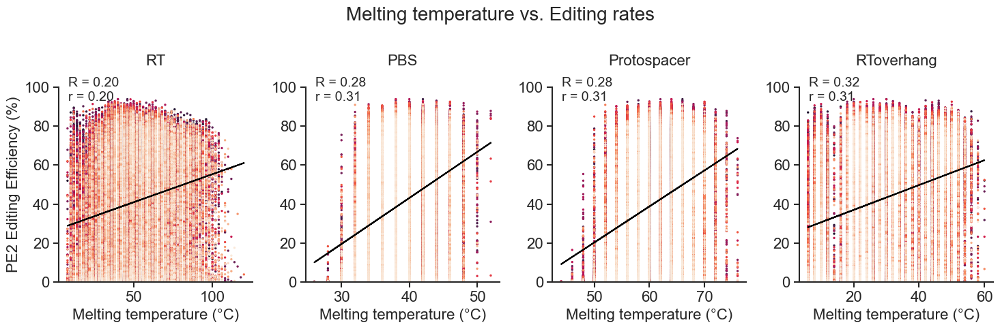

In [71]:
fig12, (ax12, ax13, ax14, ax15) = plt.subplots(1,4,figsize = (15, 5),dpi=100)
fig12.suptitle('Melting temperature vs. Editing rates', fontsize=20)
plt.rcParams['axes.linewidth'] = 1.5
ax12.scatter(templatedf['RTmt'], templatedf['averageedited'], c=RTz, s=2)
ax12.set_title('RT\n', fontsize=16)
ax12.set_ylabel('PE2 Editing Efficiency (%)', fontsize=16)
m, b = np.polyfit(templatedf['RTmt'], templatedf['averageedited'], 1)
ax12.plot(templatedf['RTmt'], m*templatedf['RTmt'] + b, color='black')
ax12.text(0.05,1.05, 'R = '+str(RT_R)[:4]+'\nr = '+str(RT_r)[:4], transform=ax12.transAxes, fontsize=14,
        verticalalignment='top')

ax13.scatter(templatedf['PBSmt'], templatedf['averageedited'], c=PBSz, s=2)
ax13.set_title('PBS\n', fontsize=16)
#ax13.set_ylabel('PE2 Editing Efficiency (%)', fontsize=16)
m, b = np.polyfit(templatedf['PBSmt'], templatedf['averageedited'], 1)
ax13.plot(templatedf['PBSmt'], m*templatedf['PBSmt'] + b, color='black')
ax13.text(0.05,1.05, 'R = '+str(PBS_R)[:4]+'\nr = '+str(PBS_r)[:4], transform=ax13.transAxes, fontsize=14,
        verticalalignment='top')

ax14.scatter(templatedf['protospacermt'], templatedf['averageedited'], c=protospacerz, s=2)
ax14.set_title('Protospacer\n', fontsize=16)
#ax14.set_ylabel('PE2 Editing Efficiency (%)', fontsize=16)
m, b = np.polyfit(templatedf['protospacermt'], templatedf['averageedited'], 1)
ax14.plot(templatedf['protospacermt'], m*templatedf['protospacermt'] + b, color='black')
ax14.text(0.05,1.05, 'R = '+str(protospacer_R)[:4]+'\nr = '+str(protospacer_r)[:4], transform=ax14.transAxes, fontsize=14,
        verticalalignment='top')

ax15.scatter(templatedf['RToverhangmt'], templatedf['averageedited'], c=protospacerz, s=2)
ax15.set_title('RToverhang\n', fontsize=16)
#ax14.set_ylabel('PE2 Editing Efficiency (%)', fontsize=16)
m, b = np.polyfit(templatedf['RToverhangmt'], templatedf['averageedited'], 1)
ax15.plot(templatedf['RToverhangmt'], m*templatedf['RToverhangmt'] + b, color='black')
ax15.text(0.05,1.05, 'R = '+str(RToverhang_R)[:4]+'\nr = '+str(RToverhang_r)[:4], transform=ax15.transAxes, fontsize=14,
        verticalalignment='top')

for ax in fig12.get_axes():
    ax.tick_params(axis='x', labelsize= 16, width=1.5)
    ax.tick_params(axis='y', labelsize= 16, width=1.5)
    ax.set_xlabel('Melting temperature (°C)', fontsize=16)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.set_ylim(0, 100)
#plt.xlabel("Melting temperature (°C)")
plt.tight_layout()
plt.show()

## Calculating MFE for disease screen

21762 23.54608701297296


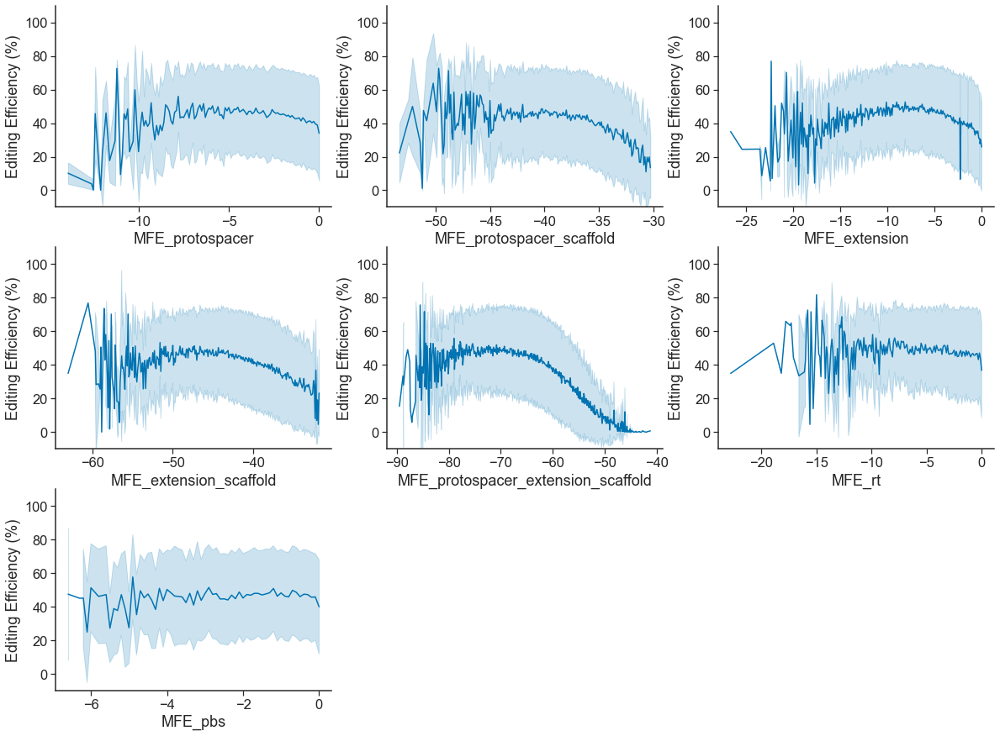

In [72]:
fig10, ax = plt.subplots(3,3,figsize=(20,15))
ax[0,0] = sn.lineplot(x='MFE_protospacer', y='averageedited', ci='sd', data=templatedf, ax=ax[0,0])
ax[0,1] = sn.lineplot(x='MFE_protospacer_scaffold', y='averageedited', ci='sd', data=templatedf, ax=ax[0,1])
ax[0,2] = sn.lineplot(x='MFE_extension', y='averageedited', ci='sd', data=templatedf, ax=ax[0,2])
ax[1,0] = sn.lineplot(x='MFE_extension_scaffold', y='averageedited', ci='sd', data=templatedf, ax=ax[1,0])
ax[1,1] = sn.lineplot(x='MFE_protospacer_extension_scaffold', y='averageedited', ci='sd', data=templatedf, ax=ax[1,1])
ax[1,2] = sn.lineplot(x='MFE_rt', y='averageedited', ci='sd', data=templatedf, ax=ax[1,2])
ax[2,0] = sn.lineplot(x='MFE_pbs', y='averageedited', ci='sd', data=templatedf, ax=ax[2,0])

for x in range(3):
    for y in range(3):
        ax[x,y].set_ylabel('Editing Efficiency (%)')
        ax[x,y].set(ylim=(-10, 110))
        ax[x,y].spines['right'].set_visible(False)
        ax[x,y].spines['top'].set_visible(False)
ax[2,1].axis('off')
ax[2,2].axis('off')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'MFE_editing.pdf', format='pdf',
        transparent=True,bbox_inches='tight')

count = templatedf[(templatedf['MFE_protospacer_extension_scaffold']>=-60)].shape[0]
totalcount = templatedf.shape[0]
percent= (count/totalcount)*100
print(count, percent)

21762 23.54608701297296


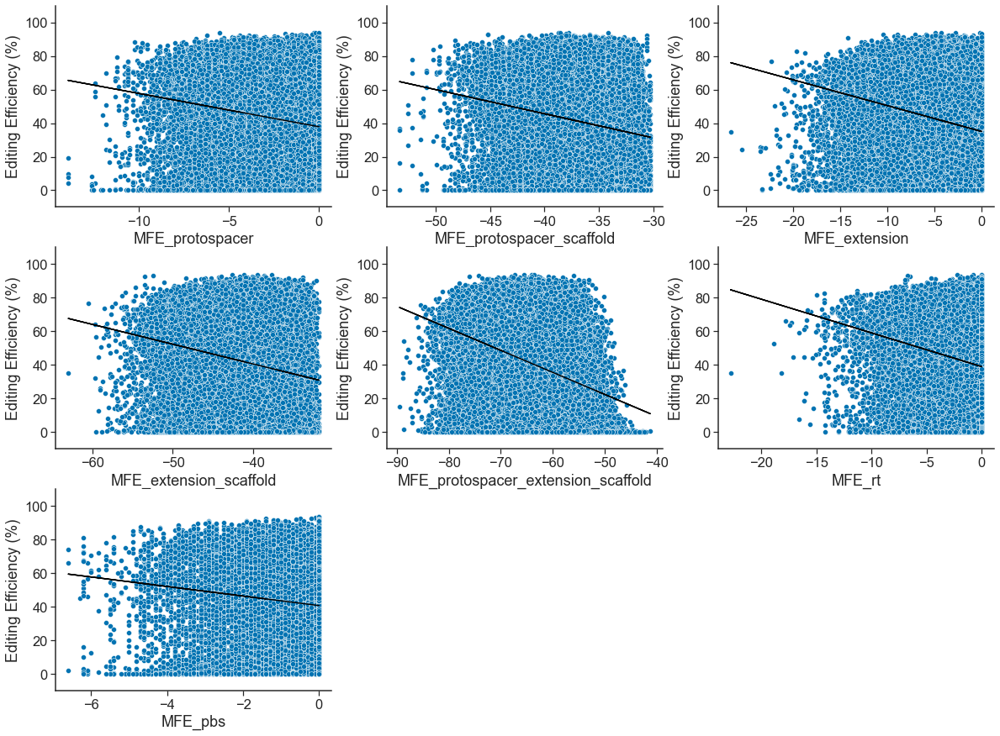

In [73]:
fig10, ax = plt.subplots(3,3,figsize=(20,15))

xaxis_column = 'MFE_protospacer'

ax[0,0] = sn.scatterplot(x='MFE_protospacer', y='averageedited', data=templatedf, ax=ax[0,0])
m, b = np.polyfit(templatedf['MFE_protospacer'], templatedf['averageedited'], 1)
ax[0,0].plot(templatedf['MFE_protospacer'], m*templatedf['MFE_protospacer'] + b, color='black')

ax[0,1] = sn.scatterplot(x='MFE_protospacer_scaffold', y='averageedited', ci='sd', data=templatedf, ax=ax[0,1])
m, b = np.polyfit(templatedf['MFE_protospacer_scaffold'], templatedf['averageedited'], 1)
ax[0,1].plot(templatedf['MFE_protospacer_scaffold'], m*templatedf['MFE_protospacer_scaffold'] + b, color='black')

ax[0,2] = sn.scatterplot(x='MFE_extension', y='averageedited', ci='sd', data=templatedf, ax=ax[0,2])
m, b = np.polyfit(templatedf['MFE_extension'], templatedf['averageedited'], 1)
ax[0,2].plot(templatedf['MFE_extension'], m*templatedf['MFE_extension'] + b, color='black')

ax[1,0] = sn.scatterplot(x='MFE_extension_scaffold', y='averageedited', ci='sd', data=templatedf, ax=ax[1,0])
m, b = np.polyfit(templatedf['MFE_extension_scaffold'], templatedf['averageedited'], 1)
ax[1,0].plot(templatedf['MFE_extension_scaffold'], m*templatedf['MFE_extension_scaffold'] + b, color='black')

ax[1,1] = sn.scatterplot(x='MFE_protospacer_extension_scaffold', y='averageedited', ci='sd', data=templatedf, ax=ax[1,1])
m, b = np.polyfit(templatedf['MFE_protospacer_extension_scaffold'], templatedf['averageedited'], 1)
ax[1,1].plot(templatedf['MFE_protospacer_extension_scaffold'], m*templatedf['MFE_protospacer_extension_scaffold'] + b, color='black')

ax[1,2] = sn.scatterplot(x='MFE_rt', y='averageedited', ci='sd', data=templatedf, ax=ax[1,2])
m, b = np.polyfit(templatedf['MFE_rt'], templatedf['averageedited'], 1)
ax[1,2].plot(templatedf['MFE_rt'], m*templatedf['MFE_rt'] + b, color='black')

ax[2,0] = sn.scatterplot(x='MFE_pbs', y='averageedited', ci='sd', data=templatedf, ax=ax[2,0])
m, b = np.polyfit(templatedf['MFE_pbs'], templatedf['averageedited'], 1)
ax[2,0].plot(templatedf['MFE_pbs'], m*templatedf['MFE_pbs'] + b, color='black')

for x in range(3):
    for y in range(3):
        ax[x,y].set_ylabel('Editing Efficiency (%)')
        ax[x,y].set(ylim=(-10, 110))
        ax[x,y].spines['right'].set_visible(False)
        ax[x,y].spines['top'].set_visible(False)
ax[2,1].axis('off')
ax[2,2].axis('off')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'MFE_editing_scatter.pdf', format='pdf',
        transparent=True,bbox_inches='tight')

count = templatedf[(templatedf['MFE_protospacer_extension_scaffold']>=-60)].shape[0]
totalcount = templatedf.shape[0]
percent= (count/totalcount)*100
print(count, percent)

## MFE Protospacer vs editing

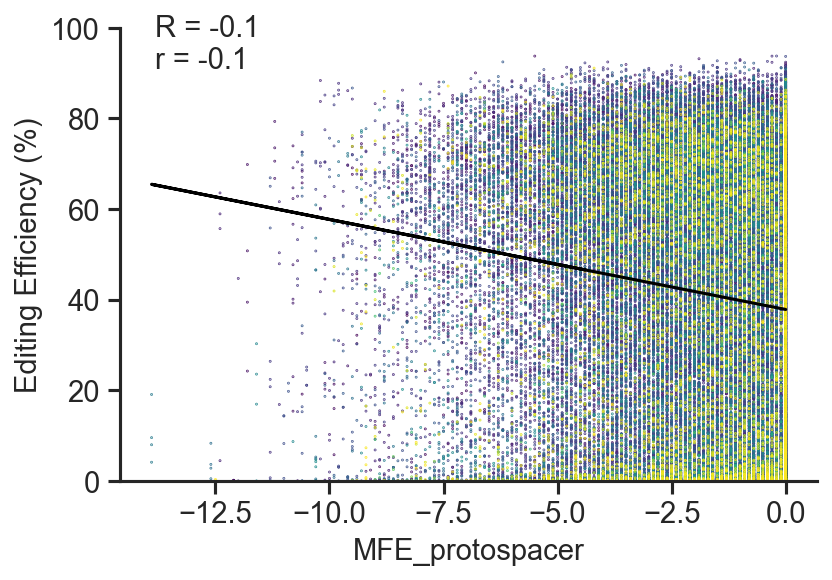

In [74]:
xaxis_column = 'MFE_protospacer'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\Sup5_MFE\\'
plt.savefig(figurepath+xaxis_column+'_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## MFE Protospacer vs unintended editing

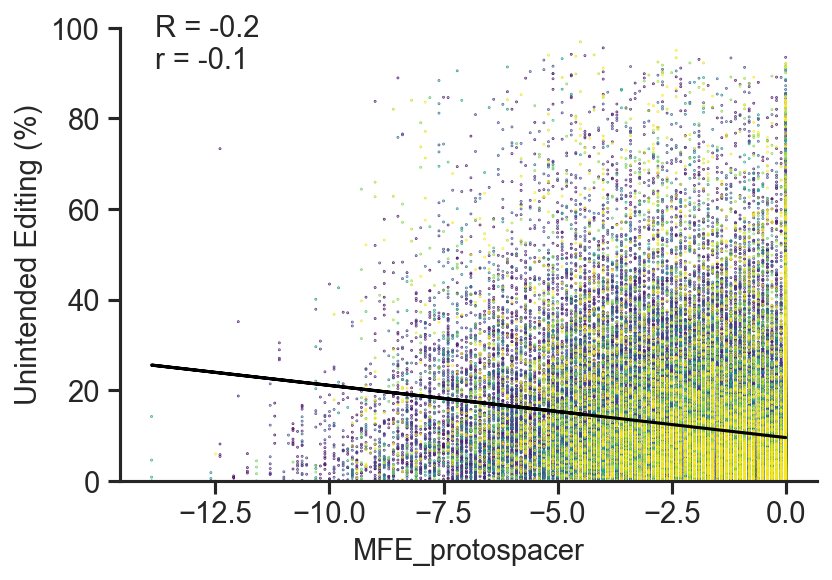

In [75]:
xaxis_column = 'MFE_protospacer'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+xaxis_column+'_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## MFE Protospacer-Scaffold vs editing

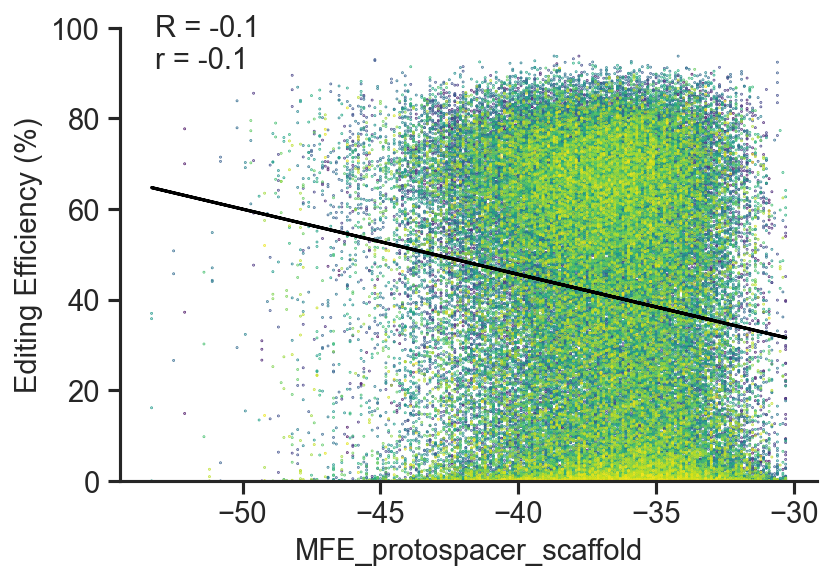

In [76]:
xaxis_column = 'MFE_protospacer_scaffold'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\Sup5_MFE\\'
plt.savefig(figurepath+xaxis_column+'_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## MFE Protospacer-Scaffold vs unintended editing

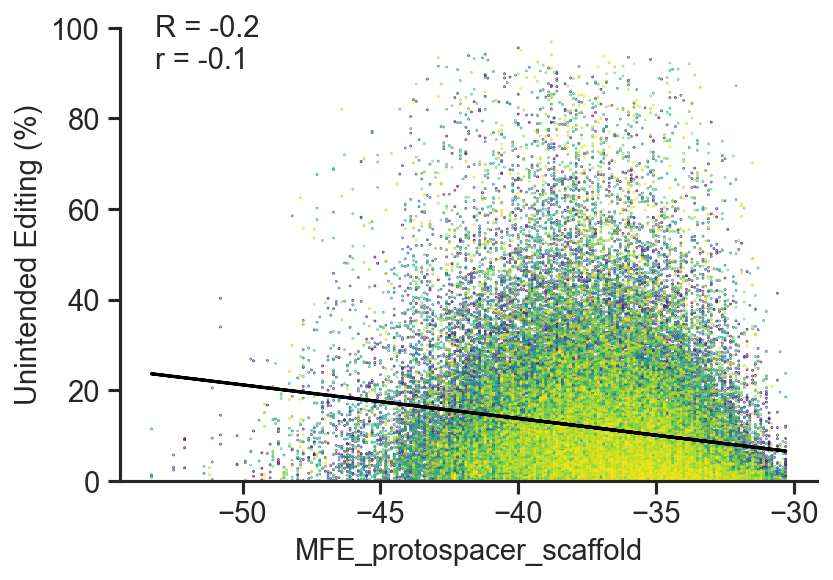

In [77]:
xaxis_column = 'MFE_protospacer_scaffold'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+xaxis_column+'_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## MFE Extension vs editing

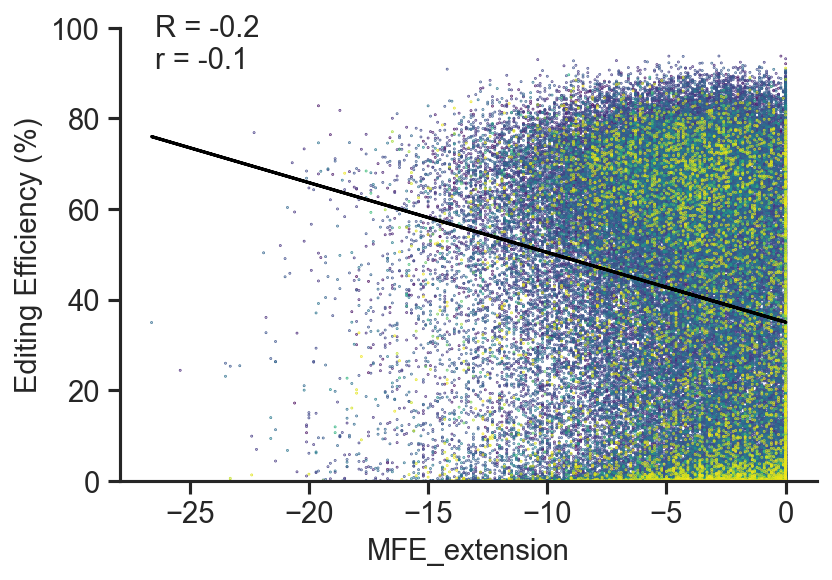

In [78]:
xaxis_column = 'MFE_extension'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\Sup5_MFE\\'
plt.savefig(figurepath+xaxis_column+'_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## MFE Extension vs unintended editing

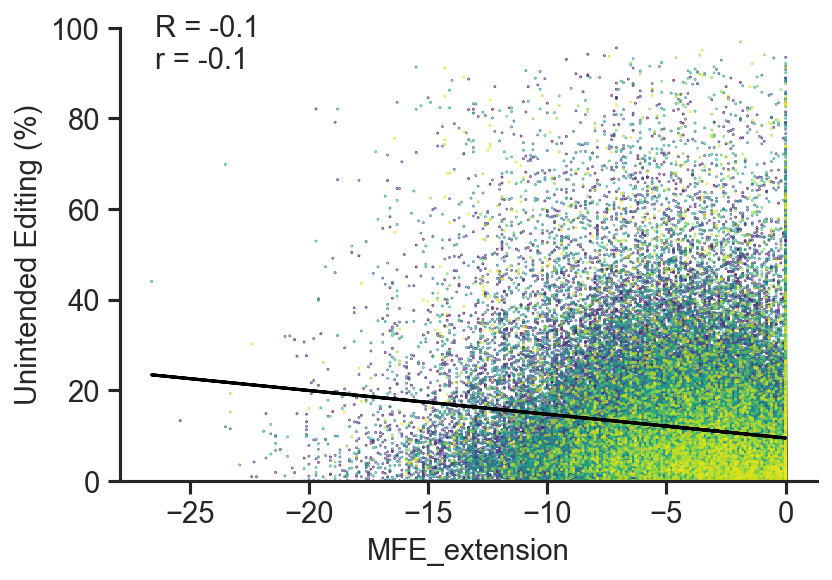

In [79]:
xaxis_column = 'MFE_extension'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+xaxis_column+'_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## MFE Extension-Scaffold vs editing

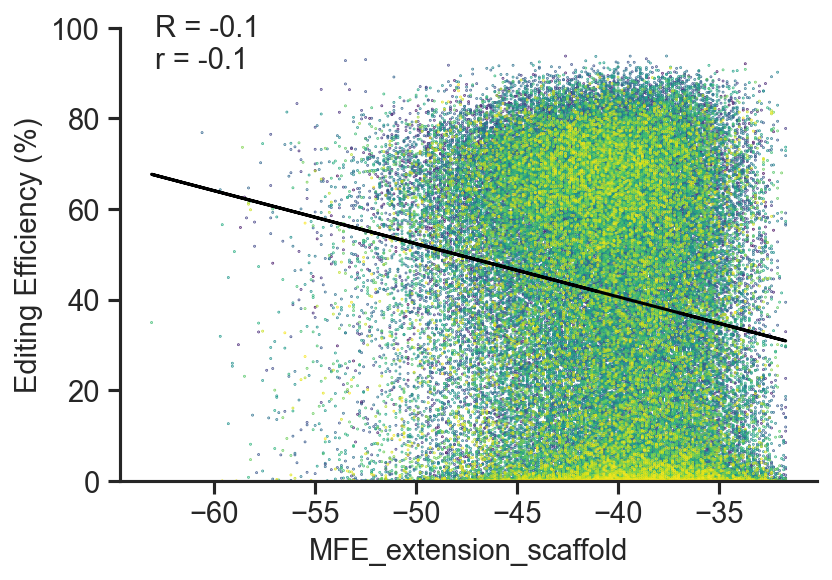

In [80]:
xaxis_column = 'MFE_extension_scaffold'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\Sup5_MFE\\'
plt.savefig(figurepath+xaxis_column+'_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## MFE Extension-Scaffold vs unintended editing

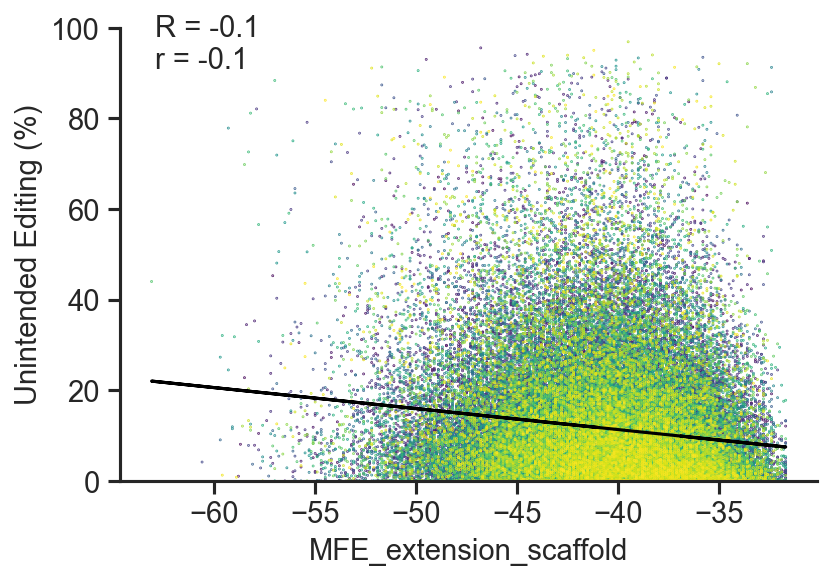

In [81]:
xaxis_column = 'MFE_extension_scaffold'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+xaxis_column+'_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## MFE Protospacer-Extension-Scaffold vs editing

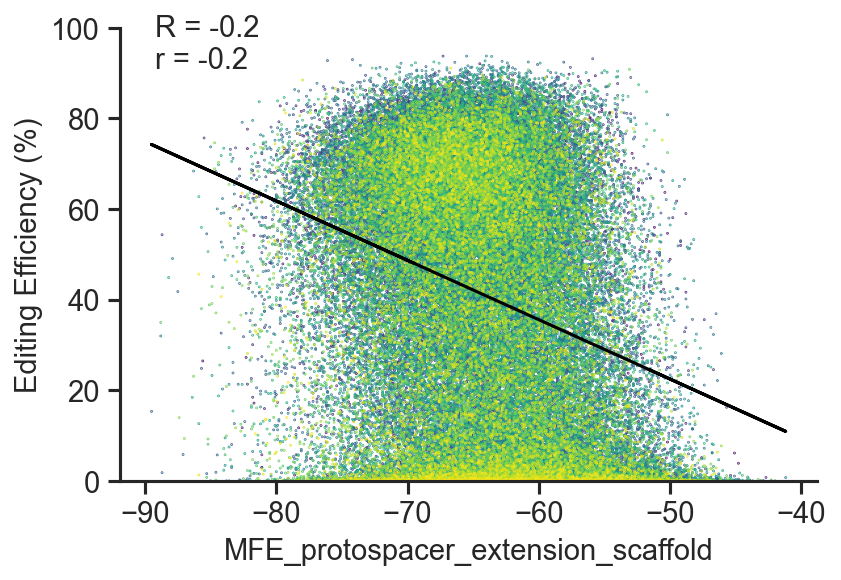

In [82]:
xaxis_column = 'MFE_protospacer_extension_scaffold'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\Sup5_MFE\\'
plt.savefig(figurepath+xaxis_column+'_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## MFE Protospacer-Extension-Scaffold vs unintended editing

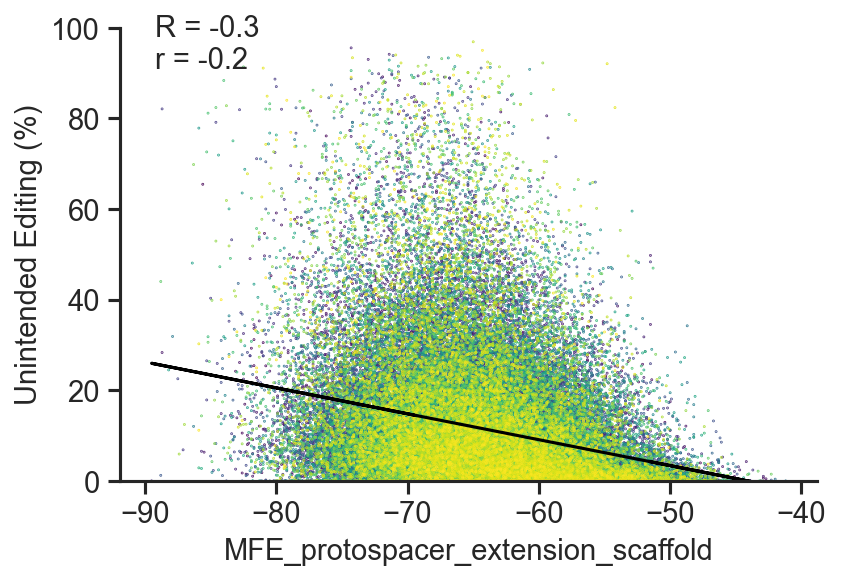

In [83]:
xaxis_column = 'MFE_protospacer_extension_scaffold'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+xaxis_column+'_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## MFE RT vs editing

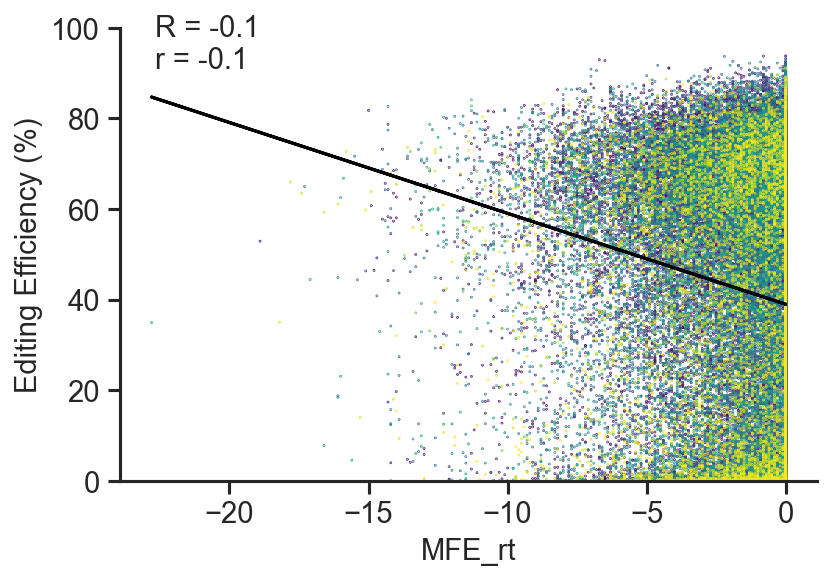

In [84]:
xaxis_column = 'MFE_rt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\Sup5_MFE\\'
plt.savefig(figurepath+xaxis_column+'_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## MFE RT vs unintended editing

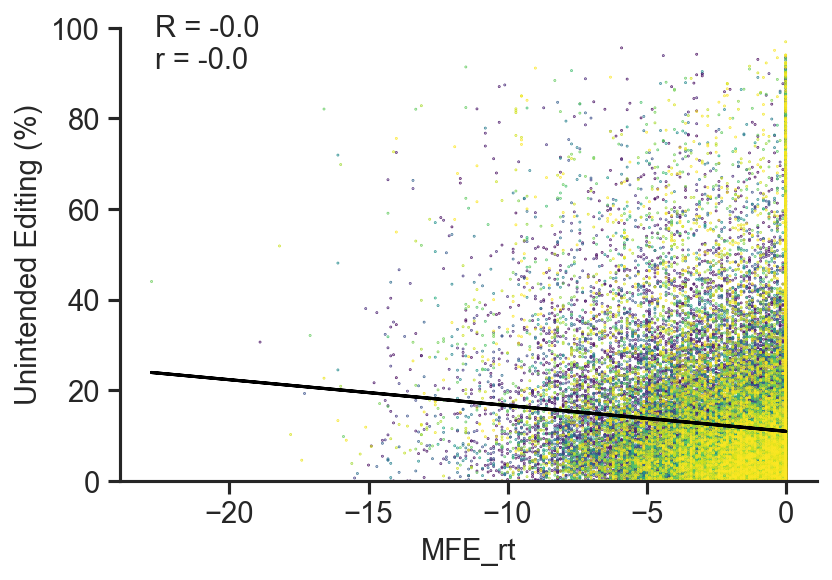

In [85]:
xaxis_column = 'MFE_rt'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+xaxis_column+'_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## MFE PBS vs editing

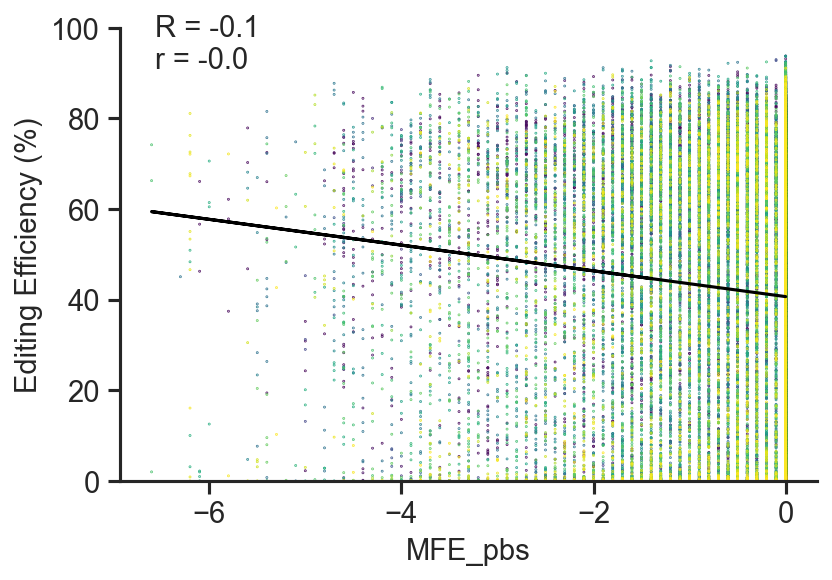

In [86]:
xaxis_column = 'MFE_pbs'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageedited'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageedited'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageedited'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageedited'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\Sup5_MFE\\'
plt.savefig(figurepath+xaxis_column+'_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

## MFE PBS vs unintended editing

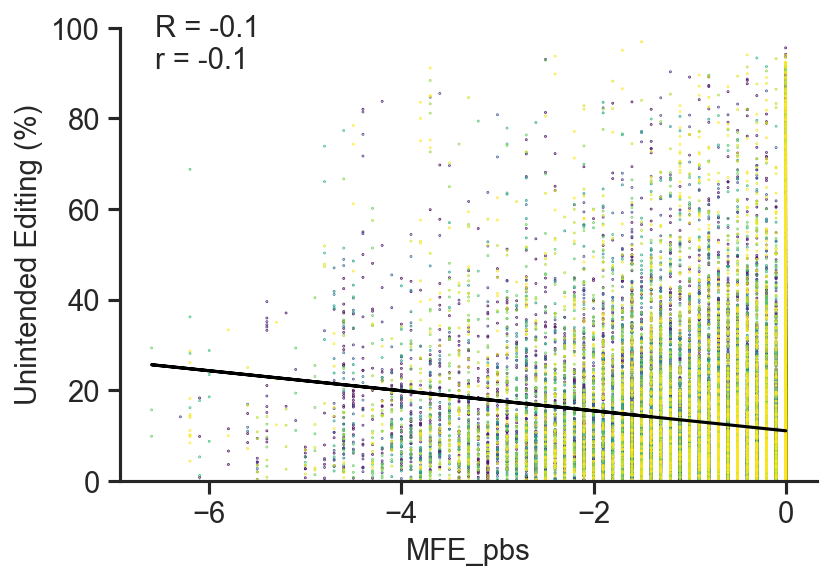

In [87]:
xaxis_column = 'MFE_pbs'


x = templatedf[xaxis_column].reset_index(drop=True)
editeff = templatedf['averageindel'].reset_index(drop=True)
xy = np.vstack([x,editeff])
z = gaussian_kde(xy)(xy)
# Sort the points by density, so that the densest points are plotted last
idx = z.argsort()
x, y, z = x[idx], editeff[idx], z[idx]
R = stats.spearmanr(templatedf[xaxis_column], templatedf['averageindel'])[0]
r = stats.pearsonr(templatedf[xaxis_column], templatedf['averageindel'])[0]
fig7, ax7 = plt.subplots(dpi=150)
#ax7.set_title(xaxis_column+'\n', fontsize=16)
ax7.scatter(templatedf[xaxis_column], templatedf['averageindel'], c=z, cmap='viridis', s=0.1)
ax7.tick_params(axis='x', labelsize= lsize, width=1.5)
ax7.tick_params(axis='y', labelsize= lsize, width=1.5)
ax7.set_xlabel(xaxis_column, fontsize=lsize)
ax7.set_ylabel('Unintended Editing (%)', fontsize=lsize)
ax7.spines['right'].set_visible(False)
ax7.spines['top'].set_visible(False)
m, b = np.polyfit(templatedf[xaxis_column], templatedf['averageindel'], 1)
ax7.plot(templatedf[xaxis_column], m*templatedf[xaxis_column] + b, color='black')
ax7.set_ylim(0, 100)
ax7.text(0.05,1.03, 'R = '+str(R)[:4]+'\nr = '+str(r)[:4], transform=ax7.transAxes, fontsize=14,
        verticalalignment='top')
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2b_Feature_Vis_Unintended\\'
plt.savefig(figurepath+xaxis_column+'_unintended_editing.png', format='png',
        transparent=True,bbox_inches='tight')
plt.show()

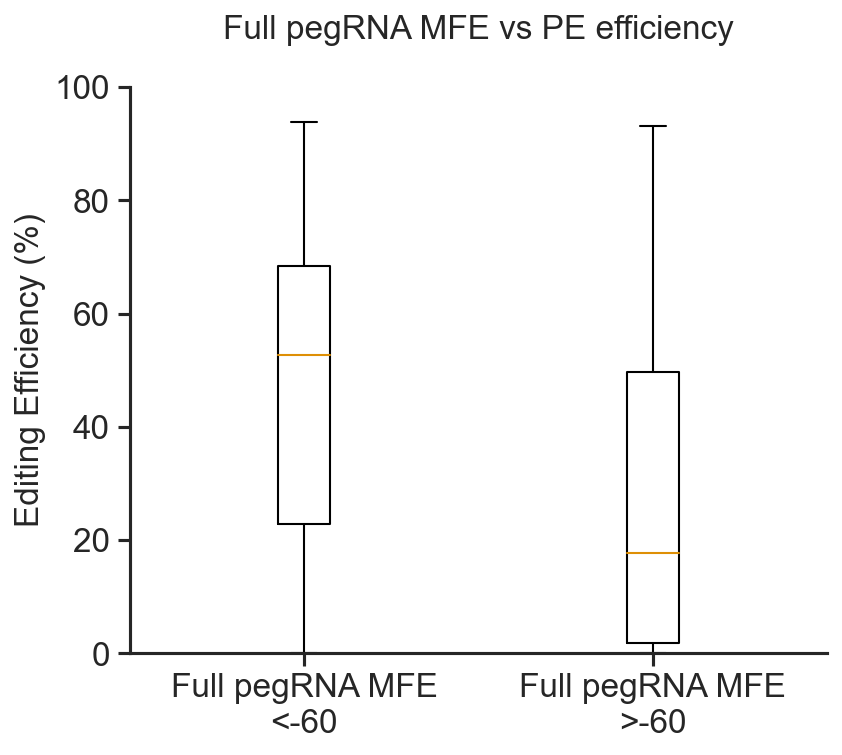

In [88]:
total_MFE = templatedf['MFE_protospacer_extension_scaffold'].reset_index(drop=True)
editeff = templatedf['averageedited'].reset_index(drop=True)
low_total_MFE = editeff[total_MFE.lt(-60)]
high_total_MFE = editeff[total_MFE.gt(-60)]
lowhigh_total_MFE = [low_total_MFE, high_total_MFE]

fig50, ax50 = plt.subplots(figsize=(6,5),dpi=150)
ax50.set_title('Full pegRNA MFE vs PE efficiency\n', fontsize=16)
ax50.boxplot(lowhigh_total_MFE)
ax50.set_xticklabels(['Full pegRNA MFE\n<-60', 'Full pegRNA MFE\n>-60'])
#ax8.set_xlabel(fontsize=16)
ax50.set_ylabel('Editing Efficiency (%)', fontsize=16)
ax50.tick_params(axis='x', labelsize= 16, width=1.5)
ax50.tick_params(axis='y', labelsize= 16, width=1.5)
ax50.set_ylim(0,100)
ax50.spines['right'].set_visible(False)
ax50.spines['top'].set_visible(False)
  
# show plot
plt.show()

In [89]:
lowMFE = templatedf[templatedf['MFE_protospacer_extension_scaffold'] < -65]['averageedited'].mean()
highMFE = templatedf[templatedf['MFE_protospacer_extension_scaffold'] > -65]['averageedited'].mean()

In [90]:
highMFE

35.730731711084914

## MFE without polyT and without low GC in Extension

In [ ]:
nopolydf = templatedf[(templatedf['polytvalues'] <4) & (templatedf['Extension_GC_content'] >40)& (templatedf['Extension_GC_content'] <60)]

f, axes = plt.subplots(7,1, figsize=(6,28), sharey=True)
sn.lineplot(x='MFE_protospacer', y='averageedited', ci='sd', data=nopolydf, ax=axes[0])
sn.lineplot(x='MFE_protospacer_scaffold', y='averageedited', ci='sd', data=nopolydf, ax=axes[1])
sn.lineplot(x='MFE_extension', y='averageedited', ci='sd', data=nopolydf, ax=axes[2])
sn.lineplot(x='MFE_extension_scaffold', y='averageedited', ci='sd', data=nopolydf, ax=axes[3])
sn.lineplot(x='MFE_protospacer_extension_scaffold', y='averageedited', ci='sd', data=nopolydf, ax=axes[4])
sn.lineplot(x='MFE_rt', y='averageedited', ci='sd', data=nopolydf, ax=axes[5])
sn.lineplot(x='MFE_pbs', y='averageedited', ci='sd', data=nopolydf, ax=axes[6])

count = nopolydf[(nopolydf['MFE_protospacer_extension_scaffold']>=-60)].shape[0]
totalcount = nopolydf.shape[0]
percent= (count/totalcount)*100
print(count, percent)

## Analysis of protospacer base at position 12 on editing efficiency

34.71026560912935
43.434178345466584


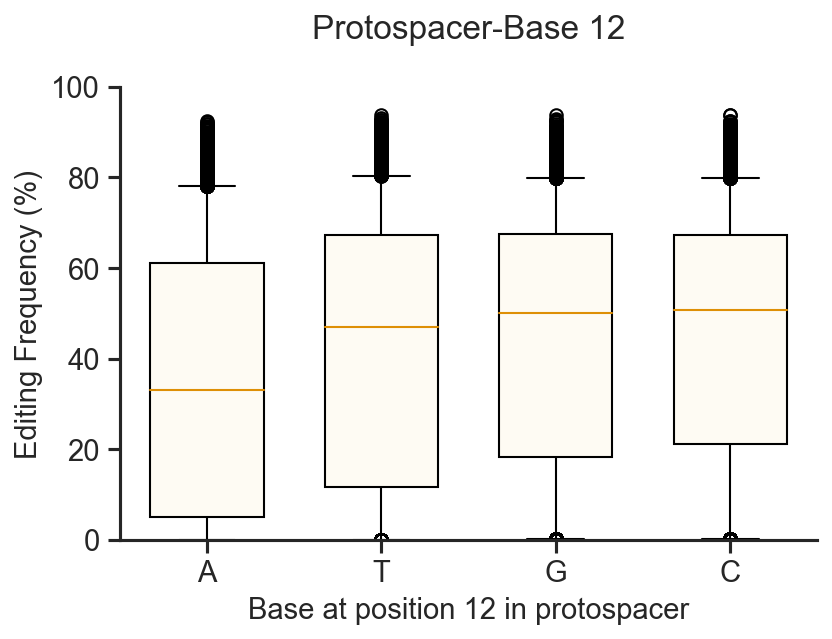

In [91]:
no_protobase_12_A_editing = templatedf[templatedf['protobase_12'] != 'A']['averageedited']
protobase_12_A_editingdf = templatedf[templatedf['protobase_12'] == 'A']
protobase_12_T_editingdf = templatedf[templatedf['protobase_12'] == 'T']
protobase_12_G_editingdf = templatedf[templatedf['protobase_12'] == 'G']
protobase_12_C_editingdf = templatedf[templatedf['protobase_12'] == 'C']

protobase_12_A_editing = protobase_12_A_editingdf['averageedited']
protobase_12_T_editing = protobase_12_T_editingdf['averageedited']
protobase_12_G_editing = protobase_12_G_editingdf['averageedited']
protobase_12_C_editing = protobase_12_C_editingdf['averageedited']


print(protobase_12_A_editing.mean())
print(no_protobase_12_A_editing.mean())

protobase_12_list = [protobase_12_A_editing,protobase_12_T_editing,protobase_12_G_editing,protobase_12_C_editing]

fig1, ax1 = plt.subplots(dpi=150)
ax1.set_title('Protospacer-Base 12\n', fontsize=titlesize)
ax1.boxplot(protobase_12_list,**boxplot_kwargs)
ax1.set_xticklabels(['A', 'T', 
                    'G', 'C'])
ax1.set_xlabel('Base at position 12 in protospacer', fontsize=lsize)
ax1.set_ylabel('Editing Frequency (%)', fontsize=lsize)
ax1.tick_params(axis='x', labelsize= lsize, width=1.5)
ax1.tick_params(axis='y', labelsize= lsize, width=1.5)
ax1.set_ylim(0, 100)
ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\03_Feature_importance\\'
plt.savefig(figurepath+'position12protospacerediting.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
# show plot
plt.show()

In [92]:
len(templatedf.Name.unique())

13349

In [4]:
percentagefrommeanlist = []
i = 0
z = 0
for variant in templatedf.Name.unique():
    variantdf = templatedf[templatedf['Name'] == variant]
    
    average = variantdf.averageedited.mean()
    for index, row in variantdf.iterrows():
        percentage = row.averageedited/average
        percentagefrommeanlist.append(percentage*100)
    i += 1
    z += 1
    if z == 1000:
        z = 0
        print(i)

templatedf['percentagefromvariantmean'] = percentagefrommeanlist

C:\Users\nimath\AppData\Local\Temp/ipykernel_16744/2242703178.py:9: RuntimeWarning: invalid value encountered in double_scalars
  percentage = row.averageedited/average


1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000


In [5]:
i = 0
z = 0
lowesthighestdifference = []
for variant in templatedf.Name.unique():
    variantdf = templatedf[templatedf['Name'] == variant]
    
    lowest = min(variantdf.averageedited)
    highest = max(variantdf.averageedited)
    
    lowesthighestdifference.append(highest-lowest)
    i += 1
    z += 1
    if z == 1000:
        z = 0
        print(i)


1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000


In [6]:
lowhighdf = pd.DataFrame()
lowhighdf['lowesthighestdifference'] = lowesthighestdifference
#lowhighdf['sample'] = lowesthighestdifference

count    13349.000000
mean        43.948100
std         24.617221
min          0.000000
25%         23.769138
50%         46.376236
75%         65.350845
max         92.486191
Name: lowesthighestdifference, dtype: float64

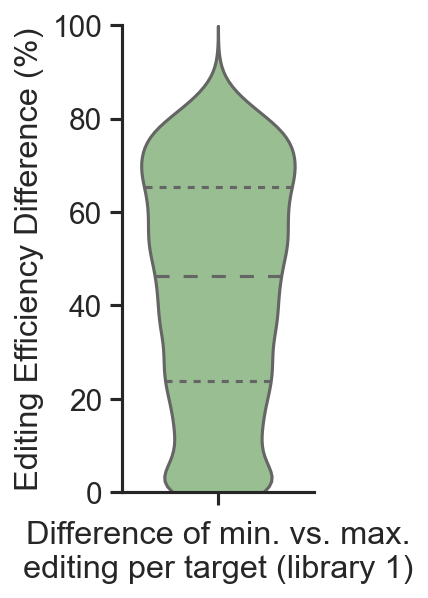

In [25]:
plt.figure(figsize=(1.65,4.125), dpi= 150)
sn.set(font_scale = 1.3)
sn.set_style("ticks")
my_pal = {"x": "#5A8ED2"}
p = sn.violinplot(y='lowesthighestdifference', data=lowhighdf, scale='width', inner='quartile', color='#94C58B')
sn.despine() 
p.set_xlabel("Difference of min. vs. max.\nediting per target (library 1)")
p.set_ylabel("Editing Efficiency Difference (%)")
#p.set_title("Base at Flap Position\n(flapbasebefore)")
p.set_ylim(0,100)
for _,s in p.spines.items():
    s.set_linewidth(axesthickness)
p.xaxis.set_tick_params(width=axesthickness)
p.yaxis.set_tick_params(width=axesthickness)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'minimum_vs_maximum_editing_per_target.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
lowhighdf['lowesthighestdifference'].describe()

In [8]:
highrttoverhangtemplatedf = templatedf[templatedf['RToverhanglength'] != 3]
len(highrttoverhangtemplatedf)
i = 0
z = 0
lowesthighestdifference_highRTToverhang = []
for variant in highrttoverhangtemplatedf.Name.unique():
    variantdf = highrttoverhangtemplatedf[highrttoverhangtemplatedf['Name'] == variant]
    
    lowest = min(variantdf.averageedited)
    highest = max(variantdf.averageedited)
    
    lowesthighestdifference_highRTToverhang.append(highest-lowest)
    i += 1
    z += 1
    if z == 1000:
        z = 0
        print(i)
print(sum(lowesthighestdifference_highRTToverhang)/len(lowesthighestdifference_highRTToverhang))

1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
27.6635346197719


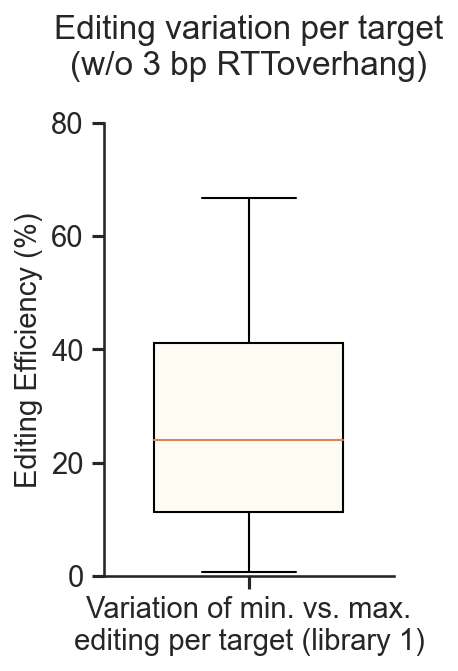

In [9]:
fig2, ax3 = plt.subplots(figsize = (2.5, 4),dpi=150)
ax3.set_title('Editing variation per target\n(w/o 3 bp RTToverhang)\n', fontsize=titlesize)
ax3.boxplot(lowesthighestdifference_highRTToverhang, showfliers = False, **boxplot_kwargs)
ax3.set_xticklabels(['Variation of min. vs. max.\nediting per target (library 1)'])
#ax3.set_xlabel('Editing Length (bp)', fontsize=lsize)
ax3.set_ylabel('Editing Efficiency (%)', fontsize=lsize)
ax3.tick_params(axis='x', labelsize= lsize, width=1.5)
ax3.tick_params(axis='y', labelsize= lsize, width=1.5)
ax3.set_ylim(0, 80)
ax3.spines['right'].set_visible(False)
ax3.spines['top'].set_visible(False)

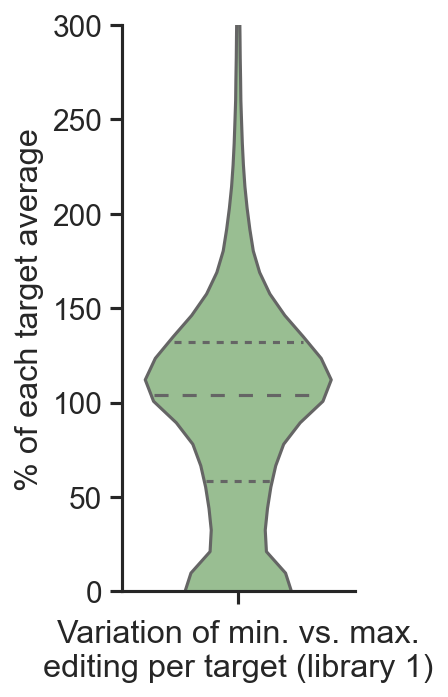

In [10]:
plt.figure(figsize=(2,5), dpi= 150)
sn.set(font_scale = 1.3)
sn.set_style("ticks")
my_pal = {"x": "#5A8ED2"}
p = sn.violinplot(y='percentagefromvariantmean', data=templatedf, scale='width', inner='quartile', color='#94C58B')
sn.despine() 
p.set_xlabel("Variation of min. vs. max.\nediting per target (library 1)")
p.set_ylabel("% of each target average")
#p.set_title("Base at Flap Position\n(flapbasebefore)")
p.set_ylim(0,300)
for _,s in p.spines.items():
    s.set_linewidth(axesthickness)
p.xaxis.set_tick_params(width=axesthickness)
p.yaxis.set_tick_params(width=axesthickness)
#figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
#plt.savefig(figurepath+'flapbasebefore_seaborn_editing.pdf', format='pdf',
#        transparent=True,bbox_inches='tight')

### Variation within protospacers (only changing RT length)

In [13]:
templatedf['protospacer'] = templatedf.apply(lambda x: x.protobase_1 + x.protobase_2 + x.protobase_3 + x.protobase_4 + x.protobase_5 + x.protobase_6 + x.protobase_7 + x.protobase_8 + x.protobase_9 + x.protobase_10 + x.protobase_11 + x.protobase_12 + x.protobase_13 + x.protobase_14 + x.protobase_15 + x.protobase_16 + x.protobase_17 + x.protobase_18 + x.protobase_19 ,axis=1)

In [14]:
i = 0
z = 0
protolowesthighestdifference = []
for proto in templatedf.protospacer.unique():
    protodf = templatedf[templatedf['protospacer'] == proto]
    
    lowest = min(protodf.averageedited)
    highest = max(protodf.averageedited)
    
    protolowesthighestdifference.append(highest-lowest)
    i += 1
    z += 1
    if z == 1000:
        z = 0
        print(i)

1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
14000
15000
16000
17000
18000
19000
20000
21000
22000
23000
24000


count    24219.000000
mean        33.570866
std         23.242953
min          0.000000
25%         13.924772
50%         30.582991
75%         51.522254
max         90.941817
Name: protolowesthighestdifference, dtype: float64

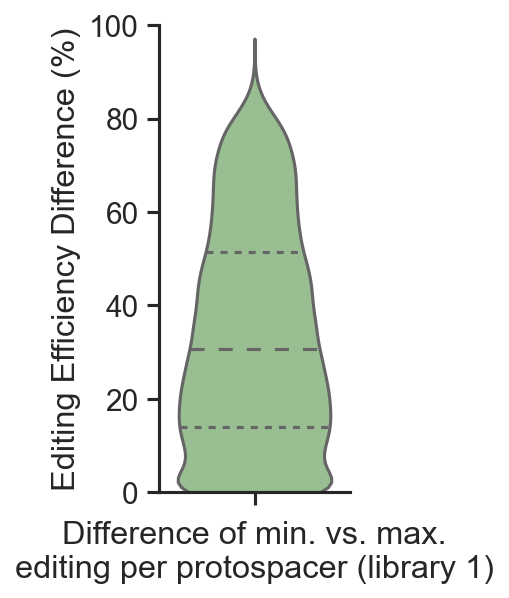

In [24]:
protolowhighdf = pd.DataFrame()
protolowhighdf['protolowesthighestdifference'] = protolowesthighestdifference

sn.set(font_scale = 1.3)
plt.figure(figsize=(1.65,4.125), dpi= 150)

sn.set_style("ticks")
my_pal = {"x": "#5A8ED2"}
p = sn.violinplot(y='protolowesthighestdifference', data=protolowhighdf, scale='width', inner='quartile', color='#94C58B')
sn.despine() 
p.set_xlabel("Difference of min. vs. max.\nediting per protospacer (library 1)")
p.set_ylabel("Editing Efficiency Difference (%)")
#p.set_title("Base at Flap Position\n(flapbasebefore)")
p.set_ylim(0,100)
for _,s in p.spines.items():
    s.set_linewidth(axesthickness)
p.xaxis.set_tick_params(width=axesthickness)
p.yaxis.set_tick_params(width=axesthickness)
figurepath = 'C:\\Users\\nimath\\switchdrive\\Institution\\PhD\\01_Experiments\\05_Prime_Editing\\03_DiseaseScreen\\06_Paper_writing\\figures\\Sup2_Feature_Visualization\\'
plt.savefig(figurepath+'minimum_vs_maximum_editing_per_protospacer.pdf', format='pdf',
        transparent=True,bbox_inches='tight')
protolowhighdf['protolowesthighestdifference'].describe()